In [1]:
import scipy.io as sio
import numpy as np
from sklearn.preprocessing import RobustScaler,MinMaxScaler,StandardScaler,Normalizer,QuantileTransformer
from keras.models import Model
from keras.layers import Dense,Input
import keras.backend as K
from keras.optimizers import *
from keras.layers import Lambda,Dropout,Embedding
from keras.utils import multi_gpu_model
from keras import regularizers
from IPython.display import SVG
from sklearn.cluster.bicluster import SpectralCoclustering
from sklearn.metrics import consensus_score
from sklearn import metrics
from keras.utils.vis_utils import model_to_dot
import os
from sklearn.manifold import TSNE,Isomap,LocallyLinearEmbedding
import umap
from sklearn.cluster import *
import matplotlib.pyplot as plt
import tensorflow as tf
os.environ["CUDA_VISIBLE_DEVICES"]="1"
# data_mat = sio.loadmat('/home/yzy/SIMS/0801liver_data.mat')
# data_mat = sio.loadmat('/home/yzy/SIMS/data_mat_0614_2.mat')
# data_mat = sio.loadmat('/home/yzy/SIMS/data_mat_hunyang14_0827.mat')
# data_mat = sio.loadmat('/home/yzy/SIMS/data_mat_0911_withlabel.mat')
data_mat = sio.loadmat('/home/yzy/SIMS/data_mat_zuzhi_0918.mat')
# data_mat = sio.loadmat('/home/yzy/SIMS/data_mat_0925.mat')


# data_mat = sio.loadmat('/home/yzy/SIMS/0713liver_data.mat')

data_mat=data_mat['data_mat']

num_features = 286
# num_features = 274
img_size = 256

def reset_weights(model):
    session = K.get_session()
#     k=0
    for layer in model.layers: 
#         print(k)
        if hasattr(layer, 'kernel_initializer'):
            layer.kernel.initializer.run(session=session)
#             k+=1

def label2CM(label):
    label_sz = label.shape[0]
    rst = np.zeros(shape=(label_sz,label_sz))
    for i in range(label_sz):
        for j in range(i+1):
            if label[i]==label[j]:
                rst[i,j] = 1
                rst[j,i] = 1
    return rst
            
def get_matter_img(matter_idx,batch_num):
    data = batch_dict[batch_num]
    pos = pos_dict[batch_num]
    sorted_idx = np.argsort(pos)
    sorted_data = data[sorted_idx,matter_idx]
    return sorted_data.reshape((256,256))

def ind2ij(ind,size,axis):
    i,j=divmod(ind-1,size)
    i+=1
    j+=1
    return np.array([i,j])[axis]

def cal_square_dist(idx1,idx2,size):
    i1,j1=divmod(idx1-1,size)
    i1 +=1
    j1 +=1
    i2,j2=divmod(idx2-1,size)
    i2+=1
    j2+=1
    return (i1-i2)**2+(j1-j2)**2
def get_labeling(label,cell_idx):
#     y是cell-rela的细胞对应的标签
#     print('pred_y',np.unique(label))
    labeling = np.zeros(shape=(65536,1))
    b = cell_idx.copy()
    num_cells = label.shape[0]
    for i in range(num_cells):
        b[b==i+1] = label[i] + 1
#     print(cell_pos)
#     print('b',np.unique(b))
#     cell_pos = cell_pos.astype('int')
    labeling[cell_pos.astype('int')-1,0] = b
    
    return labeling

/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/externals/joblib/_multiprocessing_helpers.py:28: UserWarning: [Errno 13] Permission denied.  joblib will operate in serial mode
  warnings.warn('%s.  joblib will operate in serial mode' % (e,))
Using TensorFlow backend.


In [2]:
br_sample = sio.loadmat('/home/yzy/SIMS/468br_skno_br.mat')
br_sample = br_sample['br_sample']

In [145]:
data_mat[:,2]

array([    1,     2,     3, ..., 65304, 65305, 65306], dtype=int32)

In [3]:
# 有label的情况

def ind2ij(ind,size,axis):
    i,j=divmod(ind-1,size)
    i+=1
    j+=1
    return np.array([i,j])[axis]

def cal_square_dist(idx1,idx2,size):
    i1,j1=divmod(idx1-1,size)
    i1 +=1
    j1 +=1
    i2,j2=divmod(idx2-1,size)
    i2+=1
    j2+=1
    return (i1-i2)**2+(j1-j2)**2


def get_graph_mat(cell_idx):
#     cell_idx表每个pixel属于哪个,cell_idx只取细胞相关的
    pixel_num = cell_idx.shape[0]
    graph_mat = np.ones(shape=(pixel_num,pixel_num))
    for i in range(pixel_num):
        for j in range(pixel_num):
            if(cell_idx[i]!=cell_idx[j]):
                graph_mat[i,j] = 0
    return graph_mat

def get_graph_mat_1(cell_pos,neighborhood=4):
    pixel_num = cell_pos.shape[0]
    graph_mat = np.zeros(shape=(pixel_num,pixel_num))
    if(neighborhood==4):
        for i in range(pixel_num):
            for j in range(pixel_num):
                i_pos = [ind2ij(i,256,0),ind2ij(i,256,1)]
                j_pos = [ind2ij(j,256,0),ind2ij(j,256,1)]
                if(abs(i_pos[0]-j_pos[0])+abs(i_pos[1]-j_pos[1])<=1):
                    graph_mat[i,j] = 1
    elif(neighborhood==8):
        for i in range(pixel_num):
            for j in range(pixel_num):
                i_pos = [ind2ij(i,256,0),ind2ij(i,256,1)]
                j_pos = [ind2ij(j,256,0),ind2ij(j,256,1)]
                if(abs(i_pos[0]-j_pos[0])<=1 and abs(i_pos[1]-j_pos[1])<=1):
                    graph_mat[i,j] = 1
    else:
        print('必须选4或者8')
        return False
    return graph_mat


from sklearn.metrics.pairwise import euclidean_distances
import pickle
batch_dict = {}
batch_dict_robust = {}
batch_dict_minmax = {}
batch_dict_standard = {}
batch_dict_134 = {}
batch_dict_norm = {}
batch_dict_norm_standard = {}
batch_dict_standard_norm = {}
label_dict = {}
cell_dict = {}
pos_dict = {}
cell_weight_dict = {}
FE_dict={}
for i in range(3):
    print(i)
    cur_data = data_mat[data_mat[:,0]==i+1,4:num_features+4]
    cur_data_134 = cur_data/cur_data[:,96-2][:,None]
    cur_data_robust = RobustScaler().fit_transform(cur_data)
    cur_data_minmax = MinMaxScaler().fit_transform(cur_data)
    cur_data_standard = StandardScaler().fit_transform(cur_data)
    cur_data_norm = Normalizer().fit_transform(cur_data)
    cur_data_norm_standard = StandardScaler().fit_transform(cur_data_norm)
    cur_data_standard_norm = Normalizer().fit_transform(cur_data_standard)
    batch_dict[i+1] = cur_data
    batch_dict_134[i+1] = cur_data_134
    batch_dict_robust[i+1] = cur_data_robust
    batch_dict_minmax[i+1] = cur_data_minmax
    batch_dict_standard[i+1] = cur_data_standard
    batch_dict_norm[i+1] = cur_data_norm
    batch_dict_norm_standard[i+1] = cur_data_norm_standard
    batch_dict_standard_norm[i+1] = cur_data_standard_norm
    label_dict[i+1] = data_mat[data_mat[:,0]==i+1,2]
    cell_dict[i+1] = data_mat[data_mat[:,0]==i+1,1]
    cur_batch_idx = data_mat[data_mat[:,0]==i+1,3]
#     FE_dict[i+1] = data_mat[data_mat[:,0]==i+1,4]
    pos_dict[i+1] = cur_batch_idx
#     cur_length = cur_data.shape[0]
#     cur_dist = np.zeros(shape=(cur_length,cur_length))
#     cur_ij_mat = np.zeros(shape=(cur_length,2))
#     for j in range(cur_length):
        
#         ii,jj=ind2ij(cur_batch_idx[j],img_size)
        
#         cur_ij_mat[j,0] = ii
#         cur_ij_mat[j,1] = jj
#     cur_dist = euclidean_distances(cur_ij_mat)
    
#     dist_dict[i+1] = cur_dist
# pickle.dump(dist_dict,open("/home/yzy/SIMS/eu_dist_dict_13.pkl","wb"))

0


/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:70: RuntimeWarning: divide by zero encountered in true_divide
/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:70: RuntimeWarning: invalid value encountered in true_divide
/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int32 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int32 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


1
2
3
4
5
6
7


In [4]:
batch_dict[1].shape

(65536, 274)

In [8]:
# 无label的情况
from sklearn.metrics.pairwise import euclidean_distances
import pickle
batch_dict = {}
batch_dict_robust = {}
batch_dict_minmax = {}
batch_dict_standard = {}
batch_dict_134 = {}
batch_dict_norm = {}
batch_dict_norm_standard = {}
batch_dict_standard_norm = {}
label_dict = {}
cell_dict = {}
pos_dict = {}
cell_weight_dict = {}
FE_dict={}
for i in range(3):
    print(i)
    cur_data = data_mat[data_mat[:,0]==i+1,3:num_features+3]
#     cur_data_134 = cur_data/cur_data[:,91][:,None]
#     cur_data_134 = cur_data/cur_data[:,96-2][:,None]
    cur_data_134 = cur_data/cur_data[:,93-2][:,None]

    cur_data_robust = RobustScaler().fit_transform(cur_data)
    cur_data_minmax = MinMaxScaler().fit_transform(cur_data)
    cur_data_standard = StandardScaler().fit_transform(cur_data)
    cur_data_norm = Normalizer().fit_transform(cur_data)
    cur_data_norm_standard = StandardScaler().fit_transform(cur_data_norm)
    cur_data_standard_norm = Normalizer().fit_transform(cur_data_standard)
    batch_dict[i+1] = cur_data
    batch_dict_134[i+1] = cur_data_134
    batch_dict_robust[i+1] = cur_data_robust
    batch_dict_minmax[i+1] = cur_data_minmax
    batch_dict_standard[i+1] = cur_data_standard
    batch_dict_norm[i+1] = cur_data_norm
    batch_dict_norm_standard[i+1] = cur_data_norm_standard
    batch_dict_standard_norm[i+1] = cur_data_standard_norm
    cell_dict[i+1] = data_mat[data_mat[:,0]==i+1,1]
    cur_batch_idx = data_mat[data_mat[:,0]==i+1,2]
    label_dict[i+1] = np.ones(shape=cur_batch_idx.shape)
    
   
    pos_dict[i+1] = cur_batch_idx

0


/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:22: RuntimeWarning: divide by zero encountered in true_divide
/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:22: RuntimeWarning: invalid value encountered in true_divide
/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int32 was converted to float64 by MinMaxScaler.
  warnings.warn(msg, DataConversionWarning)
/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/sklearn/utils/validation.py:475: DataConversionWarning: Data with input dtype int32 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


1
2


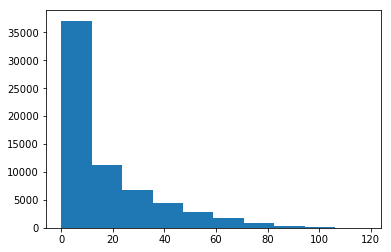

In [565]:
plt.hist(batch_dict[3][:,0])
plt.show()

In [922]:
# 1.147 0.025


# 1,2,3,4,5,6
batch_num = 1
top_n_var = 250

# train_x = batch_dict_134[batch_num]
# train_x = eval('batch_dict_{norm_type}[batch_num]'.format(norm_type=norm_type))
# train_x = batch_dict[batch_num]
cell_idx = cell_dict[batch_num]
cell_type = label_dict[batch_num]
cell_pos = pos_dict[batch_num]
# batch_FE = FE_dict[batch_num]
cell_related_ind = (cell_idx!=0)

num_cells = int(np.max(cell_idx))
# num_cells = 2
train_x = train_x[cell_related_ind,:]

cell_idx = cell_idx[cell_related_ind]
cell_type = cell_type[cell_related_ind]
cell_pos = cell_pos[cell_related_ind]
# batch_FE = batch_FE[cell_related_ind]
# batch_weight = MinMaxScaler((0,1)).fit_transform(batch_FE)
# fun_ind2ij_i = np.vectorize(lambda x:ind2ij(x,256,0))
# fun_ind2ij_j = np.vectorize(lambda x:ind2ij(x,256,1))
# cell_i = fun_ind2ij_i(cell_pos)[:,None]
# cell_j = fun_ind2ij_j(cell_pos)[:,None]

# cell_ij = np.hstack([cell_i,cell_j])
# dist_mat = euclidean_distances(cell_ij)



# num_features_space = dist_mat.shape[0]
# num_features_SIMS = num_features

# cell_center_dist = np.zeros(shape=cell_idx.shape)
# cell_center_dist_exppercell = np.zeros(shape=cell_idx.shape)

# for i in range(num_cells):
#     cur_cell_idx = i + 1
#     cur_cell_ij = cell_ij[cell_idx==cur_cell_idx,:]
#     cur_cell_center = np.mean(cur_cell_ij,axis=0)
#     cur_cell_dist = np.sqrt(np.sum(np.square(cur_cell_ij-cur_cell_center),axis=1))
#     cur_cell_dist_exp = np.exp(-(cur_cell_dist/np.mean(cur_cell_dist)))
#     cell_center_dist[cell_idx==cur_cell_idx] = cur_cell_dist
#     cell_center_dist_exppercell[cell_idx==cur_cell_idx] = cur_cell_dist_exp
# cell_center_dist_exp = np.exp(-(cell_center_dist/np.mean(cell_center_dist)))

# graph_mat = get_graph_mat(cell_idx)
# graph_mat_4 = get_graph_mat_1(cell_pos,4)
# graph_mat_8 = get_graph_mat_1(cell_pos,8)

# train_x = StandardScaler().fit_transform(train_x)
# train_x = MinMaxScaler().fit_transform(train_x)
# train_x = RobustScaler().fit_transform(train_x)

# # 134在每个batch中的index
# index_134 = [93,93,93,93,93,93]
# index_134 = index_134-2



#batch1的一些特殊物质
# zhi = np.array([203,205,206,216,217,219,270,271,272,273])
# zhi = zhi-2
# train_x = train_x[:,zhi]





var_li = []
normed_var_li = []
for i in range(train_x.shape[1]):
    cur_col = train_x[:,i]
#     cur_col= cur_row/np.sum(cur_col)
#     cur_entropy = entropy(cur_col)
    cur_var = np.var(cur_col)
    cur_normed_var = cur_var/np.mean(cur_col)
#     entropy_li.append(cur_entropy)
    var_li.append(cur_var)
    normed_var_li.append(cur_normed_var)
# entropy_li = np.array(entropy_li)
var_li = np.array(var_li)
normed_var_li = np.array(normed_var_li)
sort_ind = np.flip(np.argsort(normed_var_li),axis=0)
sort_val = np.flip(np.sort(normed_var_li),axis=0)
plt.plot(sort_val)
plt.show()

# train_x = Normalizer().fit_transform(train_x)
train_x = train_x[:,sort_ind[0:top_n_var]]
train_x = StandardScaler().fit_transform(train_x)



KeyError: 1

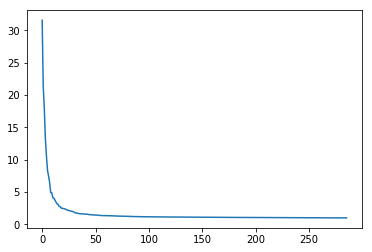

In [148]:
# 有label情况的处理

# 1.147 0.025
batch_num_list = [1]
# 5不行
# 1,2,3,4,5,6
# batch_num = 4
top_n_var = 250
train_x_all = None
cell_idx_all = None
cell_type_all = None
cell_pos_all = None
batch_idx_all = None
num_cells_all = 0


for batch_num in batch_num_list:
    train_x = batch_dict[batch_num]
    # train_x = eval('batch_dict_{norm_type}[batch_num]'.format(norm_type=norm_type))
    # train_x = batch_dict[batch_num]
    cell_idx = cell_dict[batch_num]
    cell_type = label_dict[batch_num]
    cell_pos = pos_dict[batch_num]
    # batch_FE = FE_dict[batch_num]
    cell_related_ind = (cell_idx!=0)

    num_cells = int(np.max(cell_idx))
    # num_cells = 2
    train_x = train_x[cell_related_ind,:]

    cell_idx = cell_idx[cell_related_ind]
    cell_type = cell_type[cell_related_ind]
    # cell_type = np.ones(shape=cell_idx.shape)
    cell_pos = cell_pos[cell_related_ind]





    var_li = []
    normed_var_li = []
    for i in range(train_x.shape[1]):
        cur_col = train_x[:,i]
    #     cur_col= cur_row/np.sum(cur_col)
    #     cur_entropy = entropy(cur_col)
        cur_var = np.var(cur_col)
        cur_normed_var = cur_var/np.mean(cur_col)
    #     entropy_li.append(cur_entropy)
        var_li.append(cur_var)
        normed_var_li.append(cur_normed_var)
    # entropy_li = np.array(entropy_li)
    var_li = np.array(var_li)
    normed_var_li = np.array(normed_var_li)
    sort_ind = np.flip(np.argsort(normed_var_li),axis=0)
    sort_val = np.flip(np.sort(normed_var_li),axis=0)
    plt.plot(sort_val)
    plt.show()


    train_x = train_x/np.percentile(train_x,80,axis=1,keepdims=True)
    train_x = np.log(train_x+1)
    
    
    if train_x_all is None:
        train_x_all = train_x
    else:
        train_x_all = np.vstack([train_x_all,train_x])
    if cell_idx_all is None:
        cell_idx_all = cell_idx
    else:
        cell_idx_all = np.hstack([cell_idx_all,cell_idx+np.max(cell_idx_all)])
    if cell_type_all is None:
        cell_type_all = cell_type
    else:
        cell_type_all = np.hstack([cell_type_all,cell_type])
    if cell_pos_all is None:
        cell_pos_all = cell_pos
    else:
        cell_pos_all = np.hstack([cell_pos_all,cell_pos])
    if batch_idx_all is None:
        batch_idx_all = batch_num*np.ones(shape=(cell_idx.shape))
    else:
        batch_idx_all = np.hstack([batch_idx_all,batch_num*np.ones(shape=(cell_idx.shape))])
    

train_x = train_x_all
cell_idx = cell_idx_all
cell_type = cell_type_all
cell_pos = cell_pos_all
batch_idx = batch_idx_all
num_cells = np.max(cell_idx)
train_x = StandardScaler().fit_transform(train_x)


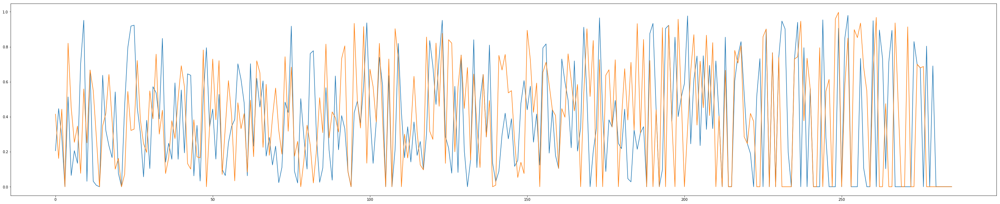

In [232]:
fig = plt.figure(figsize=(50,10))
plt.plot(train_x[1,:])
plt.plot(train_x[2,:])
plt.show()

In [149]:
cell_type

array([ 1.,  1.,  1., ...,  1.,  1.,  1.])

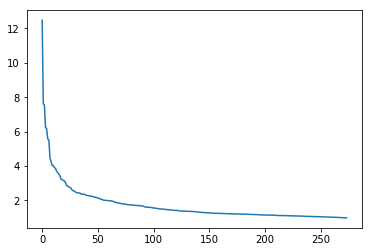

In [44]:
# 无label情况的处理

# 1.147 0.025
batch_num_list = [1]

# 1,2,3,4,5,6
# batch_num = 4
top_n_var = 250
train_x_all = None
cell_idx_all = None
cell_type_all = None
cell_pos_all = None
batch_idx_all = None
num_cells_all = 0


for batch_num in batch_num_list:
    train_x = batch_dict[batch_num]
    # train_x = eval('batch_dict_{norm_type}[batch_num]'.format(norm_type=norm_type))
    # train_x = batch_dict[batch_num]
    cell_idx = cell_dict[batch_num]
#     cell_type = label_dict[batch_num]
    cell_pos = pos_dict[batch_num]
    # batch_FE = FE_dict[batch_num]
    cell_related_ind = (cell_idx!=0)

    num_cells = int(np.max(cell_idx))
    # num_cells = 2
    train_x = train_x[cell_related_ind,:]

    cell_idx = cell_idx[cell_related_ind]
#     cell_type = cell_type[cell_related_ind]
    cell_type = np.ones(shape=cell_idx.shape)
    cell_pos = cell_pos[cell_related_ind]





    var_li = []
    normed_var_li = []
    for i in range(train_x.shape[1]):
        cur_col = train_x[:,i]
    #     cur_col= cur_row/np.sum(cur_col)
    #     cur_entropy = entropy(cur_col)
        cur_var = np.var(cur_col)
        cur_normed_var = cur_var/np.mean(cur_col)
    #     entropy_li.append(cur_entropy)
        var_li.append(cur_var)
        normed_var_li.append(cur_normed_var)
    # entropy_li = np.array(entropy_li)
    var_li = np.array(var_li)
    normed_var_li = np.array(normed_var_li)
    sort_ind = np.flip(np.argsort(normed_var_li),axis=0)
    sort_val = np.flip(np.sort(normed_var_li),axis=0)
    plt.plot(sort_val)
    plt.show()


    train_x = train_x/np.percentile(train_x,80,axis=1,keepdims=True)
    train_x = np.log(train_x+1)
    
    
    if train_x_all is None:
        train_x_all = train_x
    else:
        train_x_all = np.vstack([train_x_all,train_x])
    if cell_idx_all is None:
        cell_idx_all = cell_idx
    else:
        cell_idx_all = np.hstack([cell_idx_all,cell_idx+np.max(cell_idx_all)])
    
    if cell_pos_all is None:
        cell_pos_all = cell_pos
    else:
        cell_pos_all = np.hstack([cell_pos_all,cell_pos])
    if batch_idx_all is None:
        batch_idx_all = batch_num*np.ones(shape=(cell_idx.shape))
    else:
        batch_idx_all = np.hstack([batch_idx_all,batch_num*np.ones(shape=(cell_idx.shape))])
    

train_x = train_x_all
cell_idx = cell_idx_all

cell_pos = cell_pos_all
batch_idx = batch_idx_all
num_cells = np.max(cell_idx)


In [188]:
batch_dict[1].shape

(65536, 286)

In [6]:
batch_num = 1
column_data = np.transpose(batch_dict[batch_num][cell_related_ind,:])+1

class Stricted_Positive(Constraint):
    """Constrains the weights to be non-negative.
    """

    def __call__(self, w):
        w *= K.cast(K.greater_equal(w, K.epsilon()), K.floatx())
        return w

def scale_data(args):
    column_data,scale_weight = args
    scale_weight = scale_weight[:,:,0]
#     scale_weight = scale_weight + K.epsilon()
#     scale_weight = scale_weight + K.epsilon()

#     scale_weight = K.l2_normalize(scale_weight)
    scaled_data = column_data*scale_weight
#     scaled_data = K.exp(scaled_data)
#     scaled_data = K.log(1+scaled_data)
# 
#     scaled_data = scaled_data/(K.std(scaled_data)+K.epsilon())
#     不能用softmax，因为会exp
#     scaled_data = K.softmax(scaled_data)
#     scaled_data = scaled_data/(K.sum(scaled_data,axis=-1,keepdims=True)+K.epsilon())
    print('scaled_data',scaled_data.shape)
    return scaled_data
def l0_reg(weight):
    aa=tf.cast(tf.less_equal(weight, K.epsilon()), tf.float32)
    res = K.sum(aa,axis=1)
    print('rss',res.shape)
    return res
def l1_reg(weight):
    print('weight',weight.shape)
    l1_pen = K.sum(abs(weight),axis=-1)
    print('l1_pen',l1_pen.shape)
    return -l1_pen
def scale_data2(args):
    column_data,scale_para = args
#     print('scale_weight..',scale_weight.shape)

    scale_weight = scale_para[:,:,0]
    print('scale_weight',scale_weight.shape)

    scale_bias = scale_para[:,:,1]
    print('scale_bias',scale_bias.shape)

    scaled_data = column_data*scale_weight-scale_bias
    scaled_data = K.relu(scaled_data)
#     不能用softmax，因为会exp
#     scaled_data = K.softmax(scaled_data)
#     scaled_data = scaled_data/np.sum(scaled_data,axis=-1)
    print('scaled_data',scaled_data.shape)
    return scaled_data

def entropy_loss(args):
    scaled_data = args
#     scaled_data = K.softmax(scaled_data)
    print('scaled_data',scaled_data.shape)
    scaled_data = scaled_data + K.epsilon()
    
    scaled_data = scaled_data/(K.sum(scaled_data,axis=-1,keepdims=True))
    print('scaled_data',scaled_data.shape)
    logit = K.log(scaled_data)*scaled_data
    print('logit',logit.shape)
    rst = -K.sum(logit,axis=-1,keepdims=True)
    print('rst',rst.shape)
#     k = K.constant(8.7188270592425638-0)
    
    
    
#     activate_rst = K.maximum(-1/K.square(k)*K.square(rst)+1,K.constant(0))
    activate_rst = -K.pow(rst,3)
#     return activate_rst
    return activate_rst

#完全错误
# def entropy_loss(y_true,y_pred):
# #     y_pred_sum = K.sum(y_pred,axis=-1,keepdims=True)
# #     y_pred = y_pred/y_pred_sum
#     print('y_pred',y_pred.shape)
# #     print('aa',0.1*y_pred.shape[1].value)
# #     print('y_pred_sum',y_pred_sum.shape)
#     logit = K.log(y_pred+K.epsilon())*y_pred
# #     优化负熵
#     rst = -K.sum(logit,axis=-1,keepdims=True)
#     print('logit',logit.shape)
#     print('rst',rst.shape)
#     return rst
def binary_crossentropy_loss(y_true,y_pred):
    
    con_tensor = K.ones(shape=(1,y_pred.shape[1]))
    con_tensor = con_tensor/K.sum(con_tensor)
    print('con_tensor',con_tensor.shape)
    print('y_pred',y_pred.shape)
    rst = K.binary_crossentropy(con_tensor,y_pred)
    return rst
def entropy_loss_gaussian(y_true,y_pred):
    data_var = K.var(y_pred)
    return K.log(data_var)


def entropy_loss_mask(y_true,y_pred):
#     去掉top10%和bottom10%
    mask_num = 50
#     mask_num = y_pred.shape[1]*mask_ratio
    y_pred=tf.nn.top_k(y_pred,y_pred.shape[1]-mask_num).values
    y_pred=-tf.nn.top_k(-y_pred,y_pred.shape[1]-mask_num).values
#     print(y_pred.values)
    y_pred_sum = K.sum(y_pred,axis=-1,keepdims=True)
    y_pred = y_pred/y_pred_sum
    print('y_pred',y_pred.shape)
    print('y_pred_sum',y_pred_sum.shape)
    logit = K.log(y_pred+K.epsilon())*y_pred
#     优化负熵
    rst = K.sum(logit,axis=-1,keepdims=True)
    print('logit',logit.shape)
    print('rst',rst.shape)
    return rst

def Kurtosis_loss(y_true,y_pred):
    
    mean = K.mean(y_pred,axis=-1,keepdims=True)
    fenzi = K.mean(K.pow(y_pred-mean,4),axis=-1,keepdims=True)
    fenmu = K.pow(K.mean(K.pow(y_pred-mean,2),axis=-1,keepdims=True),2)
    rst = fenzi/(fenmu+K.epsilon())-3
    print('rst',rst.shape)
    return rst
    
def VMR_loss(y_true,y_pred):
    variance=K.var(y_pred, axis=-1, keepdims=True)
    mean = K.mean(y_pred,axis=-1,keepdims=True)
    VMR = variance/(mean+K.epsilon())
    print(VMR.shape)
    return VMR
#     pixel_embed = pixel_embed[:,None]
#     pixel_embed = K.l2_normalize(pixel_embed,axis=-1)
    
column_input = Input(shape=(column_data.shape[1],))
dummy_input = Input(shape=(column_data.shape[1],))
embed_layer = Embedding(column_data.shape[1],1,input_length=column_data.shape[1],embeddings_initializer=Ones(),embeddings_constraint=non_neg())(dummy_input)
scaled_layer = Lambda(scale_data,name='scale_data')([column_input,embed_layer])
# scaled_out = Activation('softmax')(scaled_layer)
loss_layer = Lambda(entropy_loss,name='entropy_loss')(scaled_layer)
# l0_layer = Lambda(l0_reg,name='l0')(embed_layer)
# embed_layer = Embedding(column_data.shape[1],2,input_length=column_data.shape[1],embeddings_initializer=keras.initializers.Ones(),embeddings_constraint=non_neg())(dummy_input)
# embed_layer2 = Embedding(column_data.shape[1],2,input_length=column_data.shape[1],embeddings_initializer=keras.initializers.Ones(),embeddings_constraint=non_neg())(dummy_input)

# scaled_out1 = Lambda(scale_data2)([column_input,embed_layer])
# scaled_out = Lambda(scale_data2)([scaled_out1,embed_layer2])

# model = Model([column_input,dummy_input],[scaled_out,l0_layer])
# model.compile(optimizer='adam',loss=[VMR_loss,lambda y_true,y_pred:y_pred],loss_weights=[1,0],metrics=[Kurtosis_loss])
# history=model.fit([column_data,np.tile(np.arange(column_data.shape[1]),(column_data.shape[0],1))],[np.ones(shape=column_data.shape),np.ones(shape=(column_data.shape[0],1))],epochs=500,shuffle=True,batch_size=32)
# pred_rst=model.predict([column_data,np.tile(np.arange(column_data.shape[1]),(column_data.shape[0],1))])[0]
# train_x = np.transpose(pred_rst)
# train_x = np.log2(train_x+1)
model = Model([column_input,dummy_input],loss_layer)
model.compile(optimizer='adam',loss=lambda y_true,y_pred:y_pred)
# history = model.fit([column_data,np.tile(np.arange(column_data.shape[1]),(column_data.shape[0],1))],np.ones(shape=column_data.shape)/column_data.shape[1],epochs=1000,shuffle=True,batch_size=274)
history = model.fit([column_data,np.tile(np.arange(column_data.shape[1]),(column_data.shape[0],1))],np.ones(shape=(column_data.shape[0],1)),epochs=500,shuffle=True,batch_size=286)


NameError: name 'Constraint' is not defined

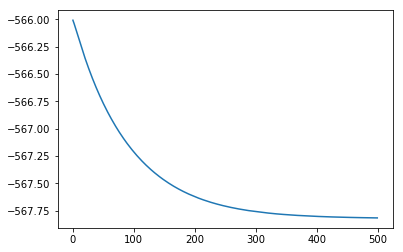

In [1493]:
plt.plot(history.history['loss'])
plt.show()

In [1494]:
scaled_model = Model([column_input,dummy_input],scaled_layer)
processed_data = scaled_model.predict([column_data,np.tile(np.arange(column_data.shape[1]),(column_data.shape[0],1))])
normed_data = column_data/np.sum(column_data,axis=0)
normed_data2 = column_data/column_data[0,:]
normed_data3 = column_data/np.percentile(column_data,80,axis=0,keepdims=True)

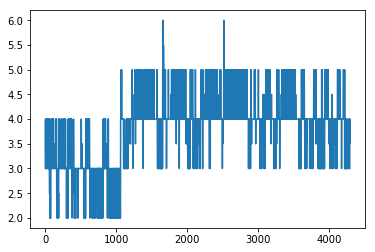

array([ 3.,  4.,  3., ...,  4.,  4.,  3.])

In [1472]:
a=np.median(column_data,axis=0)
plt.plot(np.median(column_data,axis=0,keepdims=False))
plt.show()
np.percentile(column_data,50,axis=0,keepdims=False)

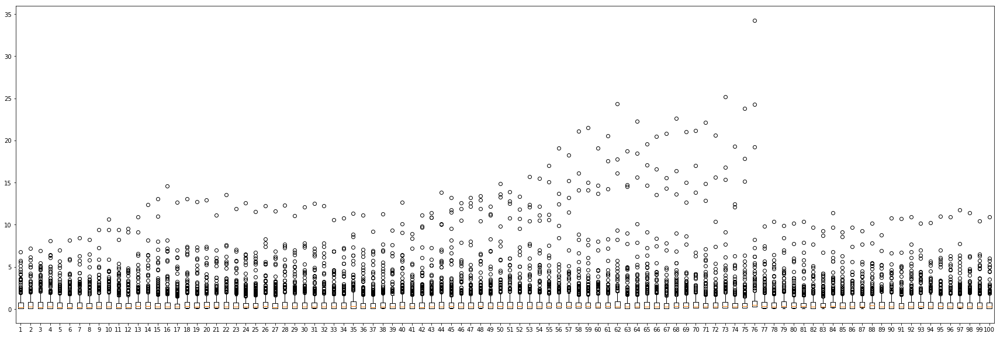

In [1473]:
plt.figure(figsize=(30,10))
plt.boxplot(normed_data3[:,0:100])
plt.show()

In [1474]:
normed_data3.shape

(286, 4287)

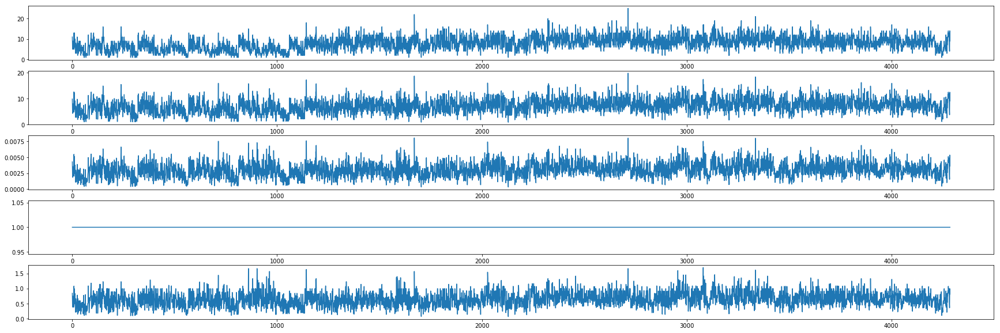

original_data 8.2726794439
processed_data 8.2889
normed_data 8.29016144369
normed_data2 8.3633424666
normed_data3 8.29232358405


In [1495]:
from scipy.stats import *
i=0


# processed_data[:,1109]=0
# processed_data[:,1788]=0

plt.figure(figsize=(30,10))
plt.subplot(5,1,1)
plt.plot(column_data[i,:])
# plt.hist(column_data[i,:])
plt.subplot(5,1,2)
plt.plot(processed_data[i,:])
# plt.hist(processed_data[i,:])

plt.subplot(5,1,3)
plt.plot(normed_data[i,:])
# plt.hist(normed_data[i,:])
plt.subplot(5,1,4)
plt.plot(normed_data2[i,:])
plt.subplot(5,1,5)
plt.plot(normed_data3[i,:])

plt.show()
print('original_data',entropy(column_data[i,:],))
print('processed_data',entropy(processed_data[i,:]))
print('normed_data',entropy(normed_data[i,:]))
print('normed_data2',entropy(normed_data2[i,:]))
print('normed_data3',entropy(normed_data3[i,:]))

In [1496]:
entropy_li_processed = np.zeros(shape=(274,))
entropy_li_original = np.zeros(shape=(274,))
entropy_li_normed = np.zeros(shape=(274,))
entropy_li_normed2 = np.zeros(shape=(274,))
entropy_li_normed3 = np.zeros(shape=(274,))


for i in range(274):
    entropy_li_processed[i] = entropy(processed_data[i,:])
    entropy_li_original[i] = entropy(column_data[i,:])
    entropy_li_normed[i] = entropy(normed_data[i,:])
    entropy_li_normed2[i] = entropy(normed_data2[i,:])
    entropy_li_normed3[i] = entropy(normed_data3[i,:])
    
    

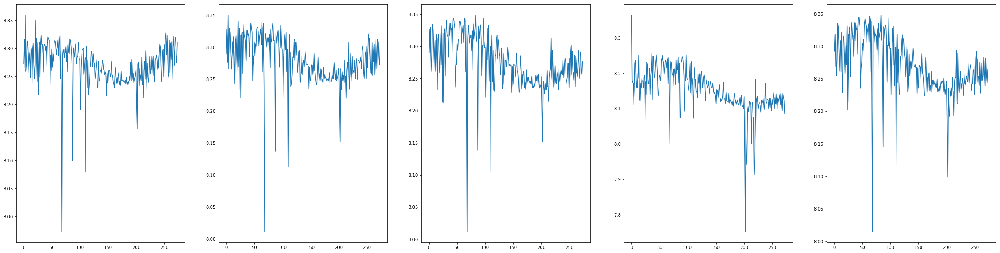

original_data 2265.96169032
processed_data 2268.55836868
normed_data 2267.39283052
normed_data2 2233.234999
normed_data3 2266.11389924


In [1497]:
#2367.18
plt.figure(figsize=(40,10))
plt.subplot(1,5,1)
plt.plot(entropy_li_original)
plt.subplot(1,5,2)
plt.plot(entropy_li_processed)
plt.subplot(1,5,3)
plt.plot(entropy_li_normed)
plt.subplot(1,5,4)
plt.plot(entropy_li_normed2)
plt.subplot(1,5,5)
plt.plot(entropy_li_normed3)
plt.show()
print('original_data',np.sum(entropy_li_original))
print('processed_data',np.sum(entropy_li_processed))
print('normed_data',np.sum(entropy_li_normed))
print('normed_data2',np.sum(entropy_li_normed2))
print('normed_data3',np.sum(entropy_li_normed3))

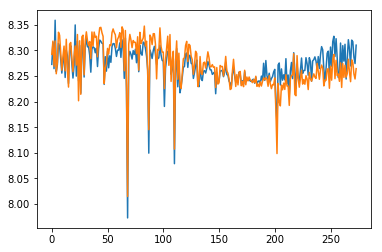

In [1502]:
plt.plot(entropy_li_original)
plt.plot(entropy_li_normed3)
plt.show()

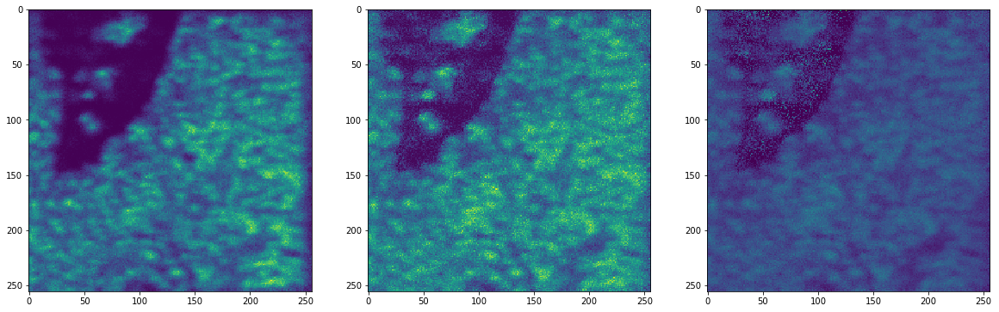

In [1483]:
original_img = batch_dict[batch_num][:,91][np.argsort(pos_dict[batch_num])].reshape((256,256))
normed_img = (batch_dict[batch_num]+1)/(np.percentile(batch_dict[batch_num],60,axis=1,keepdims=True)+1)
normed_img2 = (batch_dict[batch_num])/(np.sum(batch_dict[batch_num],axis=1,keepdims=True))
normed_img = normed_img[:,91][np.argsort(pos_dict[batch_num])].reshape((256,256))
normed_img2 = normed_img2[:,91][np.argsort(pos_dict[batch_num])].reshape((256,256))

plt.figure(figsize=(20,10))
plt.subplot(1,3,1)
plt.imshow(original_img)
plt.subplot(1,3,2)
plt.imshow(normed_img)
plt.subplot(1,3,3)
plt.imshow(normed_img2)
plt.show()

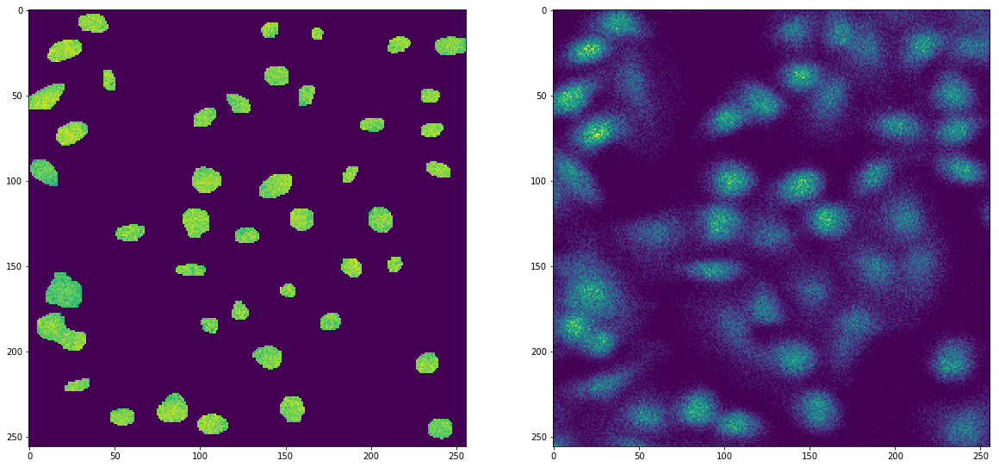

In [206]:
i=0
plt.figure(figsize=(20,20))
plt.subplot(1,2,1)
original_mat = np.zeros(shape=batch_dict[batch_num].shape)
original_mat[cell_related_ind,:] = train_x
plt.imshow(original_mat[:,i][np.argsort(pos_dict[batch_num])].reshape((256,256)))
plt.subplot(1,2,2)
# processed_mat = np.zeros(shape=batch_dict[batch_num].shape)
# processed_mat[cell_related_ind,:] = train_x
# plt.imshow(processed_mat[:,i][np.argsort(pos_dict[batch_num])].reshape((256,256)))
plt.imshow(batch_dict[batch_num][:,10][np.argsort(pos_dict[batch_num])].reshape((256,256)))

plt.show()

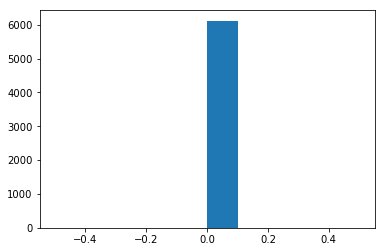

In [1186]:
plt.hist(processed_data[50,:])
plt.show()

In [1189]:
processed_data[50,:]*6117

array([ 1.,  1.,  1., ...,  1.,  1.,  1.], dtype=float32)

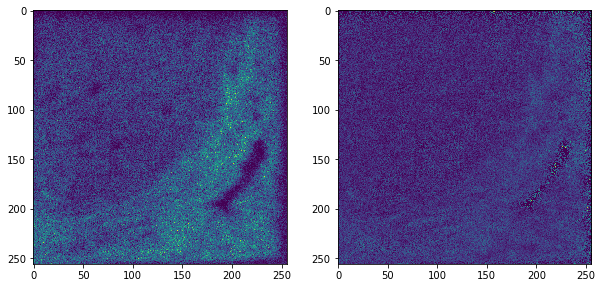

In [957]:
original_data = batch_dict[batch_num][:,10]
original_labeling = original_data[np.argsort(pos_dict[batch_num])]
original_img = original_labeling.reshape((256,256))

processed_data = np.log2(batch_dict[batch_num]/np.sum(batch_dict[batch_num],axis=1,keepdims=True)+1)[:,10]
processed_labeling = processed_data[np.argsort(pos_dict[batch_num])]
processed_img = processed_labeling.reshape((256,256))
fig=plt.figure(figsize=(10,10))
plt.subplot(1,2,1)
plt.imshow(original_img)

plt.subplot(1,2,2)
plt.imshow(processed_img)
plt.show()

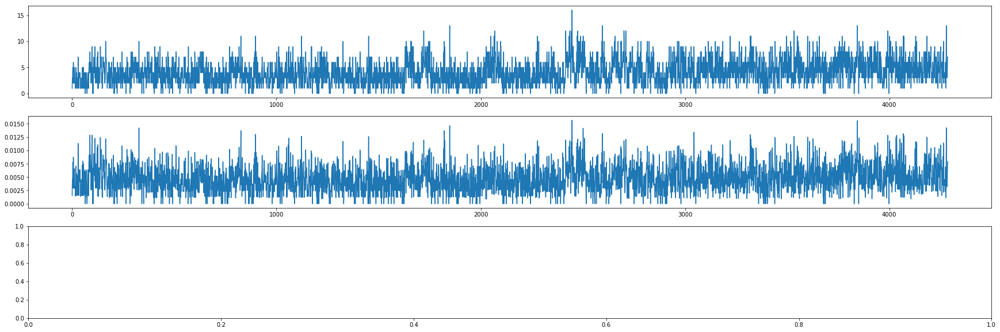

In [958]:
plt.figure(figsize=(30,10))
plt.subplot(3,1,1)
plt.plot(original_data[cell_related_ind])
plt.subplot(3,1,2)
plt.plot(processed_data[cell_related_ind])
plt.subplot(3,1,3)
# plt.plot(pred_rst[10,:])

plt.show()

In [6]:
len(batch_dict)

1

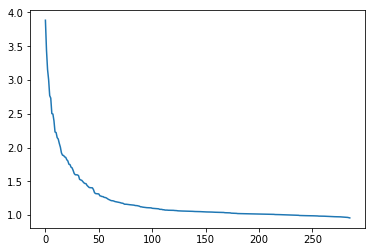

In [17]:
# 有label情况的处理

# 1.147 0.025
batch_num_list = [3]
# 5不行
# 1,2,3,4,5,6
# batch_num = 4
top_n_var = 250
train_x_all = None
cell_idx_all = None
cell_type_all = None
cell_pos_all = None
batch_idx_all = None
num_cells_all = 0


for batch_num in batch_num_list:
    train_x = batch_dict[batch_num]
    # train_x = eval('batch_dict_{norm_type}[batch_num]'.format(norm_type=norm_type))
    # train_x = batch_dict[batch_num]
    cell_idx = cell_dict[batch_num]
    cell_type = label_dict[batch_num]
    cell_pos = pos_dict[batch_num]
    # batch_FE = FE_dict[batch_num]
    cell_related_ind = (cell_idx!=0)

    num_cells = int(np.max(cell_idx))
    # num_cells = 2
    train_x = train_x[cell_related_ind,:]

    cell_idx = cell_idx[cell_related_ind]
    cell_type = cell_type[cell_related_ind]
    # cell_type = np.ones(shape=cell_idx.shape)
    cell_pos = cell_pos[cell_related_ind]





    var_li = []
    normed_var_li = []
    for i in range(train_x.shape[1]):
        cur_col = train_x[:,i]
    #     cur_col= cur_row/np.sum(cur_col)
    #     cur_entropy = entropy(cur_col)
        cur_var = np.var(cur_col)
        cur_normed_var = cur_var/np.mean(cur_col)
    #     entropy_li.append(cur_entropy)
        var_li.append(cur_var)
        normed_var_li.append(cur_normed_var)
    # entropy_li = np.array(entropy_li)
    var_li = np.array(var_li)
    normed_var_li = np.array(normed_var_li)
    sort_ind = np.flip(np.argsort(normed_var_li),axis=0)
    sort_val = np.flip(np.sort(normed_var_li),axis=0)
    plt.plot(sort_val)
    plt.show()


    train_x = train_x/np.percentile(train_x,50,axis=1,keepdims=True)
    train_x = np.log(train_x+1)
    
    
    if train_x_all is None:
        train_x_all = train_x
    else:
        train_x_all = np.vstack([train_x_all,train_x])
    if cell_idx_all is None:
        cell_idx_all = cell_idx
    else:
        cell_idx_all = np.hstack([cell_idx_all,cell_idx+np.max(cell_idx_all)])
    if cell_type_all is None:
        cell_type_all = cell_type
    else:
        cell_type_all = np.hstack([cell_type_all,cell_type])
    if cell_pos_all is None:
        cell_pos_all = cell_pos
    else:
        cell_pos_all = np.hstack([cell_pos_all,cell_pos])
    if batch_idx_all is None:
        batch_idx_all = batch_num*np.ones(shape=(cell_idx.shape))
    else:
        batch_idx_all = np.hstack([batch_idx_all,batch_num*np.ones(shape=(cell_idx.shape))])
    

train_x = train_x_all
cell_idx = cell_idx_all
cell_type = cell_type_all
cell_pos = cell_pos_all
batch_idx = batch_idx_all
num_cells = np.max(cell_idx)
train_x = StandardScaler().fit_transform(train_x)


In [18]:
import keras
from keras.constraints import *
from keras.regularizers import *
from keras.layers import *

from keras.initializers import *
activa = 'relu'
dp_rate = 0.5
low_dim = 32
l2_penalty = 0
l1_penalty = 1e-5
def modi_softmax(args):
    t =1
    pixel_embed,nuclei_embed = args
    
    
    
    pixel_embed = pixel_embed[:,None]
#     pixel_embed = K.l2_normalize(pixel_embed,axis=-1)
#     nuclei_embed = K.l2_normalize(nuclei_embed,axis=-1)
    
    print('pixel_embed',pixel_embed.shape)
    print('nuclei_embed',nuclei_embed.shape)
    minus_square = (pixel_embed*nuclei_embed/t)
#     minus_square = K.square(pixel_embed-nuclei_embed)
    print('minus_square',minus_square.shape)
    
#     sum_minus_square = -K.sum(minus_square,axis=-1)/t
    sum_minus_square = K.sum(minus_square,axis=-1)
    norm_exp = K.softmax(sum_minus_square)
    return norm_exp
    
    print('norm_exp',norm_exp)
    
def modi_softeuc(args):
    t = 1
    p = 1
    pixel_embed,nuclei_embed = args
    
    
    
    pixel_embed = pixel_embed[:,None]
#     pixel_embed = K.l2_normalize(pixel_embed,axis=-1)
#     nuclei_embed = K.l2_normalize(nuclei_embed,axis=-1)
    
    print('pixel_embed',pixel_embed.shape)
    print('nuclei_embed',nuclei_embed.shape)
#     minus_square = (pixel_embed*nuclei_embed/t)
    minus_square = K.square(pixel_embed-nuclei_embed)
#     minus_square = K.abs(pixel_embed-nuclei_embed)

    print('minus_square',minus_square.shape)
    
#     sum_minus_square = -K.sqrt(K.sum(minus_square,axis=-1))/t
    sum_minus_square = -K.pow(K.sum(minus_square,axis=-1)/t,p)

#     sum_minus_square = K.sum(minus_square,axis=-1)
    norm_exp = K.softmax(sum_minus_square)
    return norm_exp
    
    print('norm_exp',norm_exp)
def cal_kld(nuclei_embed):
#     计算nuclei embed的arccos矩阵和均匀分布的kl散度
#     也就是arccos矩阵的熵
    pass

def cal_pl_loss(args):
    nuclei_embed,target,pixel_embed = args
#     target = K.expand_dims(target,axis=1)
#     print('nuclei_embed',nuclei_embed.shape)
#     print('target',target.shape)
    target = K.expand_dims(target,axis=1)
#     print('pixel_embed',pixel_embed.shape)
    print('nuclei_embed',nuclei_embed.shape)
    print('target',target.shape)
    aaa = K.batch_dot(target,nuclei_embed)
    print('aaa1',aaa.shape)
#     aaa = K.squeeze(aaa,2)
#     pixel_embed = K.squeeze(pixel_embed,1)
#     aaa = K.squeeze(aaa,1)
    pixel_embed = K.expand_dims(pixel_embed,axis=1)
    print('aaa',aaa.shape)
    print('pixel_embed',pixel_embed.shape)
    rst = K.sum(K.square(aaa-pixel_embed),axis=-1,keepdims=False)
    return rst
    
    
####################MLP################################################################################
SIMS_input = Input(shape=(train_x.shape[1],))
target_input = Input(shape=(1,))

d1 = Dense(128,activation=activa,kernel_initializer=glorot_normal(),kernel_regularizer=l2(l2_penalty))(SIMS_input)
# d1 = Dense(1024,activation=activa,kernel_initializer='random_uniform')(SIMS_input)
# d1 = Dense(1024,activation=activa,kernel_initializer='random_uniform')(d1)


d2 = Dense(64,activation=activa,kernel_initializer=glorot_normal(),kernel_regularizer=l2(l2_penalty))(d1)
# d2 = Dense(512,activation=activa,kernel_initializer='random_uniform')(d1)
# d2 = Dense(512,activation=activa,kernel_initializer='random_uniform')(d2)
d2 = Dense(low_dim,activation='linear',kernel_initializer='random_uniform')(d2)


# d3 = Dense(64,activation=activa,kernel_initializer=glorot_normal(),kernel_regularizer=l2(l2_penalty))(d2)
# d3 = Dense(256,activation=activa,kernel_initializer='random_uniform')(d2)
# d3 = Dense(256,activation=activa,kernel_initializer='random_uniform')(d3)


# d4 = Dense(low_dim,activation=activa,kernel_initializer=glorot_normal(),kernel_regularizer=l2(l2_penalty))(d3)
d4 = Dense(num_cells,activation='linear',kernel_initializer=glorot_normal(),kernel_regularizer=l2(l2_penalty))(d2)
####################MLP################################################################################
centerloss_embed_layer = Embedding(num_cells, low_dim)(target_input)
centerloss_out = Lambda(lambda x: K.sum(K.square(x[0]-x[1][:,0]), 1, keepdims=True), name='center')([d2,centerloss_embed_layer])



softmax_out = Activation('softmax',name='softmax')(d4)

softmax_model = Model([SIMS_input,target_input],[softmax_out,centerloss_out])
softmax_model.compile(optimizer=adam(),loss=['categorical_crossentropy',lambda y_true,y_pred:y_pred],loss_weights=[1,0])
onehot_label = keras.utils.to_categorical(cell_idx-1,num_cells)
history=softmax_model.fit([train_x,cell_idx-1],[onehot_label,np.ones(shape=cell_idx.shape)],epochs=200,shuffle=True,batch_size=128)




# dummy_input = Input(shape=(num_cells,))
# target_input = Input(shape=(num_cells,))
# # embed_layer = Embedding(num_cells,2,input_length=num_cells,embeddings_initializer='random_uniform',embeddings_constraint=keras.constraints.min_max_norm(min_value=1, max_value=10, rate=1.0, axis=0))(dummy_input)
# embed_layer = Embedding(num_cells,low_dim,input_length=num_cells,embeddings_initializer='random_uniform')(dummy_input)

# # softmax_out = Lambda(modi_softmax)([d4,embed_layer])
# softmax_out = Lambda(modi_softmax,name='modified_softmax')([d4,embed_layer])

# centerloss_embed_layer = Embedding(num_cells, low_dim)(target_input)
# centerloss_out = Lambda(lambda x: K.sum(K.square(x[0]-x[1][:,0]), 1, keepdims=True), name='center_loss')([d4,centerloss_embed_layer])

# pl_loss_out = Lambda(cal_pl_loss,name='pl_loss')([embed_layer,target_input,d4])


# # softmax_out = Dense(num_cells,activation = 'softmax',kernel_initializer='random_uniform',kernel_constraint=unit_norm(),use_bias=False)(d4)
# # softmax_out = Dense(num_cells,activation = 'softmax',kernel_initializer='random_uniform')(d4)

# # d4 = Lambda(lambda  x: K.l2_normalize(x,axis=1))(d4)
# # softmax_out = Dense(num_cells,activation = 'softmax',kernel_initializer='random_uniform')(d4)


# #下面是euclidean based softmax



# classification_model_singlegpu = Model(inputs=[SIMS_input,dummy_input,target_input],outputs=[softmax_out,pl_loss_out])
# # classification_model = multi_gpu_model(classification_model_singlegpu,gpus=2)
# classification_model_singlegpu.compile(optimizer=nadam(),loss=['categorical_crossentropy',lambda y_true,y_pred: y_pred], loss_weights=[1.,0])

# onehot_label = keras.utils.to_categorical(cell_idx-1,num_cells)
# # onehot_label1 = onehot_label[:,None,:]
# print('onehot_label',onehot_label.shape)
# # classification_model.fit(train_x,onehot_label,epochs=200,shuffle=True,batch_size=128,sample_weight=cell_center_dist_exp)
# history=classification_model_singlegpu.fit([train_x,np.tile(np.arange(num_cells),(train_x.shape[0],1)),onehot_label],[onehot_label,np.ones(shape=cell_idx.shape)],epochs=500,shuffle=True,batch_size=128)




Epoch 1/200
4079/4079 [==============================] - 1s 282us/step - loss: 5.0989 - softmax_loss: 5.0989 - center_loss: 1.2332
Epoch 2/200
4079/4079 [==============================] - 0s 47us/step - loss: 4.8695 - softmax_loss: 4.8695 - center_loss: 18.1573
Epoch 3/200
4079/4079 [==============================] - 0s 43us/step - loss: 4.3793 - softmax_loss: 4.3793 - center_loss: 97.5639
Epoch 4/200
4079/4079 [==============================] - 0s 48us/step - loss: 4.0027 - softmax_loss: 4.0027 - center_loss: 203.6579
Epoch 5/200
4079/4079 [==============================] - 0s 40us/step - loss: 3.6655 - softmax_loss: 3.6655 - center_loss: 335.7257
Epoch 6/200
4079/4079 [==============================] - 0s 45us/step - loss: 3.3199 - softmax_loss: 3.3199 - center_loss: 511.6665
Epoch 7/200
4079/4079 [==============================] - 0s 44us/step - loss: 3.0221 - softmax_loss: 3.0221 - center_loss: 714.5039
Epoch 8/200
4079/4079 [==============================] - 0s 45us/step - loss: 2

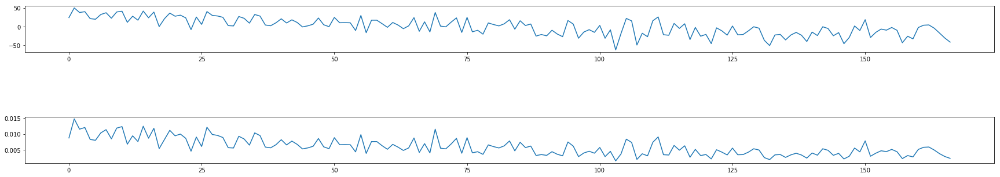

In [19]:
logit_model = Model(SIMS_input,d4)
pred_logit = logit_model.predict(train_x)
# pred_softmax = softmax_model.predict(train_x)
t = 50
pred_t_softmax = np.exp(pred_logit/t)
pred_t_softmax = pred_t_softmax/np.sum(pred_t_softmax,axis=1,keepdims=True)
# pred_t_softmax=np.transpose(softmax_representation_list[3])
i=30
fig = plt.figure(figsize=(30,5))
plt.subplot(3,1,1)
plt.plot(pred_logit[i,:])
# plt.subplot(3,1,2)
# plt.plot(pred_softmax[i,:])
plt.subplot(3,1,3)
plt.plot(pred_t_softmax[i,:])
plt.show()

UMAP(a=None, angular_rp_forest=False, b=None, init='spectral',
   learning_rate=1.0, local_connectivity=1.0, metric='correlation',
   metric_kwds=None, min_dist=0, n_components=2, n_epochs=None,
   n_neighbors=20, negative_sample_rate=5, random_state=None,
   repulsion_strength=1.0, set_op_mix_ratio=1.0, spread=1.0,
   target_metric='categorical', target_metric_kwds=None,
   target_n_neighbors=-1, target_weight=0.5, transform_queue_size=4.0,
   transform_seed=42, verbose=True)
Construct fuzzy simplicial set
Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs


/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:49: DeprecationWarning: using a non-integer array as obj in delete will result in an error in the future
/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:50: DeprecationWarning: using a non-integer array as obj in delete will result in an error in the future


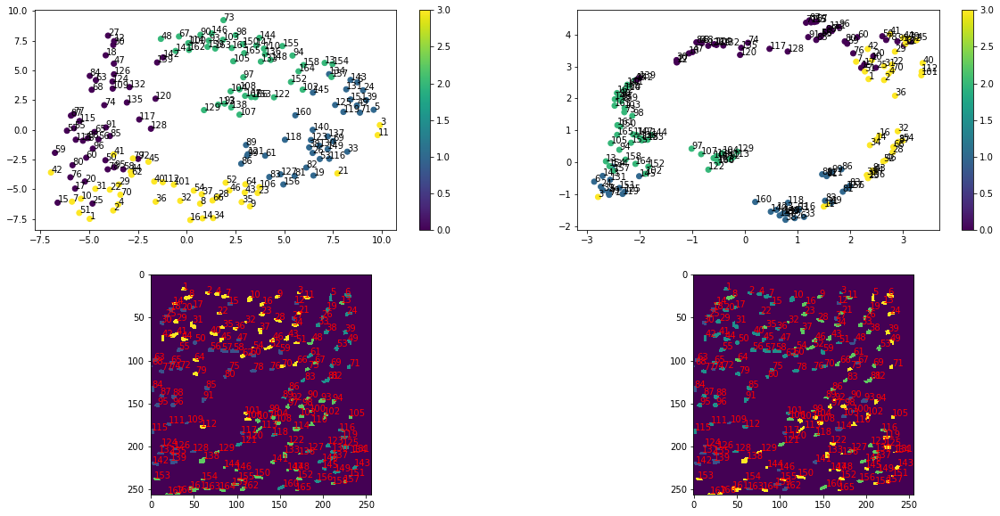

In [30]:
import umap
n_clusters=4



# embed_model = Model(dummy_input,embed_layer)
# embed_mat = embed_model.layers[-1].get_weights()[0]
# graph_embed_model = Model(graph_input,den5)
# embed_mat = graph_embed_model.predict(graph_mat)
# cell_type = np.ones(shape=cell_idx.shape)
# label_dict[1] = np.ones(shape=(65536,))

# dist = 'euclidean'
embed_mat1 = TSNE(n_components=2,metric='correlation',perplexity=30).fit_transform(np.transpose(pred_t_softmax))
# embed_mat = TSNE(n_components=2,metric='precomputed').fit_transform(1-spearman_mat)
embed_mat2 = umap.UMAP(metric='correlation',n_neighbors=20,min_dist=0,verbose=True).fit_transform(np.transpose(pred_t_softmax))
# embed_mat = TSNE(n_components=2).fit_transform(graph_mat)


_,unique_idx = np.unique(cell_idx,return_index=True)
true_y = cell_type[unique_idx]
# true_y[6] = 1
true_batch = batch_idx[unique_idx]
# nuclei_embed_2d = TSNE(n_components=2,verbose=1,metric='euclidean',perplexity=40,method='exact',n_iter=1000).fit_transform(embed_mat)

# embed_mat = embed_mat
pred_y1 = MiniBatchKMeans(n_clusters=n_clusters).fit_predict(embed_mat1)

# pred_y2 = MiniBatchKMeans(n_clusters=n_clusters).fit_predict(embed_mat2)
pred_y2 = SpectralClustering(n_clusters=n_clusters).fit_predict(embed_mat2)
pred_y3 = MiniBatchKMeans(n_clusters=n_clusters).fit_predict(np.transpose(pred_t_softmax))
pred_y4 = label_list[2]
# pred_y = AffinityPropagation().fit_predict(embed_mat)
# pred_y = SpectralClustering(n_clusters=n_clusters).fit_predict(embed_mat)

fig = plt.figure(figsize=(20,10))
plt.subplot(2,2,1)
plt.scatter(embed_mat1[:,0],embed_mat1[:,1],c=pred_y4)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(embed_mat1[i,0],embed_mat1[i,1]))
plt.colorbar(use_gridspec=True)


plt.subplot(2,2,2)
# rare_cells = np.delete(np.arange(num_cells+1),[39,44,47,56])-1
# rare_cells = np.array([39,44,47,56])-1;
rare_cells = np.array([])
embed_mat2_major = np.delete(embed_mat2,rare_cells,axis=0)
pred_y2_major = np.delete(pred_y2,rare_cells)
plt.scatter(embed_mat2_major[:,0],embed_mat2_major[:,1],c=pred_y4)
for i in range(num_cells):
    if i in rare_cells:
        continue
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(embed_mat2[i,0],embed_mat2[i,1]))
plt.colorbar(use_gridspec=True)

    

labeling1 = get_labeling(pred_y4,cell_idx)
img1 = labeling1.reshape((256,256))
labeling2 = get_labeling(pred_y2,cell_idx)
img2 = labeling2.reshape((256,256))
# img = np.transpose(img)
plt.subplot(2,2,3)

plt.imshow(img1)
for i in range(num_cells):
    cur_idx = i + 1
    cur_ind = cell_pos[cell_idx==cur_idx][0]
#     print(ind2ij(cur_ind,256,0))
#     print(ind2ij(cur_ind,256,1))
    
    plt.annotate(str(cur_idx),(ind2ij(cur_ind,256,1),ind2ij(cur_ind,256,0)),color='red')

true_labeling = label_dict[batch_num][np.argsort(pos_dict[batch_num])]-1
true_img = true_labeling.reshape((256,256))
plt.subplot(2,2,4)

plt.imshow(img2)
for i in range(num_cells):
    cur_idx = i + 1
    cur_ind = cell_pos[cell_idx==cur_idx][0]
#     print(ind2ij(cur_ind,256,0))
#     print(ind2ij(cur_ind,256,1))
    
    plt.annotate(str(cur_idx),(ind2ij(cur_ind,256,1),ind2ij(cur_ind,256,0)),color='red')

    
plt.show()

In [11]:
ARI = metrics.adjusted_rand_score(pred_y2, true_y)
ARI

0.23377674437619284

In [5]:
def reset_weights(model):
    session = K.get_session()
#     k=0
    for layer in model.layers: 
#         print(k)
        if hasattr(layer, 'kernel_initializer'):
            layer.kernel.initializer.run(session=session)
#             k+=1

def label2CM(label):
    label_sz = label.shape[0]
    rst = np.zeros(shape=(label_sz,label_sz))
    for i in range(label_sz):
        for j in range(i+1):
            if label[i]==label[j]:
                rst[i,j] = 1
                rst[j,i] = 1
    return rst
            

In [573]:
CM = label2CM(true_y)
CM

array([[ 1.,  0.,  0., ...,  0.,  1.,  1.],
       [ 0.,  1.,  1., ...,  1.,  0.,  0.],
       [ 0.,  1.,  1., ...,  1.,  0.,  0.],
       ..., 
       [ 0.,  1.,  1., ...,  1.,  0.,  0.],
       [ 1.,  0.,  0., ...,  0.,  1.,  1.],
       [ 1.,  0.,  0., ...,  0.,  1.,  1.]])

In [56]:
# consensus clustering
# step 1:首先得到n个softmax空间的表示
n_softmax = 3
t_list = [10,30,50,70,90]

softmax_representation_list = []
logit_model = Model(SIMS_input,d4)

for i in range(n_softmax):
    reset_weights(softmax_model)
    
    history=softmax_model.fit([train_x,cell_idx-1],[onehot_label,np.ones(shape=cell_idx.shape)],epochs=100,shuffle=True,batch_size=128)
    
    for t in t_list:
        print(i)
    #     history=softmax_model.fit([train_x,cur_label],[onehot_label,np.ones(shape=cell_idx.shape)],epochs=50,shuffle=True,batch_size=64,verbose=True)

        pred_logit = logit_model.predict(train_x)
        pred_t_softmax = np.exp(pred_logit/t)
        pred_t_softmax = pred_t_softmax/np.sum(pred_t_softmax,axis=1,keepdims=True)
        softmax_representation_list.append(np.transpose(pred_t_softmax))



0
Epoch 1/100
4079/4079 [==============================] - 0s 48us/step - loss: 5.0962 - softmax_loss: 5.0962 - center_loss: 3.7382
Epoch 2/100
4079/4079 [==============================] - 0s 44us/step - loss: 4.9576 - softmax_loss: 4.9576 - center_loss: 10.4591
Epoch 3/100
4079/4079 [==============================] - 0s 45us/step - loss: 4.4632 - softmax_loss: 4.4632 - center_loss: 92.2511
Epoch 4/100
4079/4079 [==============================] - 0s 45us/step - loss: 3.9705 - softmax_loss: 3.9705 - center_loss: 264.5696
Epoch 5/100
4079/4079 [==============================] - 0s 44us/step - loss: 3.5698 - softmax_loss: 3.5698 - center_loss: 437.6382
Epoch 6/100
4079/4079 [==============================] - 0s 45us/step - loss: 3.2081 - softmax_loss: 3.2081 - center_loss: 617.7491
Epoch 7/100
4079/4079 [==============================] - 0s 45us/step - loss: 2.9104 - softmax_loss: 2.9104 - center_loss: 863.1746
Epoch 8/100
4079/4079 [==============================] - 0s 44us/step - loss: 

In [574]:
softmax_representation_list_bak = softmax_representation_list
softmax_representation_list = softmax_representation_list[0:2]

performing k=2,rep=0,tsne perplexity=10,metric=cosine
performing k=3,rep=0,tsne perplexity=10,metric=cosine
performing k=4,rep=0,tsne perplexity=10,metric=cosine
performing k=5,rep=0,tsne perplexity=10,metric=cosine
performing k=6,rep=0,tsne perplexity=10,metric=cosine
performing k=2,rep=0,tsne perplexity=10,metric=euclidean
performing k=3,rep=0,tsne perplexity=10,metric=euclidean
performing k=4,rep=0,tsne perplexity=10,metric=euclidean
performing k=5,rep=0,tsne perplexity=10,metric=euclidean
performing k=6,rep=0,tsne perplexity=10,metric=euclidean
performing k=2,rep=0,tsne perplexity=10,metric=correlation
performing k=3,rep=0,tsne perplexity=10,metric=correlation
performing k=4,rep=0,tsne perplexity=10,metric=correlation
performing k=5,rep=0,tsne perplexity=10,metric=correlation
performing k=6,rep=0,tsne perplexity=10,metric=correlation
performing k=2,rep=0,tsne perplexity=20,metric=cosine
performing k=3,rep=0,tsne perplexity=20,metric=cosine
performing k=4,rep=0,tsne perplexity=20,me

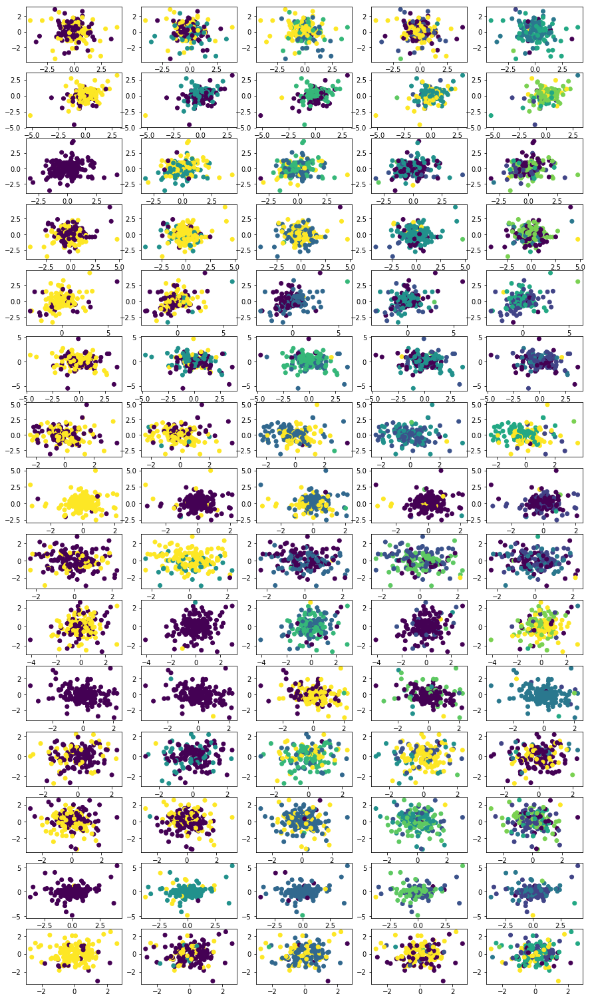

performing k=2,rep=0,umap neighbors=5,metric=cosine
performing k=3,rep=0,umap neighbors=5,metric=cosine
performing k=4,rep=0,umap neighbors=5,metric=cosine
performing k=5,rep=0,umap neighbors=5,metric=cosine
performing k=6,rep=0,umap neighbors=5,metric=cosine
performing k=2,rep=0,umap neighbors=5,metric=euclidean
performing k=3,rep=0,umap neighbors=5,metric=euclidean
performing k=4,rep=0,umap neighbors=5,metric=euclidean
performing k=5,rep=0,umap neighbors=5,metric=euclidean
performing k=6,rep=0,umap neighbors=5,metric=euclidean
performing k=2,rep=0,umap neighbors=5,metric=correlation
performing k=3,rep=0,umap neighbors=5,metric=correlation
performing k=4,rep=0,umap neighbors=5,metric=correlation
performing k=5,rep=0,umap neighbors=5,metric=correlation
performing k=6,rep=0,umap neighbors=5,metric=correlation
performing k=2,rep=0,umap neighbors=10,metric=cosine
performing k=3,rep=0,umap neighbors=10,metric=cosine
performing k=4,rep=0,umap neighbors=10,metric=cosine
performing k=5,rep=0,

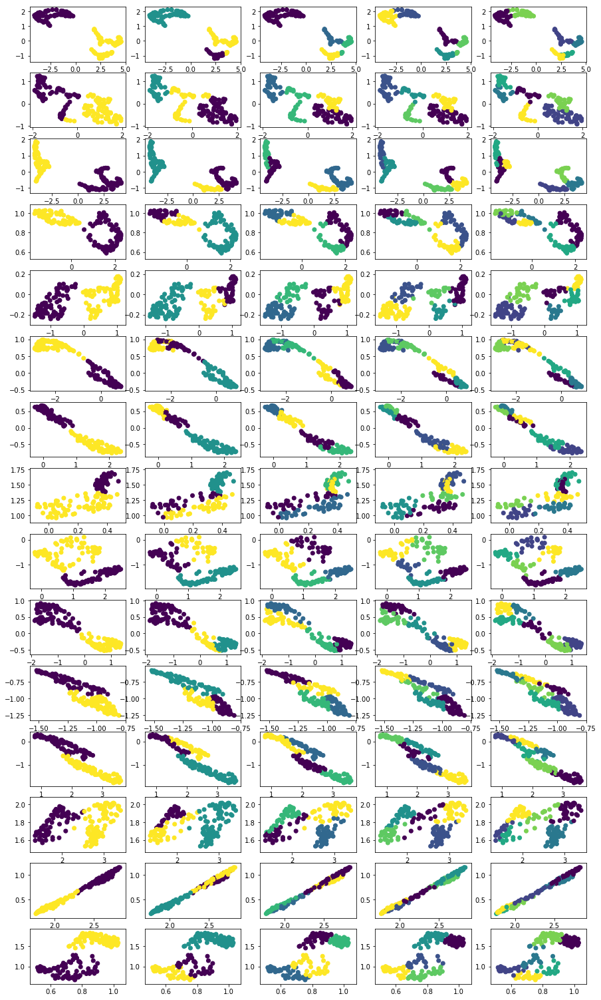

performing k=2,rep=1,tsne perplexity=10,metric=cosine
performing k=3,rep=1,tsne perplexity=10,metric=cosine
performing k=4,rep=1,tsne perplexity=10,metric=cosine
performing k=5,rep=1,tsne perplexity=10,metric=cosine
performing k=6,rep=1,tsne perplexity=10,metric=cosine
performing k=2,rep=1,tsne perplexity=10,metric=euclidean
performing k=3,rep=1,tsne perplexity=10,metric=euclidean
performing k=4,rep=1,tsne perplexity=10,metric=euclidean
performing k=5,rep=1,tsne perplexity=10,metric=euclidean
performing k=6,rep=1,tsne perplexity=10,metric=euclidean
performing k=2,rep=1,tsne perplexity=10,metric=correlation
performing k=3,rep=1,tsne perplexity=10,metric=correlation
performing k=4,rep=1,tsne perplexity=10,metric=correlation
performing k=5,rep=1,tsne perplexity=10,metric=correlation
performing k=6,rep=1,tsne perplexity=10,metric=correlation
performing k=2,rep=1,tsne perplexity=20,metric=cosine
performing k=3,rep=1,tsne perplexity=20,metric=cosine
performing k=4,rep=1,tsne perplexity=20,me

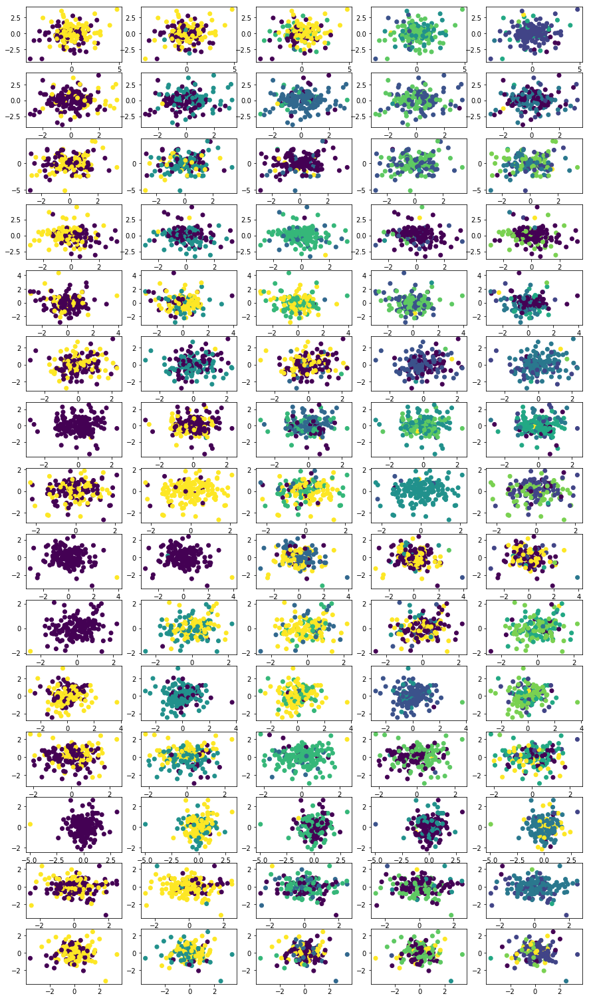

performing k=2,rep=1,umap neighbors=5,metric=cosine
performing k=3,rep=1,umap neighbors=5,metric=cosine
performing k=4,rep=1,umap neighbors=5,metric=cosine
performing k=5,rep=1,umap neighbors=5,metric=cosine
performing k=6,rep=1,umap neighbors=5,metric=cosine
performing k=2,rep=1,umap neighbors=5,metric=euclidean
performing k=3,rep=1,umap neighbors=5,metric=euclidean
performing k=4,rep=1,umap neighbors=5,metric=euclidean
performing k=5,rep=1,umap neighbors=5,metric=euclidean
performing k=6,rep=1,umap neighbors=5,metric=euclidean
performing k=2,rep=1,umap neighbors=5,metric=correlation
performing k=3,rep=1,umap neighbors=5,metric=correlation
performing k=4,rep=1,umap neighbors=5,metric=correlation
performing k=5,rep=1,umap neighbors=5,metric=correlation
performing k=6,rep=1,umap neighbors=5,metric=correlation
performing k=2,rep=1,umap neighbors=10,metric=cosine
performing k=3,rep=1,umap neighbors=10,metric=cosine
performing k=4,rep=1,umap neighbors=10,metric=cosine
performing k=5,rep=1,

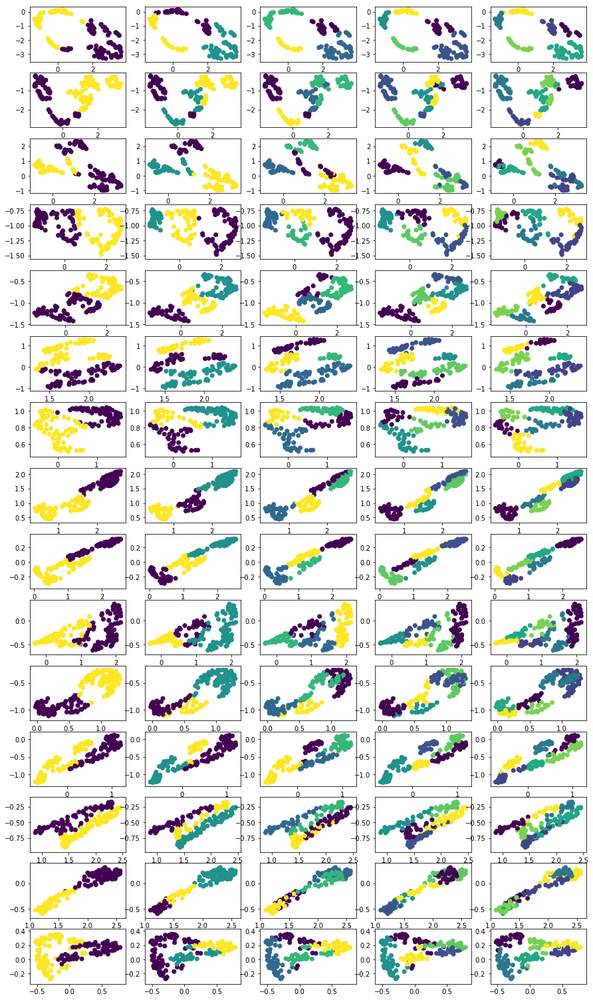

performing k=2,rep=2,tsne perplexity=10,metric=cosine
performing k=3,rep=2,tsne perplexity=10,metric=cosine
performing k=4,rep=2,tsne perplexity=10,metric=cosine
performing k=5,rep=2,tsne perplexity=10,metric=cosine
performing k=6,rep=2,tsne perplexity=10,metric=cosine
performing k=2,rep=2,tsne perplexity=10,metric=euclidean
performing k=3,rep=2,tsne perplexity=10,metric=euclidean
performing k=4,rep=2,tsne perplexity=10,metric=euclidean
performing k=5,rep=2,tsne perplexity=10,metric=euclidean
performing k=6,rep=2,tsne perplexity=10,metric=euclidean
performing k=2,rep=2,tsne perplexity=10,metric=correlation
performing k=3,rep=2,tsne perplexity=10,metric=correlation
performing k=4,rep=2,tsne perplexity=10,metric=correlation
performing k=5,rep=2,tsne perplexity=10,metric=correlation
performing k=6,rep=2,tsne perplexity=10,metric=correlation
performing k=2,rep=2,tsne perplexity=20,metric=cosine
performing k=3,rep=2,tsne perplexity=20,metric=cosine
performing k=4,rep=2,tsne perplexity=20,me

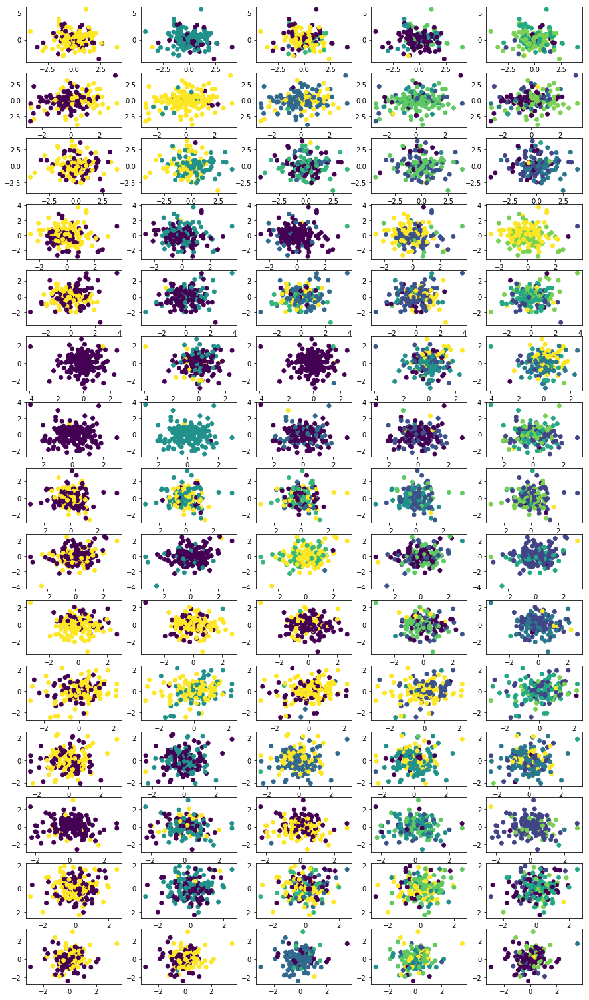

performing k=2,rep=2,umap neighbors=5,metric=cosine
performing k=3,rep=2,umap neighbors=5,metric=cosine
performing k=4,rep=2,umap neighbors=5,metric=cosine
performing k=5,rep=2,umap neighbors=5,metric=cosine
performing k=6,rep=2,umap neighbors=5,metric=cosine
performing k=2,rep=2,umap neighbors=5,metric=euclidean
performing k=3,rep=2,umap neighbors=5,metric=euclidean
performing k=4,rep=2,umap neighbors=5,metric=euclidean
performing k=5,rep=2,umap neighbors=5,metric=euclidean
performing k=6,rep=2,umap neighbors=5,metric=euclidean
performing k=2,rep=2,umap neighbors=5,metric=correlation
performing k=3,rep=2,umap neighbors=5,metric=correlation
performing k=4,rep=2,umap neighbors=5,metric=correlation
performing k=5,rep=2,umap neighbors=5,metric=correlation
performing k=6,rep=2,umap neighbors=5,metric=correlation
performing k=2,rep=2,umap neighbors=10,metric=cosine
performing k=3,rep=2,umap neighbors=10,metric=cosine
performing k=4,rep=2,umap neighbors=10,metric=cosine
performing k=5,rep=2,

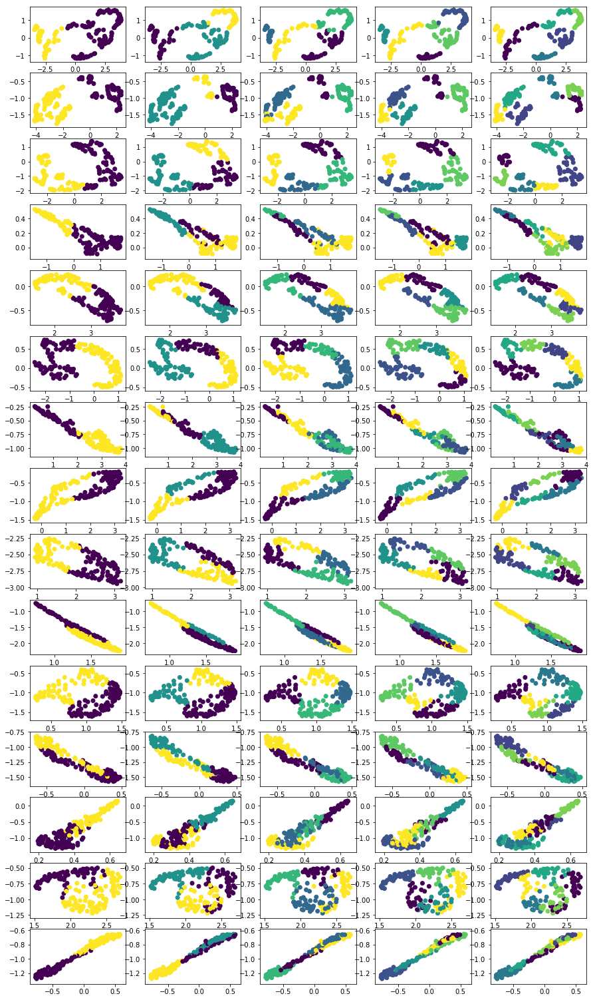

performing k=2,rep=3,tsne perplexity=10,metric=cosine
performing k=3,rep=3,tsne perplexity=10,metric=cosine
performing k=4,rep=3,tsne perplexity=10,metric=cosine
performing k=5,rep=3,tsne perplexity=10,metric=cosine
performing k=6,rep=3,tsne perplexity=10,metric=cosine
performing k=2,rep=3,tsne perplexity=10,metric=euclidean
performing k=3,rep=3,tsne perplexity=10,metric=euclidean
performing k=4,rep=3,tsne perplexity=10,metric=euclidean
performing k=5,rep=3,tsne perplexity=10,metric=euclidean
performing k=6,rep=3,tsne perplexity=10,metric=euclidean
performing k=2,rep=3,tsne perplexity=10,metric=correlation
performing k=3,rep=3,tsne perplexity=10,metric=correlation
performing k=4,rep=3,tsne perplexity=10,metric=correlation
performing k=5,rep=3,tsne perplexity=10,metric=correlation
performing k=6,rep=3,tsne perplexity=10,metric=correlation
performing k=2,rep=3,tsne perplexity=20,metric=cosine
performing k=3,rep=3,tsne perplexity=20,metric=cosine
performing k=4,rep=3,tsne perplexity=20,me

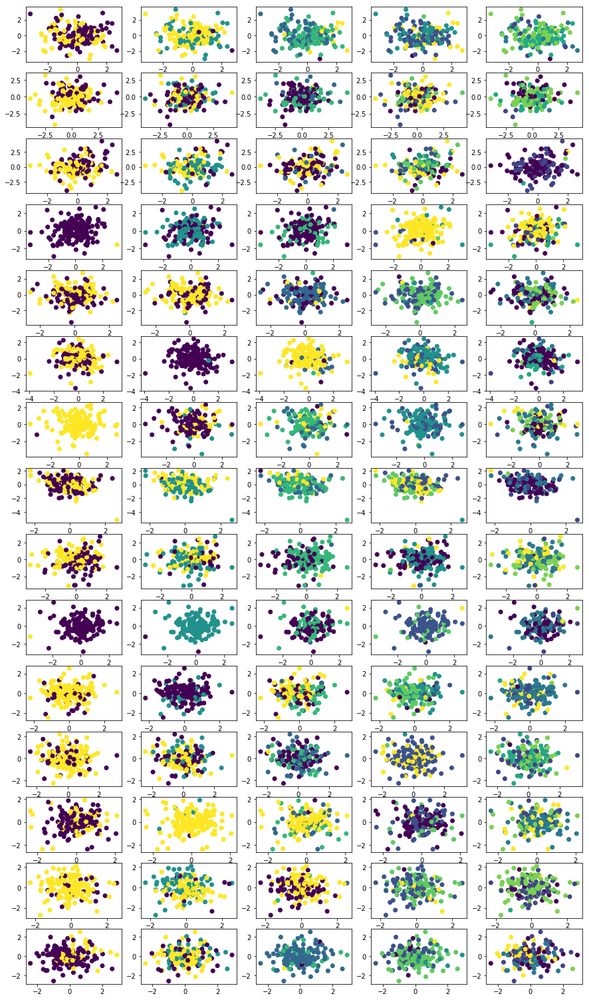

performing k=2,rep=3,umap neighbors=5,metric=cosine
performing k=3,rep=3,umap neighbors=5,metric=cosine
performing k=4,rep=3,umap neighbors=5,metric=cosine
performing k=5,rep=3,umap neighbors=5,metric=cosine
performing k=6,rep=3,umap neighbors=5,metric=cosine
performing k=2,rep=3,umap neighbors=5,metric=euclidean
performing k=3,rep=3,umap neighbors=5,metric=euclidean
performing k=4,rep=3,umap neighbors=5,metric=euclidean
performing k=5,rep=3,umap neighbors=5,metric=euclidean
performing k=6,rep=3,umap neighbors=5,metric=euclidean
performing k=2,rep=3,umap neighbors=5,metric=correlation
performing k=3,rep=3,umap neighbors=5,metric=correlation
performing k=4,rep=3,umap neighbors=5,metric=correlation
performing k=5,rep=3,umap neighbors=5,metric=correlation
performing k=6,rep=3,umap neighbors=5,metric=correlation
performing k=2,rep=3,umap neighbors=10,metric=cosine
performing k=3,rep=3,umap neighbors=10,metric=cosine
performing k=4,rep=3,umap neighbors=10,metric=cosine
performing k=5,rep=3,

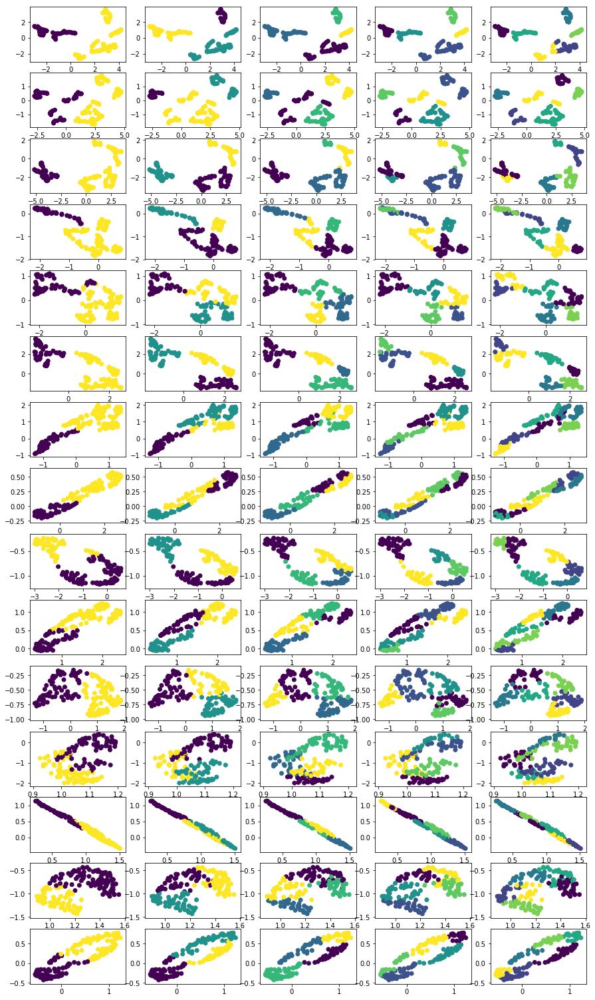

performing k=2,rep=4,tsne perplexity=10,metric=cosine
performing k=3,rep=4,tsne perplexity=10,metric=cosine
performing k=4,rep=4,tsne perplexity=10,metric=cosine
performing k=5,rep=4,tsne perplexity=10,metric=cosine
performing k=6,rep=4,tsne perplexity=10,metric=cosine
performing k=2,rep=4,tsne perplexity=10,metric=euclidean
performing k=3,rep=4,tsne perplexity=10,metric=euclidean
performing k=4,rep=4,tsne perplexity=10,metric=euclidean
performing k=5,rep=4,tsne perplexity=10,metric=euclidean
performing k=6,rep=4,tsne perplexity=10,metric=euclidean
performing k=2,rep=4,tsne perplexity=10,metric=correlation
performing k=3,rep=4,tsne perplexity=10,metric=correlation
performing k=4,rep=4,tsne perplexity=10,metric=correlation
performing k=5,rep=4,tsne perplexity=10,metric=correlation
performing k=6,rep=4,tsne perplexity=10,metric=correlation
performing k=2,rep=4,tsne perplexity=20,metric=cosine
performing k=3,rep=4,tsne perplexity=20,metric=cosine
performing k=4,rep=4,tsne perplexity=20,me

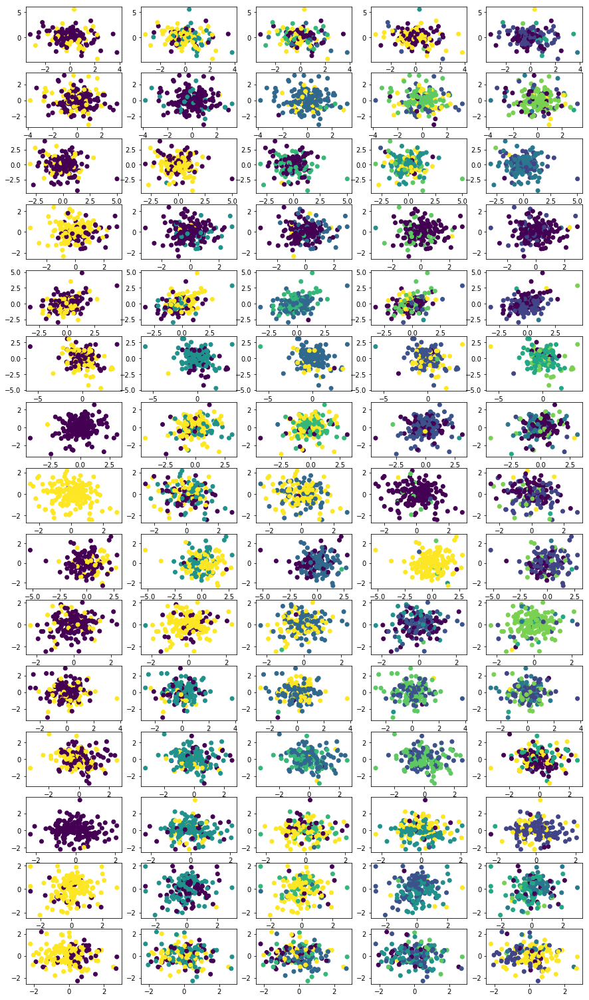

performing k=2,rep=4,umap neighbors=5,metric=cosine
performing k=3,rep=4,umap neighbors=5,metric=cosine
performing k=4,rep=4,umap neighbors=5,metric=cosine
performing k=5,rep=4,umap neighbors=5,metric=cosine
performing k=6,rep=4,umap neighbors=5,metric=cosine
performing k=2,rep=4,umap neighbors=5,metric=euclidean
performing k=3,rep=4,umap neighbors=5,metric=euclidean
performing k=4,rep=4,umap neighbors=5,metric=euclidean
performing k=5,rep=4,umap neighbors=5,metric=euclidean
performing k=6,rep=4,umap neighbors=5,metric=euclidean
performing k=2,rep=4,umap neighbors=5,metric=correlation
performing k=3,rep=4,umap neighbors=5,metric=correlation
performing k=4,rep=4,umap neighbors=5,metric=correlation
performing k=5,rep=4,umap neighbors=5,metric=correlation
performing k=6,rep=4,umap neighbors=5,metric=correlation
performing k=2,rep=4,umap neighbors=10,metric=cosine
performing k=3,rep=4,umap neighbors=10,metric=cosine
performing k=4,rep=4,umap neighbors=10,metric=cosine
performing k=5,rep=4,

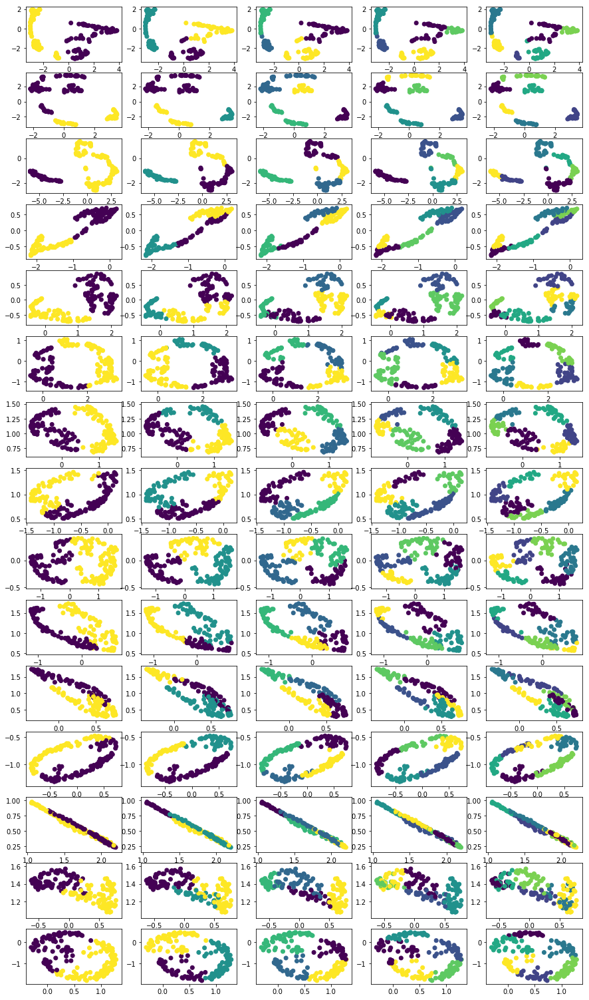

performing k=2,rep=5,tsne perplexity=10,metric=cosine
performing k=3,rep=5,tsne perplexity=10,metric=cosine
performing k=4,rep=5,tsne perplexity=10,metric=cosine
performing k=5,rep=5,tsne perplexity=10,metric=cosine
performing k=6,rep=5,tsne perplexity=10,metric=cosine
performing k=2,rep=5,tsne perplexity=10,metric=euclidean
performing k=3,rep=5,tsne perplexity=10,metric=euclidean
performing k=4,rep=5,tsne perplexity=10,metric=euclidean
performing k=5,rep=5,tsne perplexity=10,metric=euclidean
performing k=6,rep=5,tsne perplexity=10,metric=euclidean
performing k=2,rep=5,tsne perplexity=10,metric=correlation
performing k=3,rep=5,tsne perplexity=10,metric=correlation
performing k=4,rep=5,tsne perplexity=10,metric=correlation
performing k=5,rep=5,tsne perplexity=10,metric=correlation
performing k=6,rep=5,tsne perplexity=10,metric=correlation
performing k=2,rep=5,tsne perplexity=20,metric=cosine
performing k=3,rep=5,tsne perplexity=20,metric=cosine
performing k=4,rep=5,tsne perplexity=20,me

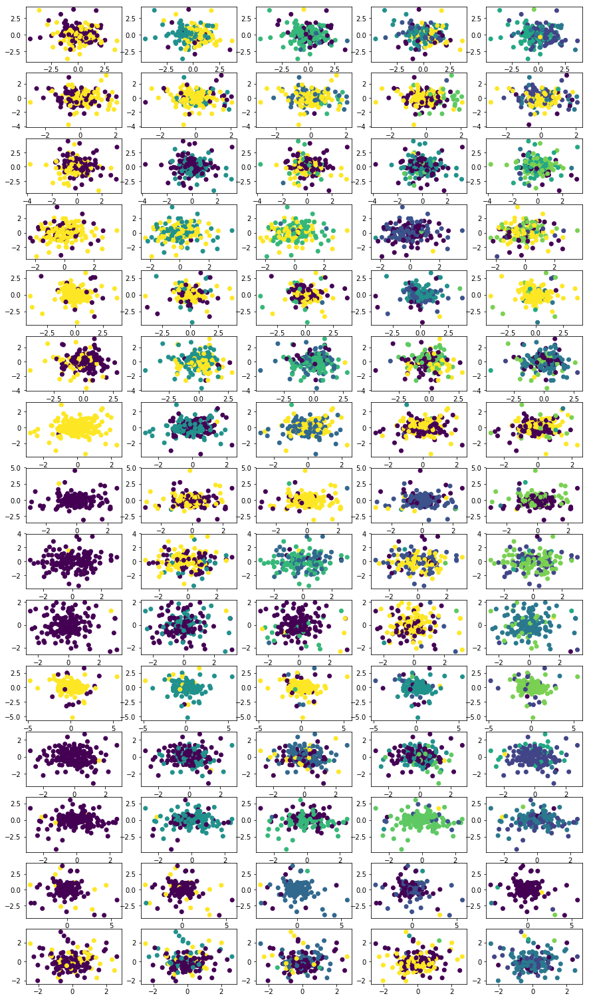

performing k=2,rep=5,umap neighbors=5,metric=cosine
performing k=3,rep=5,umap neighbors=5,metric=cosine
performing k=4,rep=5,umap neighbors=5,metric=cosine
performing k=5,rep=5,umap neighbors=5,metric=cosine
performing k=6,rep=5,umap neighbors=5,metric=cosine
performing k=2,rep=5,umap neighbors=5,metric=euclidean
performing k=3,rep=5,umap neighbors=5,metric=euclidean
performing k=4,rep=5,umap neighbors=5,metric=euclidean
performing k=5,rep=5,umap neighbors=5,metric=euclidean
performing k=6,rep=5,umap neighbors=5,metric=euclidean
performing k=2,rep=5,umap neighbors=5,metric=correlation
performing k=3,rep=5,umap neighbors=5,metric=correlation
performing k=4,rep=5,umap neighbors=5,metric=correlation
performing k=5,rep=5,umap neighbors=5,metric=correlation
performing k=6,rep=5,umap neighbors=5,metric=correlation
performing k=2,rep=5,umap neighbors=10,metric=cosine
performing k=3,rep=5,umap neighbors=10,metric=cosine
performing k=4,rep=5,umap neighbors=10,metric=cosine
performing k=5,rep=5,

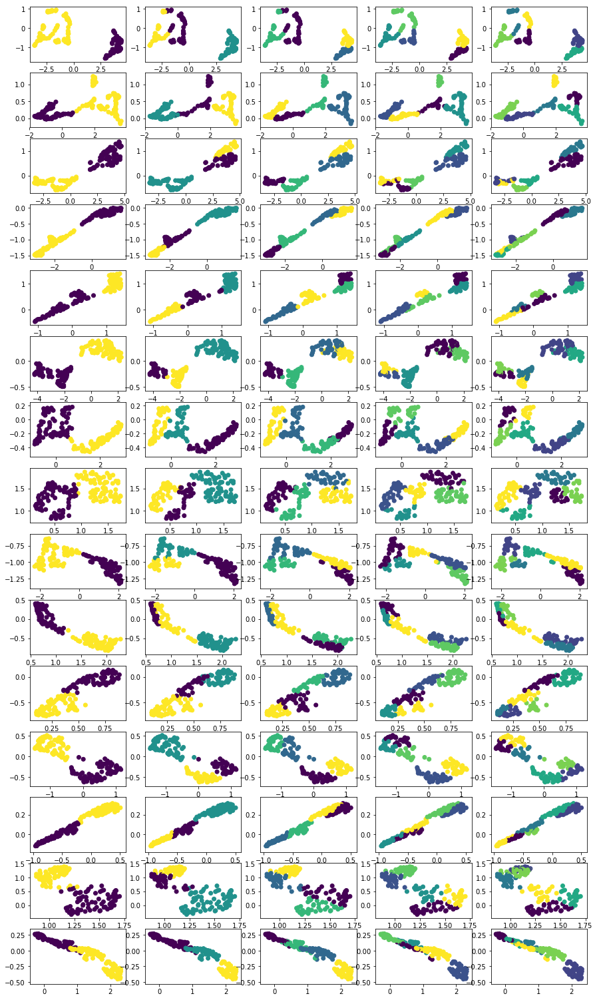

performing k=2,rep=6,tsne perplexity=10,metric=cosine
performing k=3,rep=6,tsne perplexity=10,metric=cosine
performing k=4,rep=6,tsne perplexity=10,metric=cosine
performing k=5,rep=6,tsne perplexity=10,metric=cosine
performing k=6,rep=6,tsne perplexity=10,metric=cosine
performing k=2,rep=6,tsne perplexity=10,metric=euclidean
performing k=3,rep=6,tsne perplexity=10,metric=euclidean
performing k=4,rep=6,tsne perplexity=10,metric=euclidean
performing k=5,rep=6,tsne perplexity=10,metric=euclidean
performing k=6,rep=6,tsne perplexity=10,metric=euclidean
performing k=2,rep=6,tsne perplexity=10,metric=correlation
performing k=3,rep=6,tsne perplexity=10,metric=correlation
performing k=4,rep=6,tsne perplexity=10,metric=correlation
performing k=5,rep=6,tsne perplexity=10,metric=correlation
performing k=6,rep=6,tsne perplexity=10,metric=correlation
performing k=2,rep=6,tsne perplexity=20,metric=cosine
performing k=3,rep=6,tsne perplexity=20,metric=cosine
performing k=4,rep=6,tsne perplexity=20,me

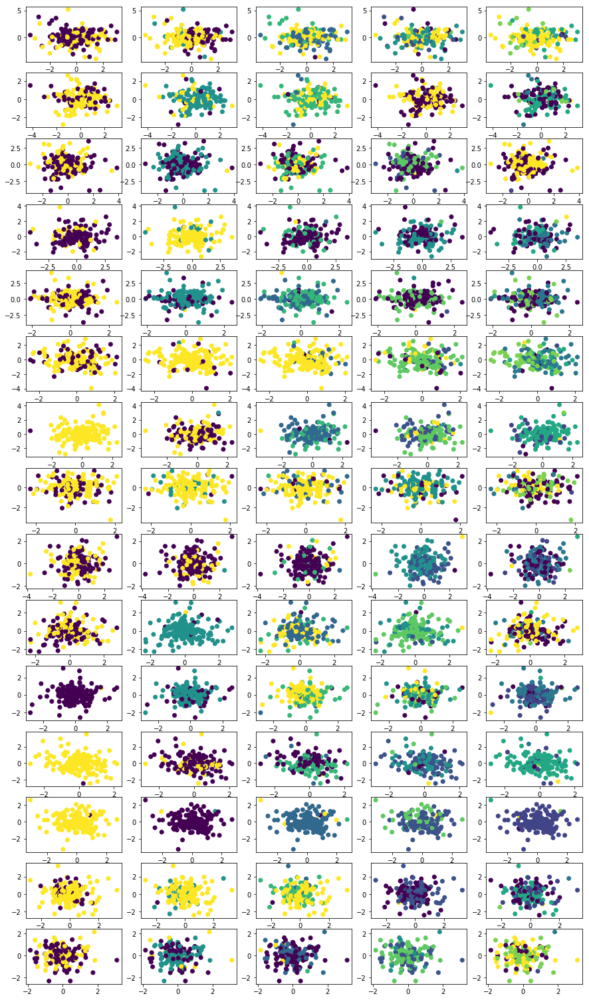

performing k=2,rep=6,umap neighbors=5,metric=cosine
performing k=3,rep=6,umap neighbors=5,metric=cosine
performing k=4,rep=6,umap neighbors=5,metric=cosine
performing k=5,rep=6,umap neighbors=5,metric=cosine
performing k=6,rep=6,umap neighbors=5,metric=cosine
performing k=2,rep=6,umap neighbors=5,metric=euclidean
performing k=3,rep=6,umap neighbors=5,metric=euclidean
performing k=4,rep=6,umap neighbors=5,metric=euclidean
performing k=5,rep=6,umap neighbors=5,metric=euclidean
performing k=6,rep=6,umap neighbors=5,metric=euclidean
performing k=2,rep=6,umap neighbors=5,metric=correlation
performing k=3,rep=6,umap neighbors=5,metric=correlation
performing k=4,rep=6,umap neighbors=5,metric=correlation
performing k=5,rep=6,umap neighbors=5,metric=correlation
performing k=6,rep=6,umap neighbors=5,metric=correlation
performing k=2,rep=6,umap neighbors=10,metric=cosine
performing k=3,rep=6,umap neighbors=10,metric=cosine
performing k=4,rep=6,umap neighbors=10,metric=cosine
performing k=5,rep=6,

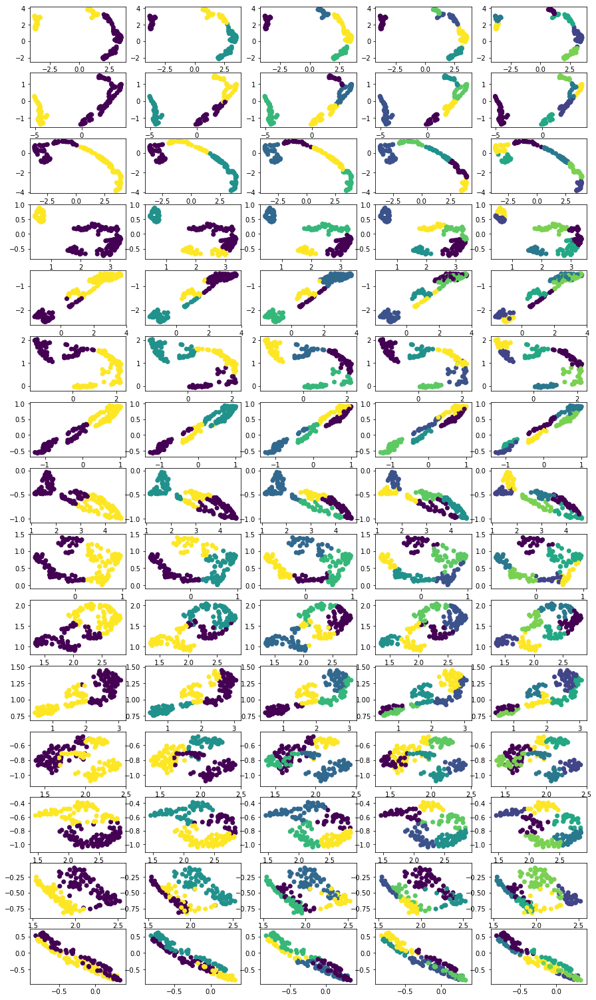

performing k=2,rep=7,tsne perplexity=10,metric=cosine
performing k=3,rep=7,tsne perplexity=10,metric=cosine
performing k=4,rep=7,tsne perplexity=10,metric=cosine
performing k=5,rep=7,tsne perplexity=10,metric=cosine
performing k=6,rep=7,tsne perplexity=10,metric=cosine
performing k=2,rep=7,tsne perplexity=10,metric=euclidean
performing k=3,rep=7,tsne perplexity=10,metric=euclidean
performing k=4,rep=7,tsne perplexity=10,metric=euclidean
performing k=5,rep=7,tsne perplexity=10,metric=euclidean
performing k=6,rep=7,tsne perplexity=10,metric=euclidean
performing k=2,rep=7,tsne perplexity=10,metric=correlation
performing k=3,rep=7,tsne perplexity=10,metric=correlation
performing k=4,rep=7,tsne perplexity=10,metric=correlation
performing k=5,rep=7,tsne perplexity=10,metric=correlation
performing k=6,rep=7,tsne perplexity=10,metric=correlation
performing k=2,rep=7,tsne perplexity=20,metric=cosine
performing k=3,rep=7,tsne perplexity=20,metric=cosine
performing k=4,rep=7,tsne perplexity=20,me

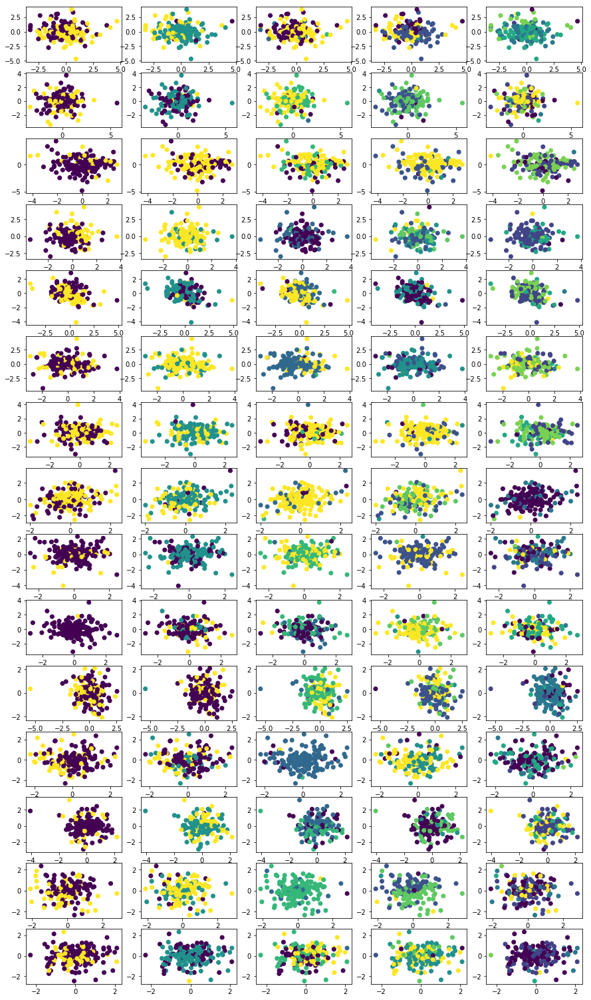

performing k=2,rep=7,umap neighbors=5,metric=cosine
performing k=3,rep=7,umap neighbors=5,metric=cosine
performing k=4,rep=7,umap neighbors=5,metric=cosine
performing k=5,rep=7,umap neighbors=5,metric=cosine
performing k=6,rep=7,umap neighbors=5,metric=cosine
performing k=2,rep=7,umap neighbors=5,metric=euclidean
performing k=3,rep=7,umap neighbors=5,metric=euclidean
performing k=4,rep=7,umap neighbors=5,metric=euclidean
performing k=5,rep=7,umap neighbors=5,metric=euclidean
performing k=6,rep=7,umap neighbors=5,metric=euclidean
performing k=2,rep=7,umap neighbors=5,metric=correlation
performing k=3,rep=7,umap neighbors=5,metric=correlation
performing k=4,rep=7,umap neighbors=5,metric=correlation
performing k=5,rep=7,umap neighbors=5,metric=correlation
performing k=6,rep=7,umap neighbors=5,metric=correlation
performing k=2,rep=7,umap neighbors=10,metric=cosine
performing k=3,rep=7,umap neighbors=10,metric=cosine
performing k=4,rep=7,umap neighbors=10,metric=cosine
performing k=5,rep=7,

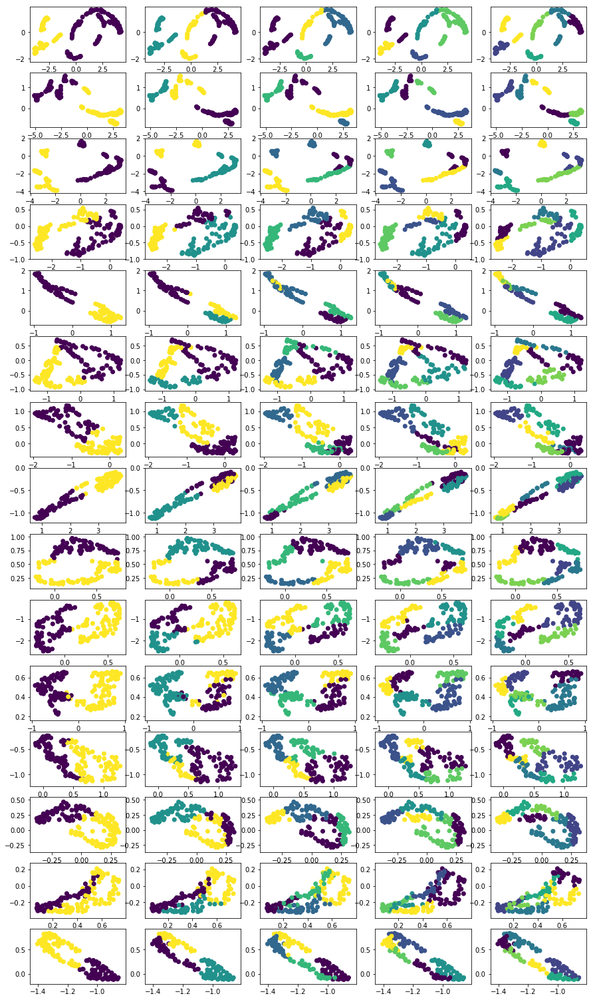

performing k=2,rep=8,tsne perplexity=10,metric=cosine
performing k=3,rep=8,tsne perplexity=10,metric=cosine
performing k=4,rep=8,tsne perplexity=10,metric=cosine
performing k=5,rep=8,tsne perplexity=10,metric=cosine
performing k=6,rep=8,tsne perplexity=10,metric=cosine
performing k=2,rep=8,tsne perplexity=10,metric=euclidean
performing k=3,rep=8,tsne perplexity=10,metric=euclidean
performing k=4,rep=8,tsne perplexity=10,metric=euclidean
performing k=5,rep=8,tsne perplexity=10,metric=euclidean
performing k=6,rep=8,tsne perplexity=10,metric=euclidean
performing k=2,rep=8,tsne perplexity=10,metric=correlation
performing k=3,rep=8,tsne perplexity=10,metric=correlation
performing k=4,rep=8,tsne perplexity=10,metric=correlation
performing k=5,rep=8,tsne perplexity=10,metric=correlation
performing k=6,rep=8,tsne perplexity=10,metric=correlation
performing k=2,rep=8,tsne perplexity=20,metric=cosine
performing k=3,rep=8,tsne perplexity=20,metric=cosine
performing k=4,rep=8,tsne perplexity=20,me

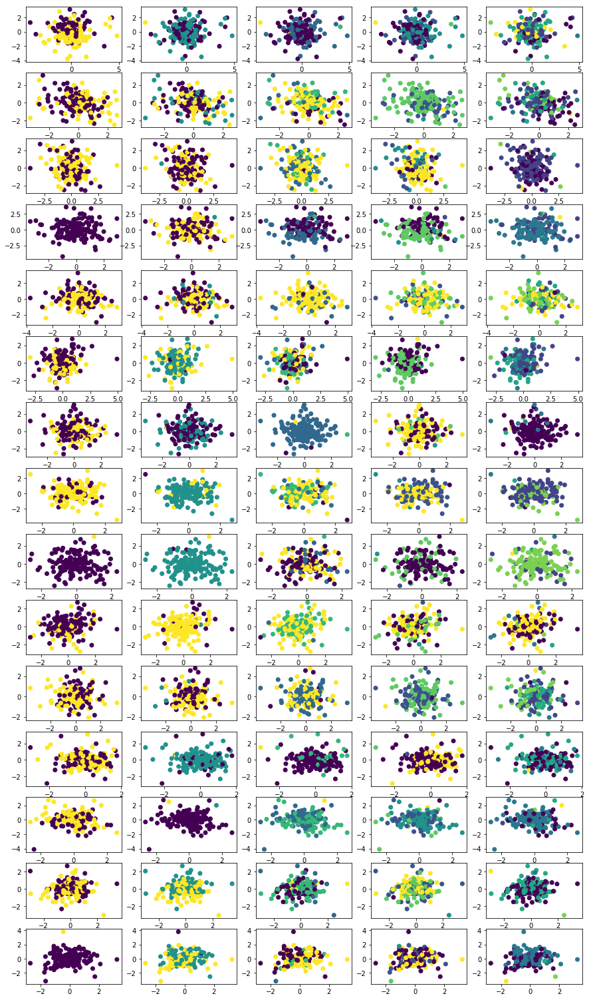

performing k=2,rep=8,umap neighbors=5,metric=cosine
performing k=3,rep=8,umap neighbors=5,metric=cosine
performing k=4,rep=8,umap neighbors=5,metric=cosine
performing k=5,rep=8,umap neighbors=5,metric=cosine
performing k=6,rep=8,umap neighbors=5,metric=cosine
performing k=2,rep=8,umap neighbors=5,metric=euclidean
performing k=3,rep=8,umap neighbors=5,metric=euclidean
performing k=4,rep=8,umap neighbors=5,metric=euclidean
performing k=5,rep=8,umap neighbors=5,metric=euclidean
performing k=6,rep=8,umap neighbors=5,metric=euclidean
performing k=2,rep=8,umap neighbors=5,metric=correlation
performing k=3,rep=8,umap neighbors=5,metric=correlation
performing k=4,rep=8,umap neighbors=5,metric=correlation
performing k=5,rep=8,umap neighbors=5,metric=correlation
performing k=6,rep=8,umap neighbors=5,metric=correlation
performing k=2,rep=8,umap neighbors=10,metric=cosine
performing k=3,rep=8,umap neighbors=10,metric=cosine
performing k=4,rep=8,umap neighbors=10,metric=cosine
performing k=5,rep=8,

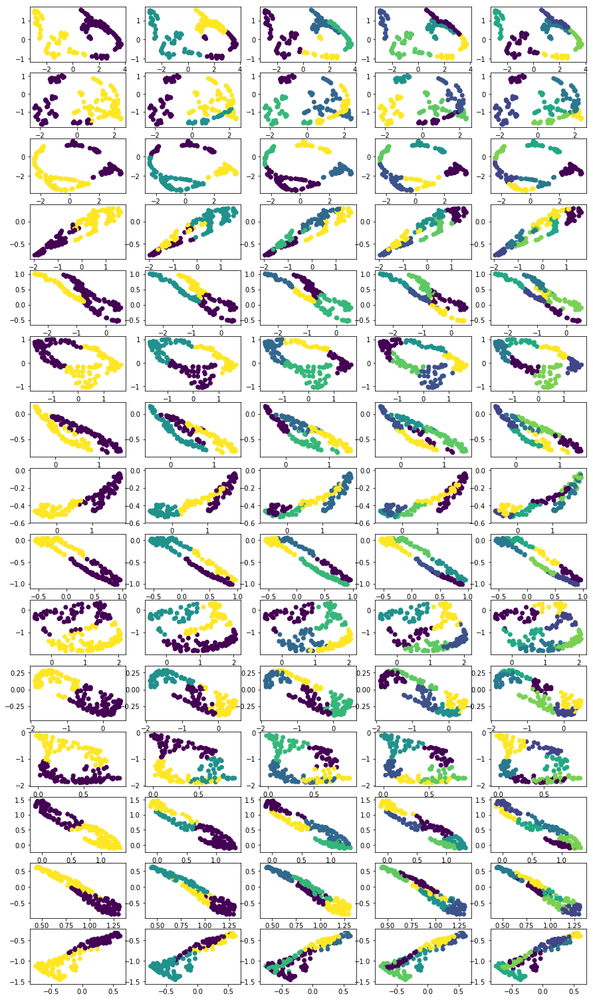

performing k=2,rep=9,tsne perplexity=10,metric=cosine
performing k=3,rep=9,tsne perplexity=10,metric=cosine
performing k=4,rep=9,tsne perplexity=10,metric=cosine
performing k=5,rep=9,tsne perplexity=10,metric=cosine
performing k=6,rep=9,tsne perplexity=10,metric=cosine
performing k=2,rep=9,tsne perplexity=10,metric=euclidean
performing k=3,rep=9,tsne perplexity=10,metric=euclidean
performing k=4,rep=9,tsne perplexity=10,metric=euclidean
performing k=5,rep=9,tsne perplexity=10,metric=euclidean
performing k=6,rep=9,tsne perplexity=10,metric=euclidean
performing k=2,rep=9,tsne perplexity=10,metric=correlation
performing k=3,rep=9,tsne perplexity=10,metric=correlation
performing k=4,rep=9,tsne perplexity=10,metric=correlation
performing k=5,rep=9,tsne perplexity=10,metric=correlation
performing k=6,rep=9,tsne perplexity=10,metric=correlation
performing k=2,rep=9,tsne perplexity=20,metric=cosine
performing k=3,rep=9,tsne perplexity=20,metric=cosine
performing k=4,rep=9,tsne perplexity=20,me

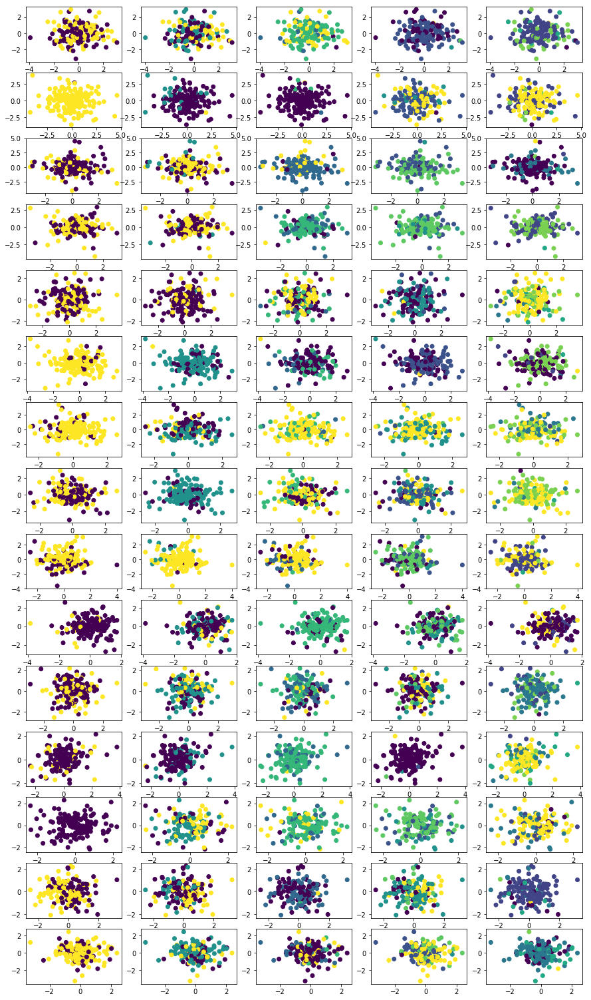

performing k=2,rep=9,umap neighbors=5,metric=cosine
performing k=3,rep=9,umap neighbors=5,metric=cosine
performing k=4,rep=9,umap neighbors=5,metric=cosine
performing k=5,rep=9,umap neighbors=5,metric=cosine
performing k=6,rep=9,umap neighbors=5,metric=cosine
performing k=2,rep=9,umap neighbors=5,metric=euclidean
performing k=3,rep=9,umap neighbors=5,metric=euclidean
performing k=4,rep=9,umap neighbors=5,metric=euclidean
performing k=5,rep=9,umap neighbors=5,metric=euclidean
performing k=6,rep=9,umap neighbors=5,metric=euclidean
performing k=2,rep=9,umap neighbors=5,metric=correlation
performing k=3,rep=9,umap neighbors=5,metric=correlation
performing k=4,rep=9,umap neighbors=5,metric=correlation
performing k=5,rep=9,umap neighbors=5,metric=correlation
performing k=6,rep=9,umap neighbors=5,metric=correlation
performing k=2,rep=9,umap neighbors=10,metric=cosine
performing k=3,rep=9,umap neighbors=10,metric=cosine
performing k=4,rep=9,umap neighbors=10,metric=cosine
performing k=5,rep=9,

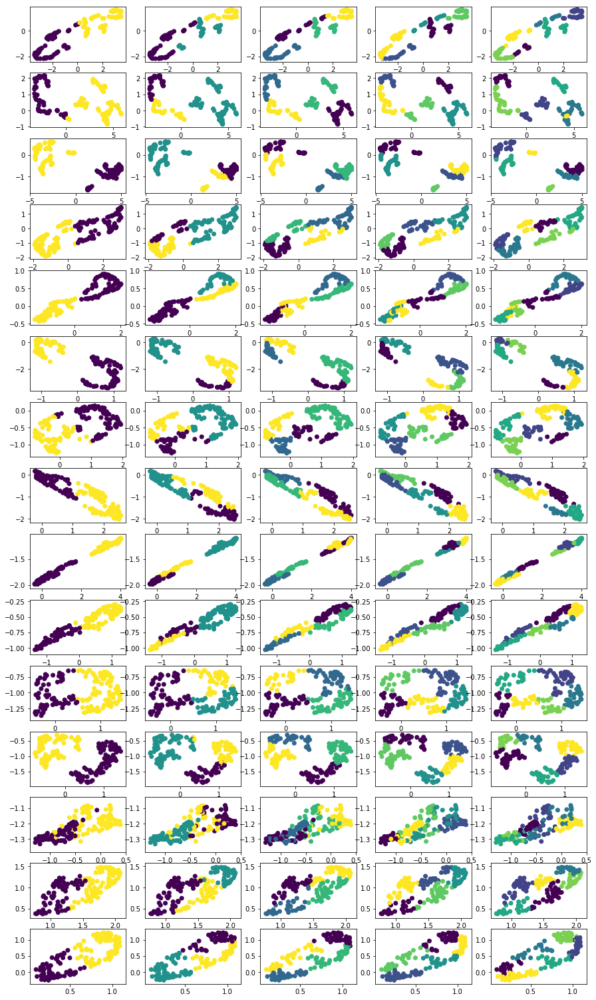

performing k=2,rep=10,tsne perplexity=10,metric=cosine
performing k=3,rep=10,tsne perplexity=10,metric=cosine
performing k=4,rep=10,tsne perplexity=10,metric=cosine
performing k=5,rep=10,tsne perplexity=10,metric=cosine
performing k=6,rep=10,tsne perplexity=10,metric=cosine
performing k=2,rep=10,tsne perplexity=10,metric=euclidean
performing k=3,rep=10,tsne perplexity=10,metric=euclidean
performing k=4,rep=10,tsne perplexity=10,metric=euclidean
performing k=5,rep=10,tsne perplexity=10,metric=euclidean
performing k=6,rep=10,tsne perplexity=10,metric=euclidean
performing k=2,rep=10,tsne perplexity=10,metric=correlation
performing k=3,rep=10,tsne perplexity=10,metric=correlation
performing k=4,rep=10,tsne perplexity=10,metric=correlation
performing k=5,rep=10,tsne perplexity=10,metric=correlation
performing k=6,rep=10,tsne perplexity=10,metric=correlation
performing k=2,rep=10,tsne perplexity=20,metric=cosine
performing k=3,rep=10,tsne perplexity=20,metric=cosine
performing k=4,rep=10,tsn

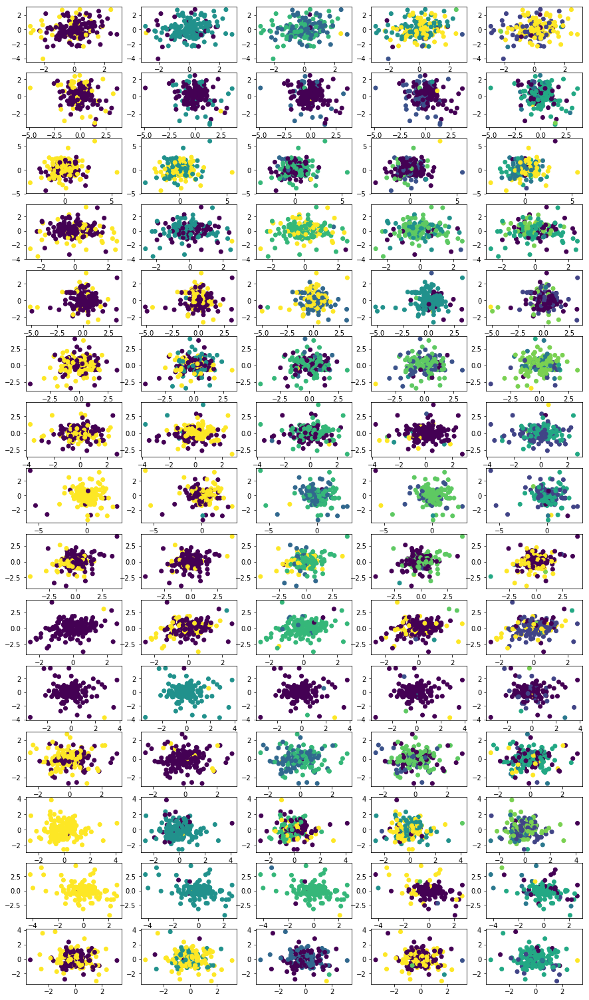

performing k=2,rep=10,umap neighbors=5,metric=cosine
performing k=3,rep=10,umap neighbors=5,metric=cosine
performing k=4,rep=10,umap neighbors=5,metric=cosine
performing k=5,rep=10,umap neighbors=5,metric=cosine
performing k=6,rep=10,umap neighbors=5,metric=cosine
performing k=2,rep=10,umap neighbors=5,metric=euclidean
performing k=3,rep=10,umap neighbors=5,metric=euclidean
performing k=4,rep=10,umap neighbors=5,metric=euclidean
performing k=5,rep=10,umap neighbors=5,metric=euclidean
performing k=6,rep=10,umap neighbors=5,metric=euclidean
performing k=2,rep=10,umap neighbors=5,metric=correlation
performing k=3,rep=10,umap neighbors=5,metric=correlation
performing k=4,rep=10,umap neighbors=5,metric=correlation
performing k=5,rep=10,umap neighbors=5,metric=correlation
performing k=6,rep=10,umap neighbors=5,metric=correlation
performing k=2,rep=10,umap neighbors=10,metric=cosine
performing k=3,rep=10,umap neighbors=10,metric=cosine
performing k=4,rep=10,umap neighbors=10,metric=cosine
per

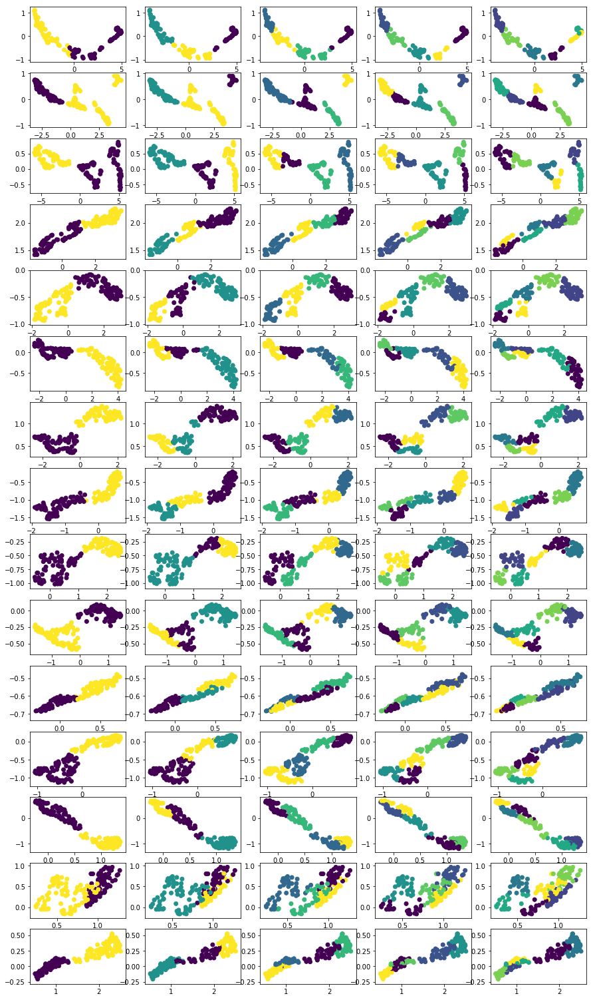

performing k=2,rep=11,tsne perplexity=10,metric=cosine
performing k=3,rep=11,tsne perplexity=10,metric=cosine
performing k=4,rep=11,tsne perplexity=10,metric=cosine
performing k=5,rep=11,tsne perplexity=10,metric=cosine
performing k=6,rep=11,tsne perplexity=10,metric=cosine
performing k=2,rep=11,tsne perplexity=10,metric=euclidean
performing k=3,rep=11,tsne perplexity=10,metric=euclidean
performing k=4,rep=11,tsne perplexity=10,metric=euclidean
performing k=5,rep=11,tsne perplexity=10,metric=euclidean
performing k=6,rep=11,tsne perplexity=10,metric=euclidean
performing k=2,rep=11,tsne perplexity=10,metric=correlation
performing k=3,rep=11,tsne perplexity=10,metric=correlation
performing k=4,rep=11,tsne perplexity=10,metric=correlation
performing k=5,rep=11,tsne perplexity=10,metric=correlation
performing k=6,rep=11,tsne perplexity=10,metric=correlation
performing k=2,rep=11,tsne perplexity=20,metric=cosine
performing k=3,rep=11,tsne perplexity=20,metric=cosine
performing k=4,rep=11,tsn

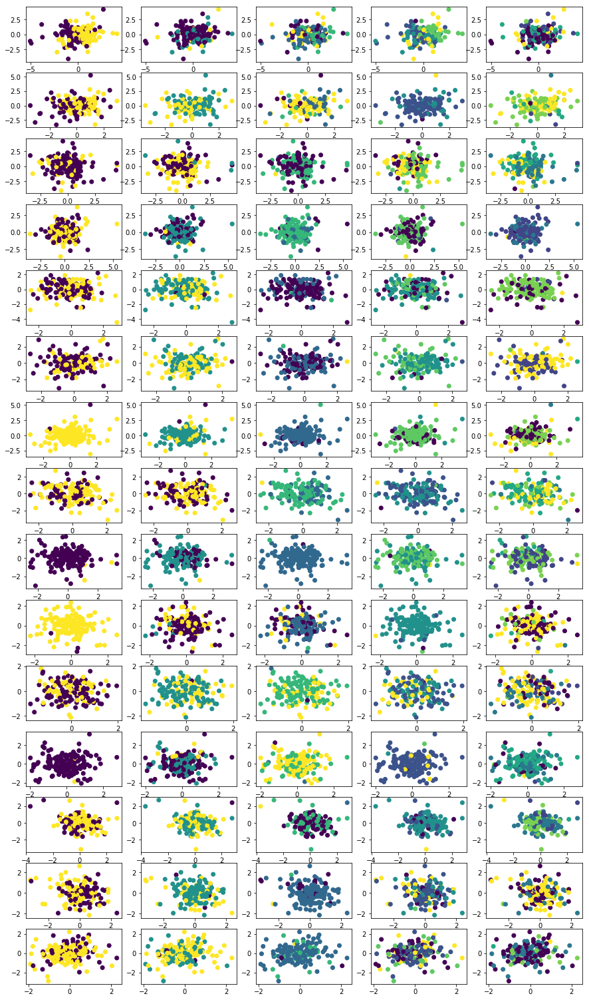

performing k=2,rep=11,umap neighbors=5,metric=cosine
performing k=3,rep=11,umap neighbors=5,metric=cosine
performing k=4,rep=11,umap neighbors=5,metric=cosine
performing k=5,rep=11,umap neighbors=5,metric=cosine
performing k=6,rep=11,umap neighbors=5,metric=cosine
performing k=2,rep=11,umap neighbors=5,metric=euclidean
performing k=3,rep=11,umap neighbors=5,metric=euclidean
performing k=4,rep=11,umap neighbors=5,metric=euclidean
performing k=5,rep=11,umap neighbors=5,metric=euclidean
performing k=6,rep=11,umap neighbors=5,metric=euclidean
performing k=2,rep=11,umap neighbors=5,metric=correlation
performing k=3,rep=11,umap neighbors=5,metric=correlation
performing k=4,rep=11,umap neighbors=5,metric=correlation
performing k=5,rep=11,umap neighbors=5,metric=correlation
performing k=6,rep=11,umap neighbors=5,metric=correlation
performing k=2,rep=11,umap neighbors=10,metric=cosine
performing k=3,rep=11,umap neighbors=10,metric=cosine
performing k=4,rep=11,umap neighbors=10,metric=cosine
per

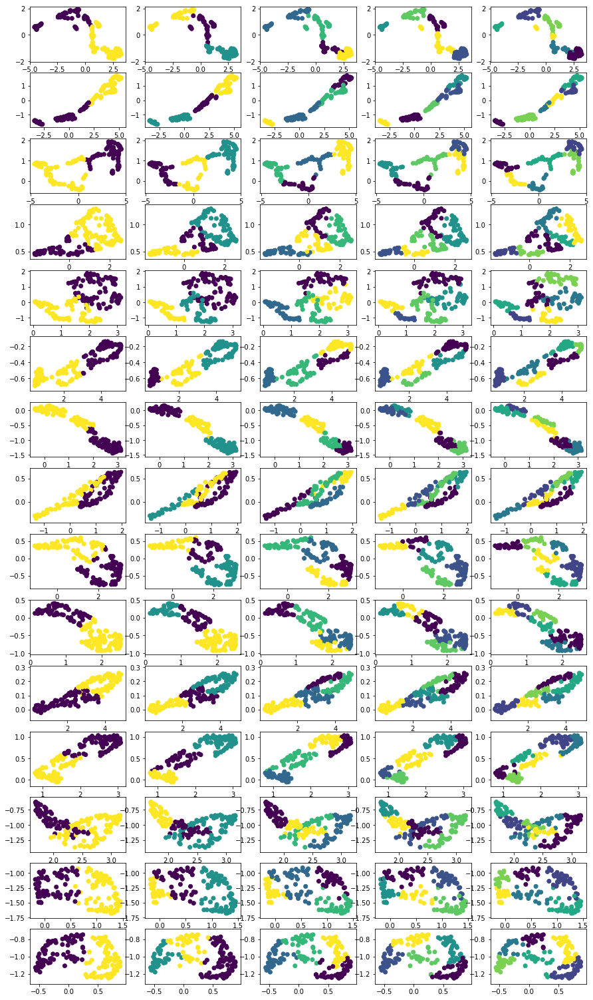

performing k=2,rep=12,tsne perplexity=10,metric=cosine
performing k=3,rep=12,tsne perplexity=10,metric=cosine
performing k=4,rep=12,tsne perplexity=10,metric=cosine
performing k=5,rep=12,tsne perplexity=10,metric=cosine
performing k=6,rep=12,tsne perplexity=10,metric=cosine
performing k=2,rep=12,tsne perplexity=10,metric=euclidean
performing k=3,rep=12,tsne perplexity=10,metric=euclidean
performing k=4,rep=12,tsne perplexity=10,metric=euclidean
performing k=5,rep=12,tsne perplexity=10,metric=euclidean
performing k=6,rep=12,tsne perplexity=10,metric=euclidean
performing k=2,rep=12,tsne perplexity=10,metric=correlation
performing k=3,rep=12,tsne perplexity=10,metric=correlation
performing k=4,rep=12,tsne perplexity=10,metric=correlation
performing k=5,rep=12,tsne perplexity=10,metric=correlation
performing k=6,rep=12,tsne perplexity=10,metric=correlation
performing k=2,rep=12,tsne perplexity=20,metric=cosine
performing k=3,rep=12,tsne perplexity=20,metric=cosine
performing k=4,rep=12,tsn

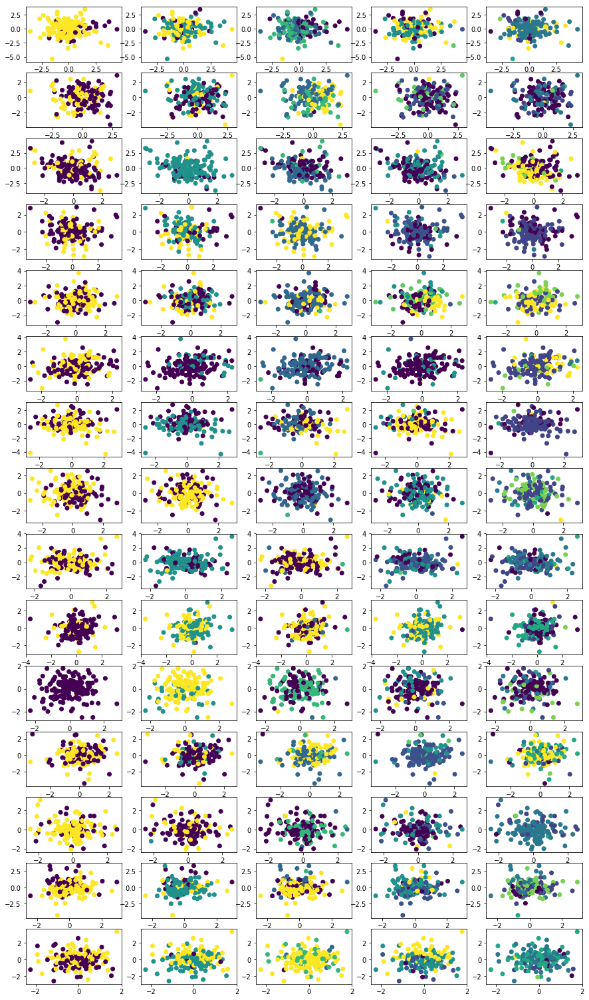

performing k=2,rep=12,umap neighbors=5,metric=cosine
performing k=3,rep=12,umap neighbors=5,metric=cosine
performing k=4,rep=12,umap neighbors=5,metric=cosine
performing k=5,rep=12,umap neighbors=5,metric=cosine
performing k=6,rep=12,umap neighbors=5,metric=cosine
performing k=2,rep=12,umap neighbors=5,metric=euclidean
performing k=3,rep=12,umap neighbors=5,metric=euclidean
performing k=4,rep=12,umap neighbors=5,metric=euclidean
performing k=5,rep=12,umap neighbors=5,metric=euclidean
performing k=6,rep=12,umap neighbors=5,metric=euclidean
performing k=2,rep=12,umap neighbors=5,metric=correlation
performing k=3,rep=12,umap neighbors=5,metric=correlation
performing k=4,rep=12,umap neighbors=5,metric=correlation
performing k=5,rep=12,umap neighbors=5,metric=correlation
performing k=6,rep=12,umap neighbors=5,metric=correlation
performing k=2,rep=12,umap neighbors=10,metric=cosine
performing k=3,rep=12,umap neighbors=10,metric=cosine
performing k=4,rep=12,umap neighbors=10,metric=cosine
per

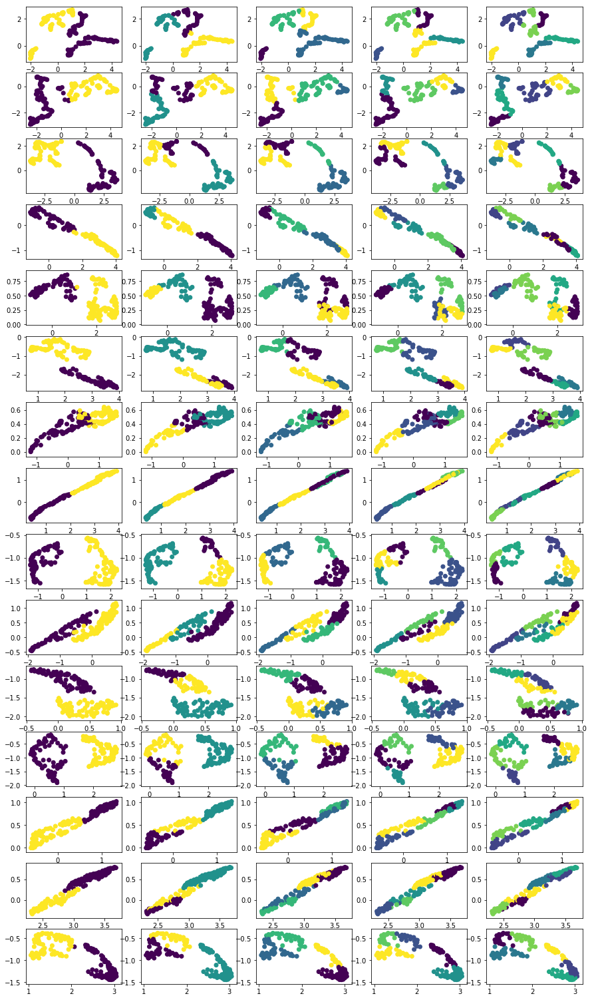

performing k=2,rep=13,tsne perplexity=10,metric=cosine
performing k=3,rep=13,tsne perplexity=10,metric=cosine
performing k=4,rep=13,tsne perplexity=10,metric=cosine
performing k=5,rep=13,tsne perplexity=10,metric=cosine
performing k=6,rep=13,tsne perplexity=10,metric=cosine
performing k=2,rep=13,tsne perplexity=10,metric=euclidean
performing k=3,rep=13,tsne perplexity=10,metric=euclidean
performing k=4,rep=13,tsne perplexity=10,metric=euclidean
performing k=5,rep=13,tsne perplexity=10,metric=euclidean
performing k=6,rep=13,tsne perplexity=10,metric=euclidean
performing k=2,rep=13,tsne perplexity=10,metric=correlation
performing k=3,rep=13,tsne perplexity=10,metric=correlation
performing k=4,rep=13,tsne perplexity=10,metric=correlation
performing k=5,rep=13,tsne perplexity=10,metric=correlation
performing k=6,rep=13,tsne perplexity=10,metric=correlation
performing k=2,rep=13,tsne perplexity=20,metric=cosine
performing k=3,rep=13,tsne perplexity=20,metric=cosine
performing k=4,rep=13,tsn

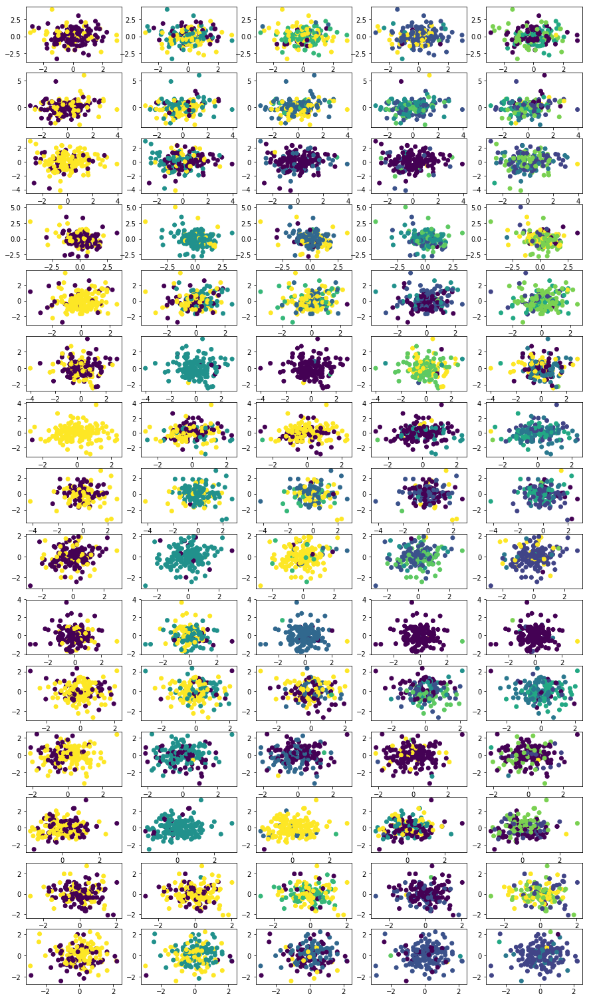

performing k=2,rep=13,umap neighbors=5,metric=cosine
performing k=3,rep=13,umap neighbors=5,metric=cosine
performing k=4,rep=13,umap neighbors=5,metric=cosine
performing k=5,rep=13,umap neighbors=5,metric=cosine
performing k=6,rep=13,umap neighbors=5,metric=cosine
performing k=2,rep=13,umap neighbors=5,metric=euclidean
performing k=3,rep=13,umap neighbors=5,metric=euclidean
performing k=4,rep=13,umap neighbors=5,metric=euclidean
performing k=5,rep=13,umap neighbors=5,metric=euclidean
performing k=6,rep=13,umap neighbors=5,metric=euclidean
performing k=2,rep=13,umap neighbors=5,metric=correlation
performing k=3,rep=13,umap neighbors=5,metric=correlation
performing k=4,rep=13,umap neighbors=5,metric=correlation
performing k=5,rep=13,umap neighbors=5,metric=correlation
performing k=6,rep=13,umap neighbors=5,metric=correlation
performing k=2,rep=13,umap neighbors=10,metric=cosine
performing k=3,rep=13,umap neighbors=10,metric=cosine
performing k=4,rep=13,umap neighbors=10,metric=cosine
per

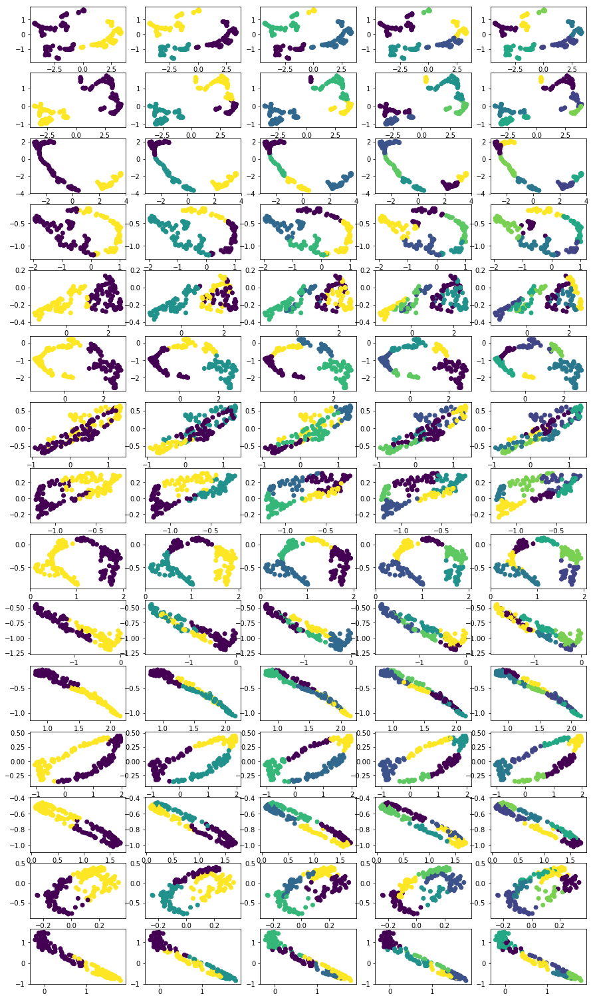

performing k=2,rep=14,tsne perplexity=10,metric=cosine
performing k=3,rep=14,tsne perplexity=10,metric=cosine
performing k=4,rep=14,tsne perplexity=10,metric=cosine
performing k=5,rep=14,tsne perplexity=10,metric=cosine
performing k=6,rep=14,tsne perplexity=10,metric=cosine
performing k=2,rep=14,tsne perplexity=10,metric=euclidean
performing k=3,rep=14,tsne perplexity=10,metric=euclidean
performing k=4,rep=14,tsne perplexity=10,metric=euclidean
performing k=5,rep=14,tsne perplexity=10,metric=euclidean
performing k=6,rep=14,tsne perplexity=10,metric=euclidean
performing k=2,rep=14,tsne perplexity=10,metric=correlation
performing k=3,rep=14,tsne perplexity=10,metric=correlation
performing k=4,rep=14,tsne perplexity=10,metric=correlation
performing k=5,rep=14,tsne perplexity=10,metric=correlation
performing k=6,rep=14,tsne perplexity=10,metric=correlation
performing k=2,rep=14,tsne perplexity=20,metric=cosine
performing k=3,rep=14,tsne perplexity=20,metric=cosine
performing k=4,rep=14,tsn

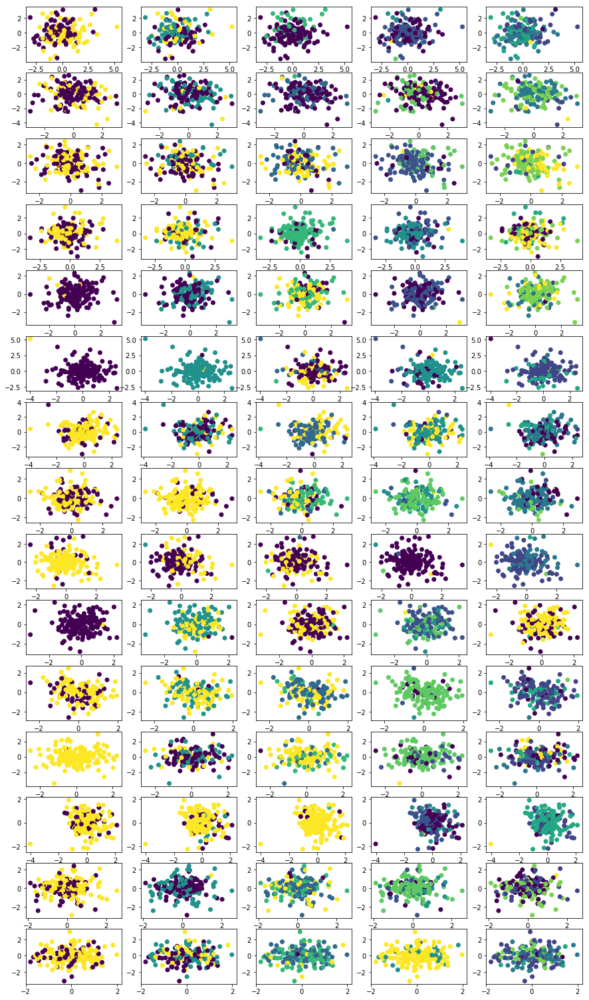

performing k=2,rep=14,umap neighbors=5,metric=cosine
performing k=3,rep=14,umap neighbors=5,metric=cosine
performing k=4,rep=14,umap neighbors=5,metric=cosine
performing k=5,rep=14,umap neighbors=5,metric=cosine
performing k=6,rep=14,umap neighbors=5,metric=cosine
performing k=2,rep=14,umap neighbors=5,metric=euclidean
performing k=3,rep=14,umap neighbors=5,metric=euclidean
performing k=4,rep=14,umap neighbors=5,metric=euclidean
performing k=5,rep=14,umap neighbors=5,metric=euclidean
performing k=6,rep=14,umap neighbors=5,metric=euclidean
performing k=2,rep=14,umap neighbors=5,metric=correlation
performing k=3,rep=14,umap neighbors=5,metric=correlation
performing k=4,rep=14,umap neighbors=5,metric=correlation
performing k=5,rep=14,umap neighbors=5,metric=correlation
performing k=6,rep=14,umap neighbors=5,metric=correlation
performing k=2,rep=14,umap neighbors=10,metric=cosine
performing k=3,rep=14,umap neighbors=10,metric=cosine
performing k=4,rep=14,umap neighbors=10,metric=cosine
per

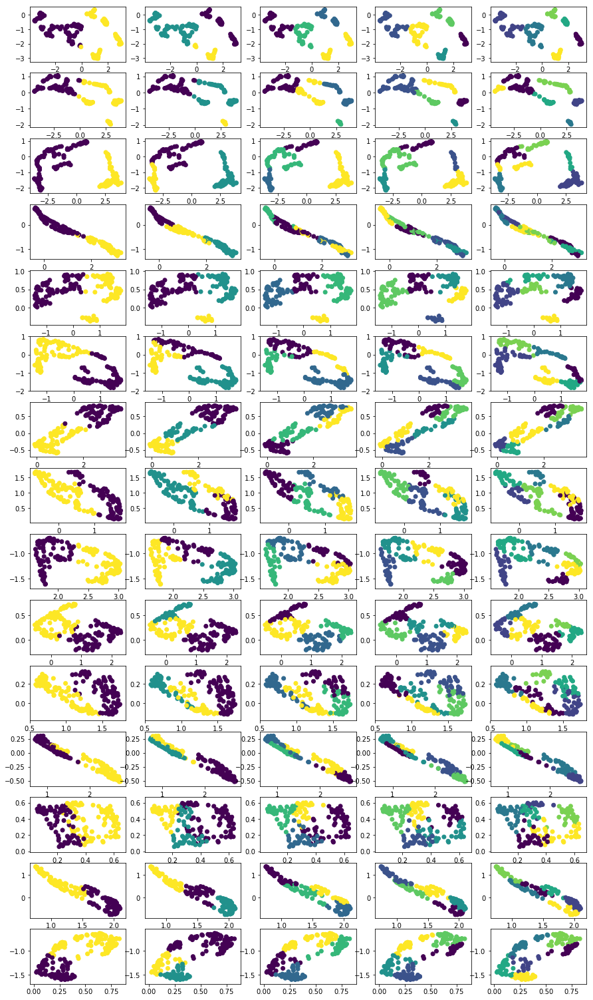

In [57]:
# step 2:每个representation 跑tsne／umap，用cosine，encildean，corr，和3个不同的参数
import umap
embed_dim = 100
tsne_perplexity_list = [10,20,30,40,50]
umap_neighbor_list = [5,10,15,20,30]
metric_list = ['cosine','euclidean','correlation']
k_list = [2,3,4,5,6]
# k_list = [2]
CM_list = [np.zeros(shape=(num_cells,num_cells))]*len(k_list)
times = 1

for n_time in range(times):
#     cur_CM = np.zeros(shape=(num_cells,num_cells))
    rep_count = -1
    for rep in softmax_representation_list:
        rep_count += 1
        plot_count = 0
#         先是tsne
        fig = plt.figure(figsize=(15,27))
        for p in tsne_perplexity_list:
        
            for m in metric_list:
                cur_embed = TSNE(n_components=embed_dim,metric=m,perplexity=p,verbose=False,method='exact').fit_transform(rep)
                for k in k_list:
                    print('performing k={k},rep={rep_count},tsne perplexity={p},metric={m}'.format(k=k,rep_count=rep_count,p=p,m=m))
                    
                    plot_count += 1
#                     cur_label = SpectralClustering(n_clusters=k).fit_predict(cur_embed)
                    
                    cur_label = KMeans(n_clusters=k,init='k-means++').fit_predict(cur_embed)
                
#                 展示tsne的结果
                
                    plt.subplot(len(tsne_perplexity_list)*len(metric_list),len(k_list),plot_count)
                    plt.scatter(cur_embed[:,0],cur_embed[:,1],c=cur_label)
                    CM_list[k-2] = CM_list[k-2] + label2CM(cur_label)
        plt.show()
        plot_count = 0
#         再是umap
        fig = plt.figure(figsize=(15,27))
        for p in umap_neighbor_list:
        
            for m in metric_list:
                
                cur_embed = umap.UMAP(n_components=embed_dim,metric=m,n_neighbors=p,verbose=False).fit_transform(rep)
                for k in k_list:
                    print('performing k={k},rep={rep_count},umap neighbors={p},metric={m}'.format(k=k,rep_count=rep_count,p=p,m=m))
                    plot_count += 1
                    
#                     cur_label = SpectralClustering(n_clusters=k).fit_predict(cur_embed)
                    cur_label = KMeans(n_clusters=k,init='k-means++').fit_predict(cur_embed)

#                 展示umap的结果
                    plt.subplot(len(umap_neighbor_list)*len(metric_list),len(k_list),plot_count)

                    plt.scatter(cur_embed[:,0],cur_embed[:,1],c=cur_label)
                    CM_list[k-2] = CM_list[k-2] + label2CM(cur_label)
        
        plt.show()
        
    

In [43]:
cur_embed = umap.UMAP(n_components=embed_dim,metric=m,n_neighbors=p,verbose=False).fit_transform(rep)

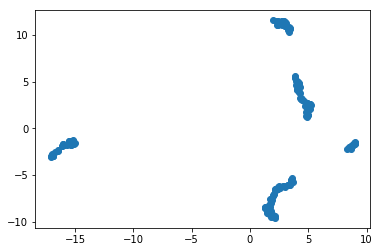

In [693]:
CM = CM_list[4]/np.max(CM_list[0])
# consensus_label = SpectralClustering(n_clusters=3,affinity='precomputed').fit_predict(CM)
# ARI = metrics.adjusted_rand_score(consensus_label, true_y)
# ARI
consensus_embed = umap.UMAP(n_components=2,metric='precomputed',n_neighbors=20).fit_transform(1-CM)
plt.scatter(consensus_embed[:,0],consensus_embed[:,1])
plt.show()

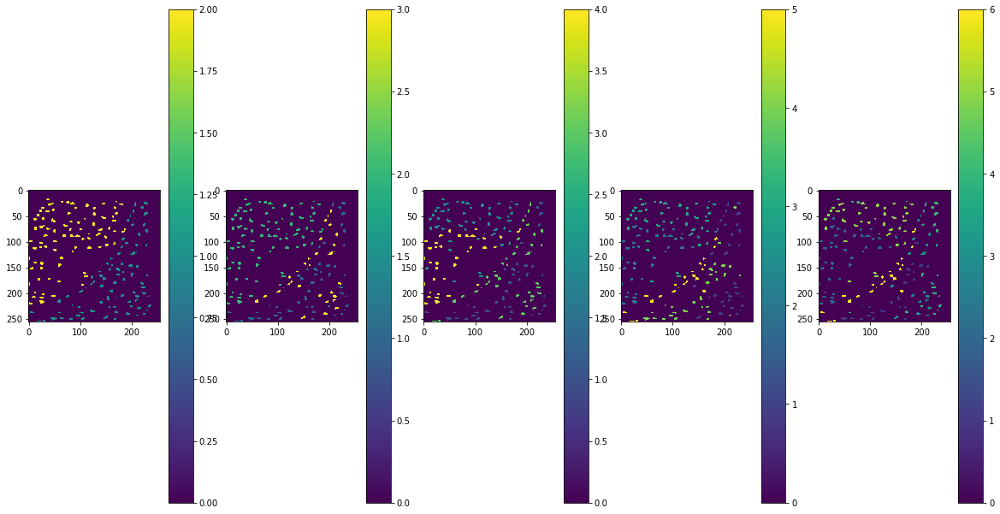

In [94]:
fig_width = 20
fig = plt.figure(figsize=(fig_width,fig_width*len(label_list)))
for i in range(len(label_list)):
    cur_labeling = get_labeling(label_list[i],cell_idx)

    img = cur_labeling.reshape((256,256))
    plt.subplot(1,len(label_list),i+1)
    plt.imshow(img)
    plt.colorbar()
    
plt.show()

In [96]:
img

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       ..., 
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0.,  0.]])

In [101]:
mean_br_list = []
for i in range(num_cells):
    ith_cell_idx = (cell_dict[7]==i+1)
    ith_cell_pos = pos_dict[7][ith_cell_idx]-1
    mean_br_list.append(np.mean(br_sample[ith_cell_pos][:]))
mean_br_list = np.array(mean_br_list)

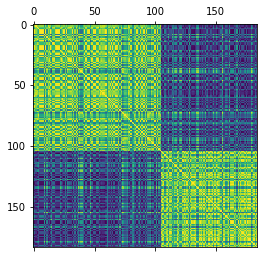

In [23]:
CM = CM_list[0]
CM = CM/np.max(CM)
consensus_label = SpectralClustering(n_clusters=2,affinity='precomputed').fit_predict(CM)
label_sort = np.argsort(consensus_label)
plt.matshow(CM[:,label_sort][label_sort,:])
plt.show()

In [24]:
cluster1 = mean_br_list[consensus_label==0]
cluster2 = mean_br_list[consensus_label==1]
# cluster3 = mean_br_list[consensus_label==2]
cluster1

array([  1.33333333,  23.55      ,  19.36842105,   2.36363636,
         6.        ,   0.72222222,  25.94444444,   6.05555556,
        33.17391304,  44.26086957,   0.875     ,   1.16666667,
         7.08333333,   1.11111111,   0.88888889,  20.13043478,
         4.5       ,   1.5       ,   1.44444444,  15.        ,
         1.75      ,   4.17391304,  33.91666667,  24.70689655,
        38.96      ,  40.        ,  36.69565217,  26.53333333,
         1.71428571,  16.72222222,   3.42307692,   4.68421053,
        18.05      ,   7.59259259,  40.89473684,   1.38888889,
         1.61111111,  20.73684211,   0.96666667,   2.91304348,
         1.36842105,   1.33333333,   3.8       ,  19.875     ,
         1.44444444,   1.26666667,  41.26086957,  36.31818182,
        16.66666667,   4.        ,  25.52380952,  14.6122449 ,
        17.83333333,  26.37931034,   7.21052632,   1.05555556,
         1.5       ,  46.05555556,  30.26086957,   4.05263158,
         1.72222222,  12.94444444,   1.28571429,   1.36

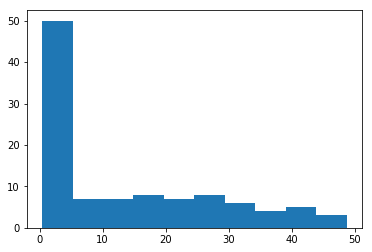

In [26]:
plt.hist(cluster1)
plt.show()

In [ ]:
CM_list[0][0,0]

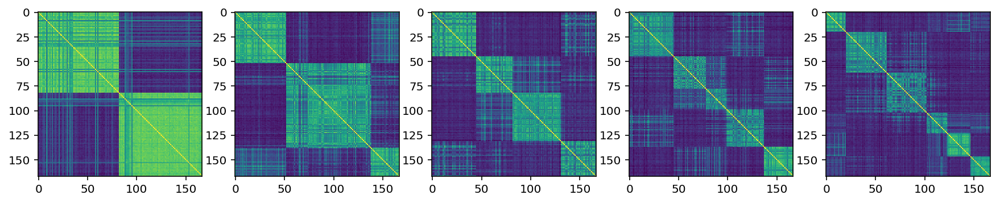

In [116]:
# n_cluster_li = [2,3,4,5,6]
# # fig = plt.figure(figsize=(5,25))
# for CM in CM_list:
#     CM = CM/np.max(CM)
#     fig = plt.figure(figsize=(15,75))
    
#     for n_cluster in n_cluster_li:
#         consensus_label = SpectralClustering(n_clusters=n_cluster,affinity='precomputed').fit_predict(CM)
#         label_sort = np.argsort(consensus_label)
#         plt.subplot(1,5,n_cluster-1)
#         plt.imshow(CM[:,label_sort][label_sort,:])
# #     plt.hist(CM[:])
#     plt.show()
n_cluster_li = [2,3,4,5,6]
fig = plt.figure(figsize=(15,75))
label_list = []
# fig = plt.figure(figsize=(5,25))
for i in range(len(CM_list)):
    CM = CM_list[i]
    CM = CM/np.max(CM)
    
    
    consensus_label = SpectralClustering(n_clusters=i+2,affinity='precomputed').fit_predict(CM)
    label_list.append(consensus_label)
    label_sort = np.argsort(consensus_label)
    plt.subplot(1,5,i+1)
    plt.imshow(CM[:,label_sort][label_sort,:])
#     plt.hist(CM[:])
plt.show()

In [ ]:
1+1

In [ ]:
# Authors: Mathew Kallada
# License: BSD 3 clause
"""
=========================================
Plot Hierarachical Clustering Dendrogram 
=========================================
This example plots the corresponding dendrogram of a hierarchical clustering
using AgglomerativeClustering and the dendrogram method available in scipy.
"""

import numpy as np

from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import dendrogram
from sklearn.datasets import load_iris
from sklearn.cluster import AgglomerativeClustering

def plot_dendrogram(model, **kwargs):

    # Children of hierarchical clustering
    children = model.children_

    # Distances between each pair of children
    # Since we don't have this information, we can use a uniform one for plotting
    distance = np.arange(children.shape[0])

    # The number of observations contained in each cluster level
    no_of_observations = np.arange(2, children.shape[0]+2)

    # Create linkage matrix and then plot the dendrogram
    linkage_matrix = np.column_stack([children, distance, no_of_observations]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

CM = CM_list[2]
CM = CM/np.max(CM)
    
iris = load_iris()
x = iris.data[:20]
model = AgglomerativeClustering(n_clusters=3,affinity='precomputed',linkage='complete')

model = model.fit(1-CM)
plt.title('Hierarchical Clustering Dendrogram')
plot_dendrogram(model, labels=model.labels_)
plt.show()

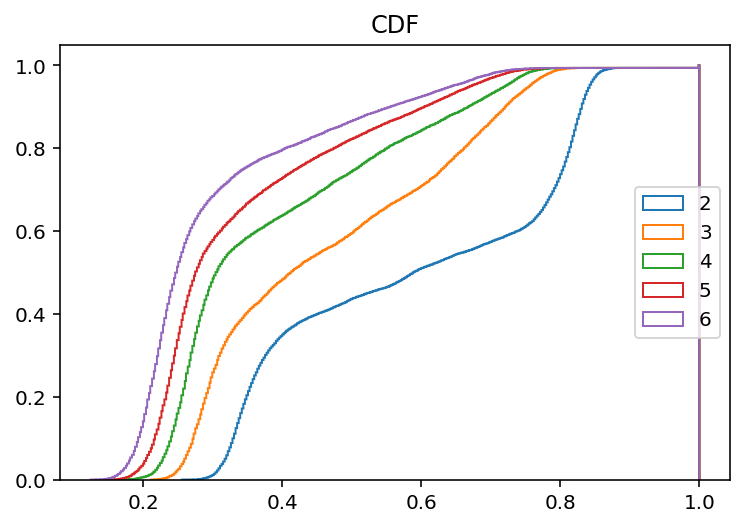

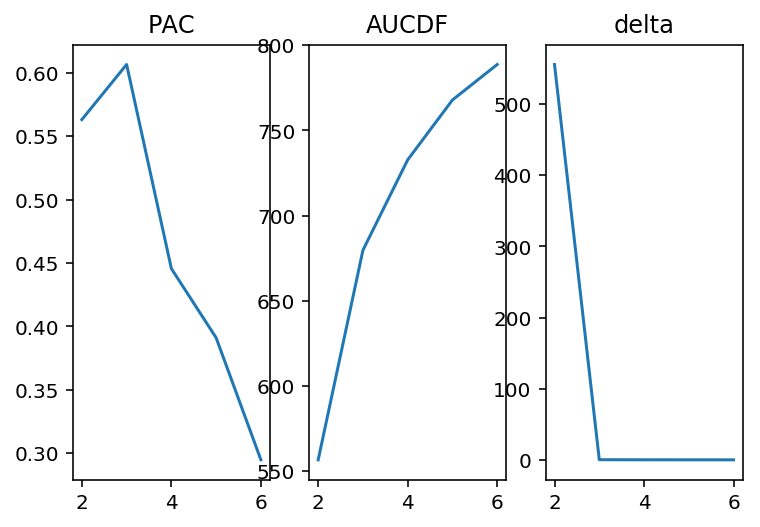

In [117]:
PAC_list = []
AUCDF_list = []
delta_list = []
prev_AUCDF = 1
a = 0.3
fig = plt.figure()
for i in range(len(CM_list)):
    CM = CM_list[i]
    CM = CM/CM[0,0]

    CM_flatten = CM.flatten()
    n_bins = 1000
#     plt.subplot(1,len(CM_list),i+1)
    n, bins, patches = plt.hist(CM_flatten, n_bins, histtype='step',cumulative=True, label=str(i+2),normed=True)
    bins = bins[0:-1]
    cur_PAC = n[bins>=1-a][0]-n[bins>=a][0]
    cur_AUCDF = np.sum(n)
    PAC_list.append(cur_PAC)
    AUCDF_list.append(cur_AUCDF)
    delta_list.append((cur_AUCDF-prev_AUCDF)/prev_AUCDF)
    prev_AUCDF = cur_AUCDF
    
plt.legend(loc='right')
plt.title('CDF')
plt.show()
plt.subplot(1,3,1)
plt.plot(np.arange(len(CM_list))+2,np.array(PAC_list))
plt.title('PAC')
plt.subplot(1,3,2)
plt.plot(np.arange(len(CM_list))+2,np.array(AUCDF_list))
plt.title('AUCDF')

plt.subplot(1,3,3)
plt.plot(np.arange(len(CM_list))+2,np.array(delta_list))
plt.title('delta')

plt.show()

In [72]:
from scipy.stats import wasserstein_distance

cell_pixel_dict = {}
pixel_count = []
for i in range(num_cells):
    cur_pixels = train_x[cell_idx==i+1,:]
    cell_pixel_dict[i] = cur_pixels
    pixel_count.append(cur_pixels.shape[0])

dist_mat = np.zeros(shape=(num_features,num_cells,num_cells))
for k in range(num_features):
    print(k)
    
    for i in range(num_cells):
        for j in range(num_cells):
            cur_dist = wasserstein_distance(cell_pixel_dict[i][:,k],cell_pixel_dict[j][:,k])
            dist_mat[k,i,j] = cur_dist



0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [71]:
train_x.shape

(4079, 286)

In [79]:
# 给定label，计算wbratio的matrix，找差异物质
wbr_mat_list = np.zeros(shape=(num_features,n_label,n_label))
label = label_list[2]
n_label = np.unique(label).shape[0]
for i in range(num_features):
    cur_dist_mat = dist_mat[i,:,:]
    cur_wbr_mat = np.zeros(shape=(n_label,n_label))
    for j in range(n_label):
        for k in range(n_label):
            within_sum_j = np.sum(dist_mat[i,:,:][label==j,:][:,label==j])
            within_sum_k = np.sum(dist_mat[i,:,:][label==k,:][:,label==k])
            between_sum_1 = np.sum(dist_mat[i,:,:][label==j,:][:,label==k])
            between_sum_2 = np.sum(dist_mat[i,:,:][label==k,:][:,label==j])
            cur_wbr_mat[j,k] = (within_sum_j+within_sum_k)/(between_sum_1+between_sum_2)
    wbr_mat_list[i,:,:] = cur_wbr_mat

0 1 219


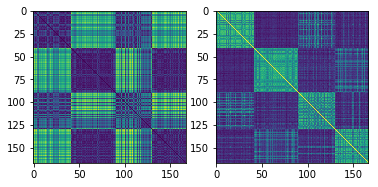

0 2 25


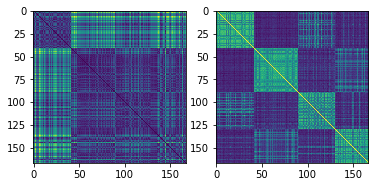

0 3 219


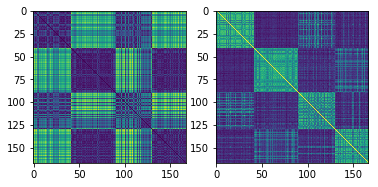

1 2 190


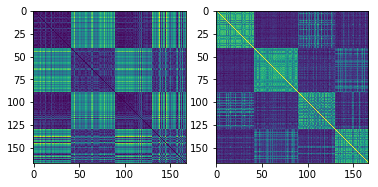

1 3 66


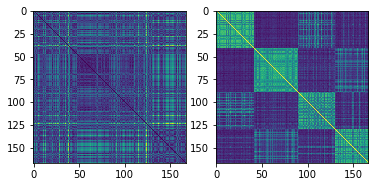

2 3 206


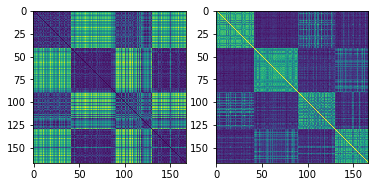

In [101]:
sorted_label_idx = np.argsort(label)

for i in range(n_label):
    for j in range(i+1,n_label):
        
        cur_diff_matter_idx = np.argmin(wbr_mat_list[:,i,j])
        print(i,j,cur_diff_matter_idx+2)
        plt.subplot(1,2,1)
        plt.imshow(dist_mat[cur_diff_matter_idx,:,:][sorted_label_idx,:][:,sorted_label_idx])
        plt.subplot(1,2,2)
        plt.imshow(CM_list[2][sorted_label_idx,:][:,sorted_label_idx])
        plt.show()

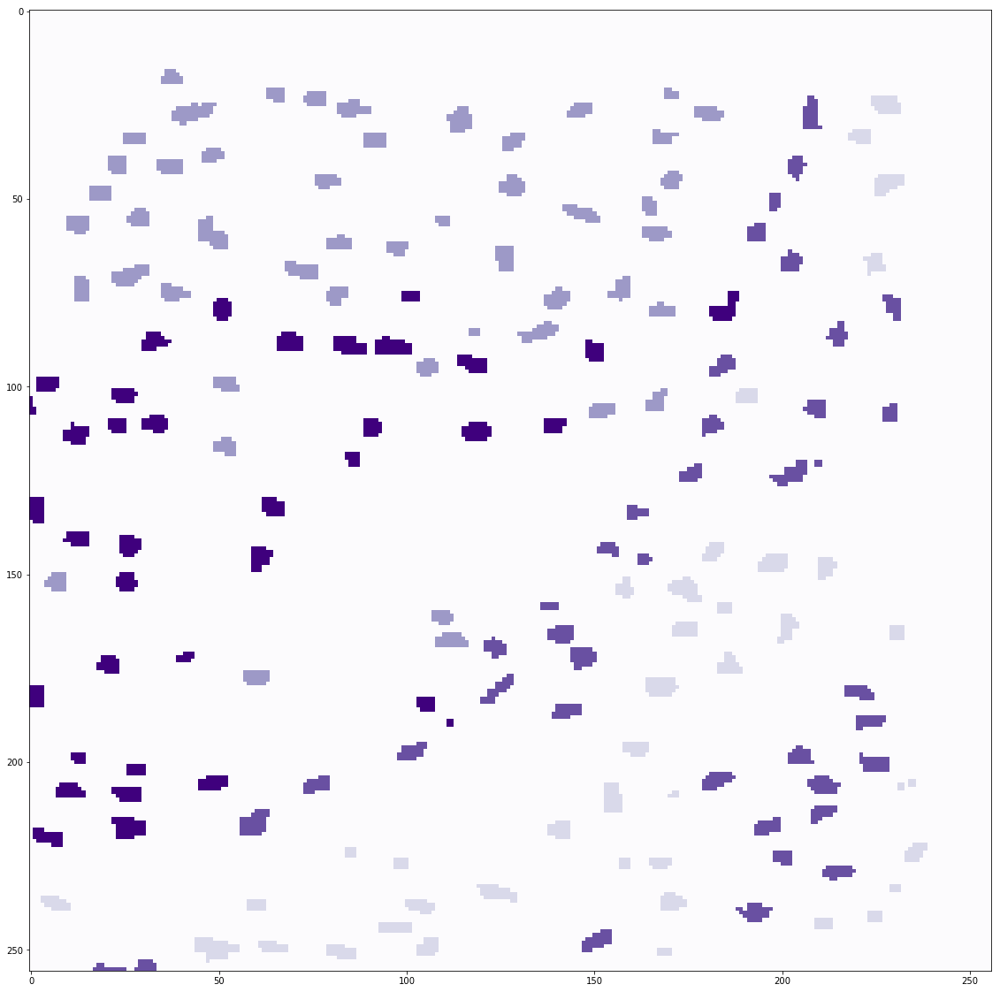

In [107]:
batch_num = 3
idx_func = np.vectorize(ind2ij)
cell_median_list = []
for i in range(num_cells):
    cur_cell_pos = pos_dict[batch_num][cell_dict[batch_num]==i+1]
    median_i = int(np.median(idx_func(cur_cell_pos,256,0)))
    median_j = int(np.median(idx_func(cur_cell_pos,256,1)))
    cell_median_list.append([median_i,median_j])
cell_median_list = np.array(cell_median_list)-1

matter_mean_list = []
target_matter = br_sample
for i in range(num_cells):
    cur_cell_intensity = np.mean(target_matter[cell_dict[batch_num]==i+1])
    matter_mean_list.append(cur_cell_intensity)
matter_mean_list = np.array(matter_mean_list)


labeled_img = get_labeling(label,cell_idx)
labeled_img = labeled_img.reshape((256,256))
fig = plt.figure(figsize=(20,20))
plt.imshow(labeled_img,cmap='Purples')
plt.show()

In [106]:
labeled_img.

array([[ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       ..., 
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.],
       [ 1.,  1.,  1., ...,  1.,  1.,  1.]])

In [645]:
ARI = metrics.adjusted_rand_score(consensus_label, true_y)
ARI

0.0239225689909803

In [464]:
epoch_lidu = 10
logit_model = Model(SIMS_input,d4)
t = 50
softmax_list = []
for i in range(20):
    softmax_model.fit([train_x,cell_idx-1],[onehot_label,np.ones(shape=cell_idx.shape)],epochs=epoch_lidu,shuffle=True,batch_size=128)
    pred_logit = logit_model.predict(train_x)

    pred_t_softmax = np.exp(pred_logit/t)
    pred_t_softmax = pred_t_softmax/np.sum(pred_t_softmax,axis=1,keepdims=True)
    softmax_list.append(pred_t_softmax)

Epoch 1/10
4860/4860 [==============================] - 0s 52us/step - loss: 8.9121e-05 - softmax_loss: 8.9121e-05 - center_loss: 19173.9465
Epoch 2/10
4860/4860 [==============================] - 0s 49us/step - loss: 8.6945e-05 - softmax_loss: 8.6945e-05 - center_loss: 19232.1465
Epoch 3/10
4860/4860 [==============================] - 0s 47us/step - loss: 8.5019e-05 - softmax_loss: 8.5019e-05 - center_loss: 19287.5760
Epoch 4/10
4860/4860 [==============================] - 0s 45us/step - loss: 8.3036e-05 - softmax_loss: 8.3036e-05 - center_loss: 19341.9125
Epoch 5/10
4860/4860 [==============================] - 0s 50us/step - loss: 8.1115e-05 - softmax_loss: 8.1115e-05 - center_loss: 19398.6356
Epoch 6/10
4860/4860 [==============================] - 0s 52us/step - loss: 7.9291e-05 - softmax_loss: 7.9291e-05 - center_loss: 19455.4464
Epoch 7/10
4860/4860 [==============================] - 0s 51us/step - loss: 7.7422e-05 - softmax_loss: 7.7422e-05 - center_loss: 19509.3208
Epoch 8/10
48

KeyboardInterrupt: 

In [613]:
from scipy.stats import *
mode = 1
corr_li = []
prev_softmax = softmax_representation_list[0]
for i in range(len(softmax_representation_list)):
    cur_softmax = softmax_representation_list[i]
    if mode==0:
#         只算第一个pixel的
        cur_corr = pearsonr(cur_softmax[:,0],prev_softmax[:,0])[0]
    else:
        cur_corr = 0
        for j in range(cur_softmax.shape[1]):
            cur_corr += pearsonr(cur_softmax[:,j],prev_softmax[:,j])[0]
    corr_li.append(cur_corr)
    
    prev_softmax = cur_softmax

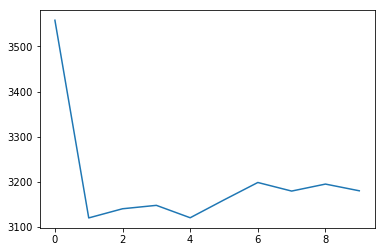

In [614]:
plt.plot(corr_li)
plt.show()

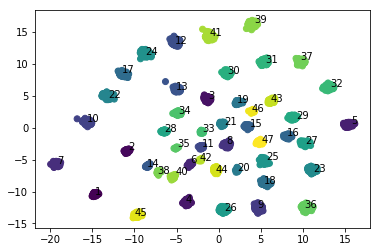

In [6]:
from sklearn.manifold import TSNE
d2_model = Model(SIMS_input,d2)
d2_embed = d2_model.predict(train_x)
# d2_embed = TSNE(n_components=2).fit_transform(d2_embed)
plt.scatter(d2_embed[:,0],d2_embed[:,1],c=cell_idx)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(d2_embed[cell_idx==cur_idx,0][0],d2_embed[cell_idx==cur_idx,1][0]))
plt.show()

In [420]:
1+1

2

In [390]:
np.sort(rst[0][cell_idx==1],axis=1)[:,-2:]

array([[ 0.07017526,  0.80911887],
       [ 0.09809101,  0.8375048 ],
       [ 0.10221273,  0.81865972],
       [ 0.07223142,  0.84011436],
       [ 0.09327089,  0.8343007 ],
       [ 0.07043531,  0.84474868],
       [ 0.08285746,  0.80110276],
       [ 0.10337841,  0.82085067],
       [ 0.07907009,  0.82339513],
       [ 0.07257847,  0.80017787],
       [ 0.07212602,  0.82193202],
       [ 0.07617796,  0.82799333],
       [ 0.06596588,  0.81844509],
       [ 0.07133505,  0.82186723],
       [ 0.08668821,  0.81812835],
       [ 0.0727281 ,  0.84292132],
       [ 0.08136056,  0.82648784],
       [ 0.08909424,  0.79044038],
       [ 0.06746928,  0.83394235],
       [ 0.06736208,  0.84294003],
       [ 0.09639509,  0.83489263],
       [ 0.07327277,  0.80000323],
       [ 0.11550913,  0.82336831],
       [ 0.06790963,  0.82823062],
       [ 0.09365598,  0.79207581],
       [ 0.09324503,  0.8208878 ],
       [ 0.06905672,  0.83611292],
       [ 0.13204347,  0.73655522],
       [ 0.06973827,

In [397]:
pixel_count_list = [0]*num_cells
for i in cell_idx:
    pixel_count_list[i-1] += 1

In [410]:
import operator
x = {(1,2): 2, (3,4): 4, (4,5): 3, (2,1): 1, (0,0): 0}
sorted_x = sorted(x.items(), key=operator.itemgetter(1))
[i,j]=sorted_x[-1][0]
print(i,j)

3 4


In [406]:
x.items()

dict_items([(1, 2), (3, 4), (4, 3), (2, 1), (0, 0)])

11 and 23 merged


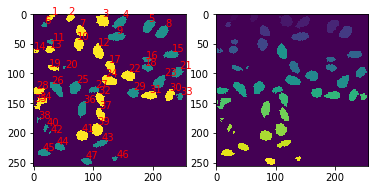

23 and 40 merged


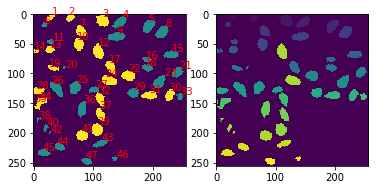

16 and 40 merged


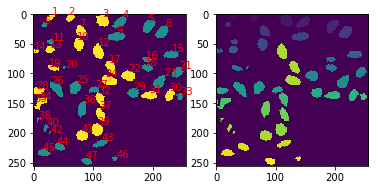

30 and 40 merged


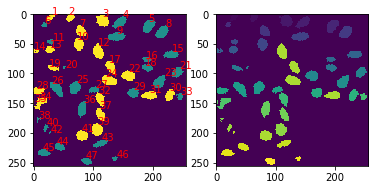

29 and 40 merged


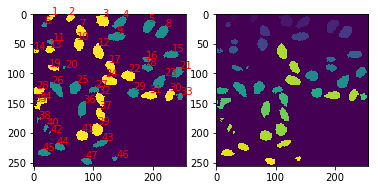

2 and 40 merged


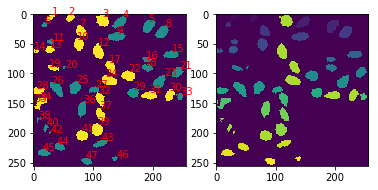

21 and 40 merged


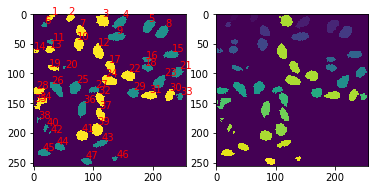

38 and 40 merged


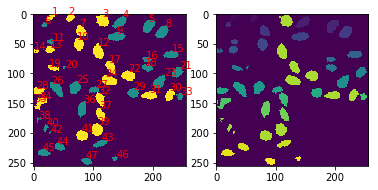

31 and 40 merged


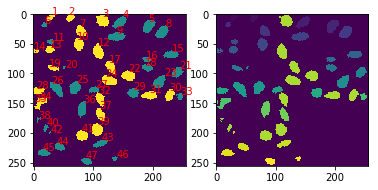

12 and 40 merged


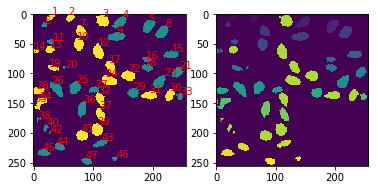

18 and 40 merged


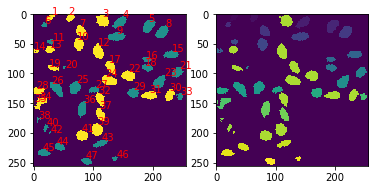

36 and 40 merged


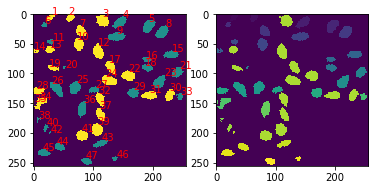

40 and 45 merged


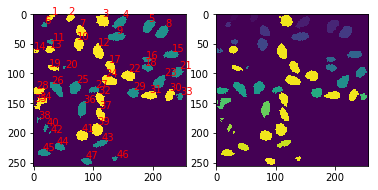

15 and 45 merged


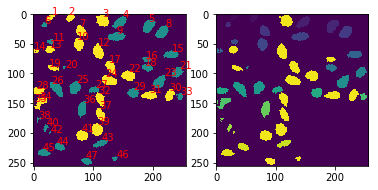

4 and 45 merged


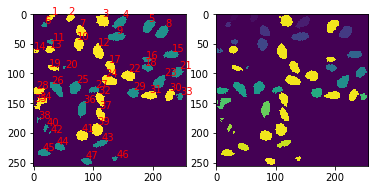

42 and 45 merged


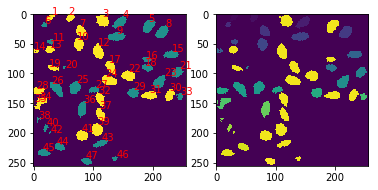

24 and 45 merged


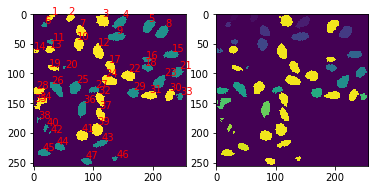

26 and 45 merged


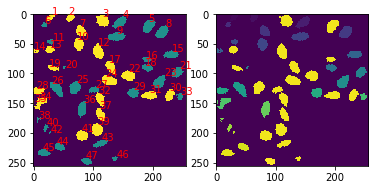

10 and 45 merged


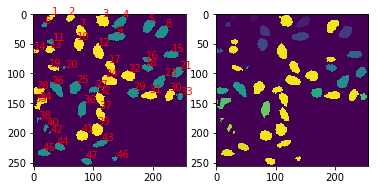

45 and 46 merged


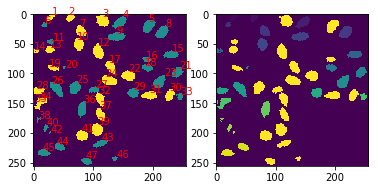

17 and 46 merged


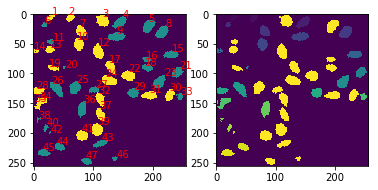

19 and 46 merged


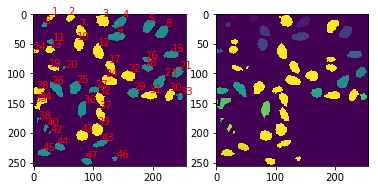

14 and 46 merged


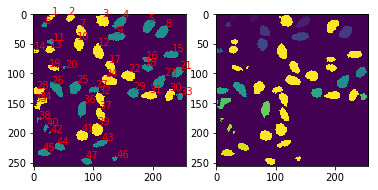

22 and 46 merged


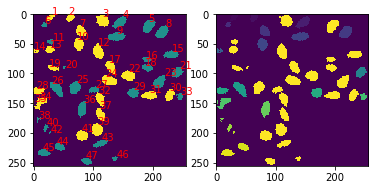

25 and 46 merged


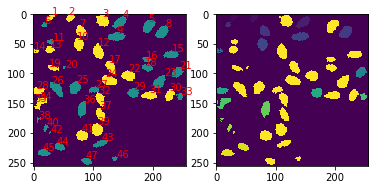

KeyboardInterrupt: 

In [415]:
import operator

cur_num_classes = num_cells
removed_class_idx = []
cur_label = cell_idx-1
center_model = Model(target_input,centerloss_embed_layer)
merge_path = []
pixel_count_list = [0]*num_cells
for i in cell_idx:
    pixel_count_list[i-1] += 1
while(len(removed_class_idx)!=num_cells-1):
    
    onehot_label = keras.utils.to_categorical(cur_label,num_cells)
    
    history=softmax_model.fit([train_x,cur_label],[onehot_label,np.ones(shape=cell_idx.shape)],epochs=20,shuffle=True,batch_size=64,verbose=False)
    softmax_output=softmax_model.predict([train_x,cell_idx-1])[0]
    softmax_output[:,removed_class_idx] = 0
    vote_pair = np.argsort(softmax_output,axis=1)[:,-2:]
    pair_weight_dict = {}
    for i in range(cell_idx.shape[0]):
        cur_pair = tuple(np.sort(vote_pair[i,:]))
        cur_cellidx = cell_idx[i]-1
        cur_weight = pixel_count_list[cur_cellidx]
        if pair_weight_dict.get(cur_pair) is None:
            pair_weight_dict[cur_pair] = cur_weight
        else:
            pair_weight_dict[cur_pair] += cur_weight
    sorted_dict = sorted(pair_weight_dict.items(), key=operator.itemgetter(1))
    [merge_i,merge_j] = sorted_dict[-1][0]
    
    cur_label[cur_label==merge_i] = merge_j
    removed_class_idx.append(merge_i)
    
    merge_path.append((merge_i,merge_j))
    print(str(merge_i)+' and '+str(merge_j)+' merged')
    
    cur_labeling = np.zeros(shape=(65536,))
    cur_labeling[cell_pos] = cur_label+1
    cur_img = cur_labeling.reshape((256,256))
    plt.subplot(1,2,2)
    
    plt.imshow(cur_img)
    # img = np.transpose(img)
    true_labeling = label_dict[batch_num][np.argsort(pos_dict[batch_num])]
    true_img = true_labeling.reshape((256,256))
    plt.subplot(1,2,1)

    plt.imshow(true_img)
    for i in range(num_cells):
        cur_idx = i + 1
        cur_ind = cell_pos[cell_idx==cur_idx][0]
    #     print(ind2ij(cur_ind,256,0))
    #     print(ind2ij(cur_ind,256,1))

        plt.annotate(str(cur_idx),(ind2ij(cur_ind,256,1),ind2ij(cur_ind,256,0)),color='red')

    
#     break
    plt.show()

16 and 152 merged


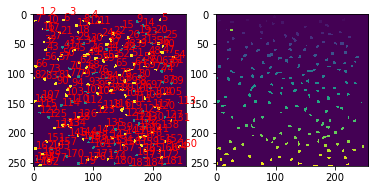

67 and 120 merged


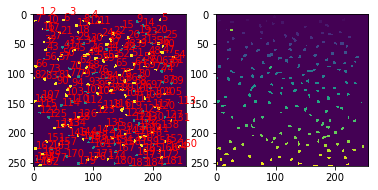

95 and 127 merged


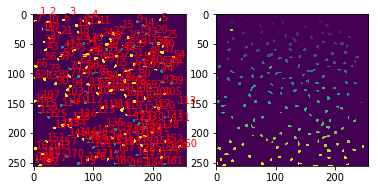

47 and 76 merged


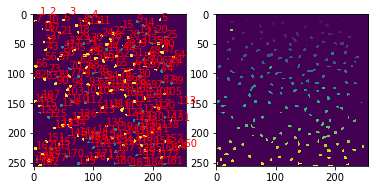

1 and 10 merged


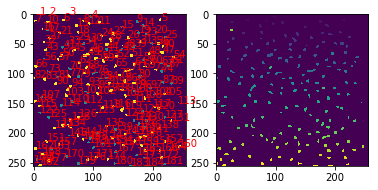

6 and 10 merged


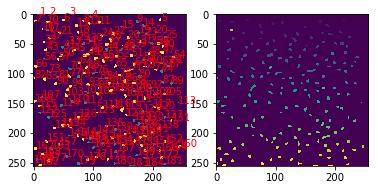

112 and 155 merged


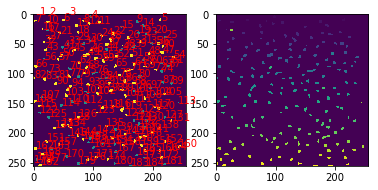

42 and 105 merged


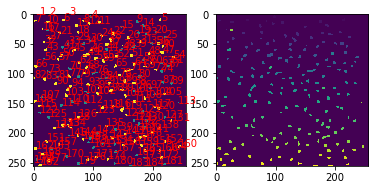

35 and 164 merged


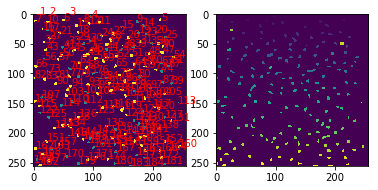

19 and 158 merged


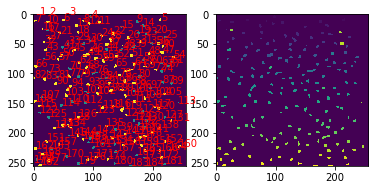

38 and 178 merged


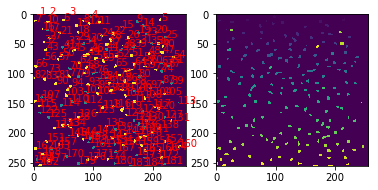

102 and 141 merged


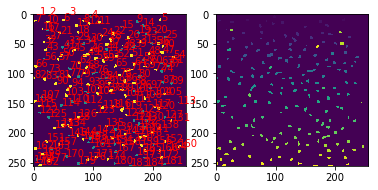

18 and 24 merged


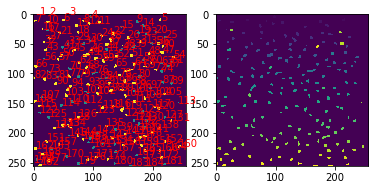

56 and 127 merged


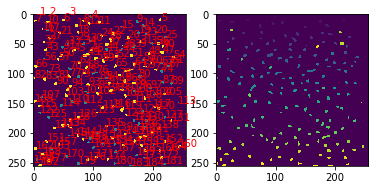

49 and 174 merged


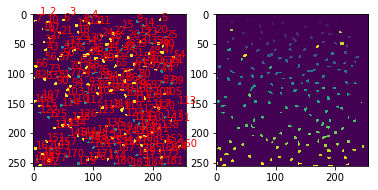

111 and 150 merged


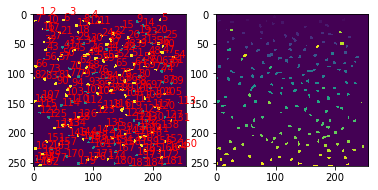

10 and 23 merged


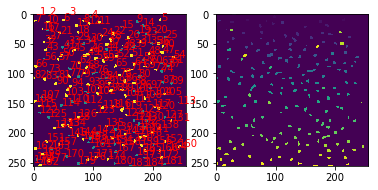

52 and 113 merged


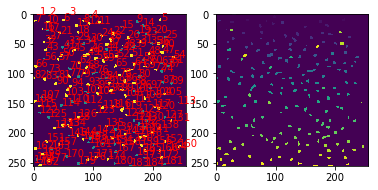

26 and 154 merged


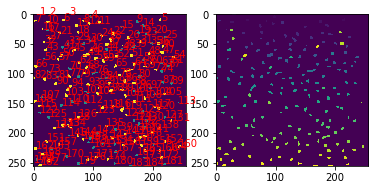

22 and 127 merged


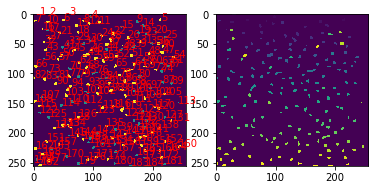

108 and 171 merged


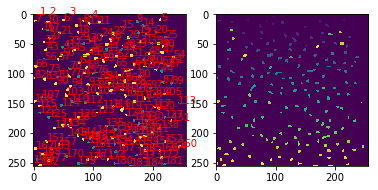

66 and 156 merged


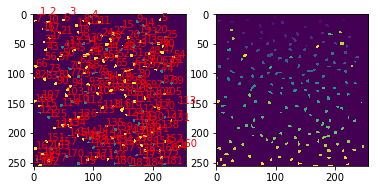

33 and 91 merged


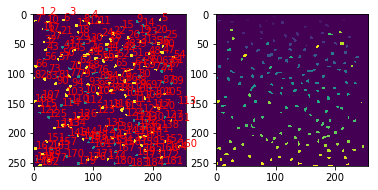

88 and 125 merged


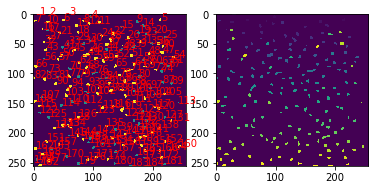

127 and 180 merged


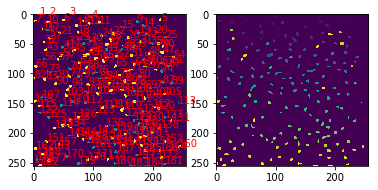

51 and 183 merged


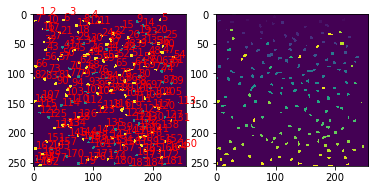

114 and 119 merged


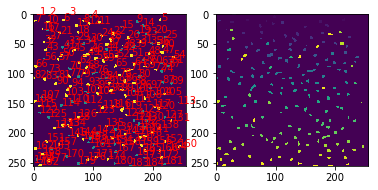

32 and 40 merged


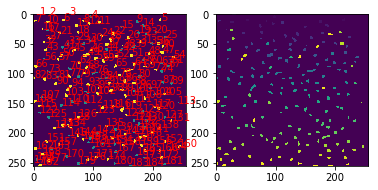

15 and 34 merged


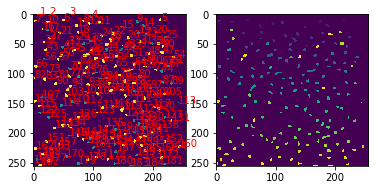

86 and 172 merged


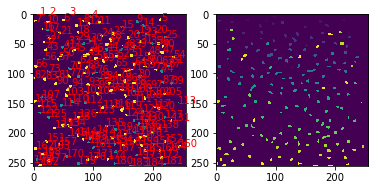

45 and 175 merged


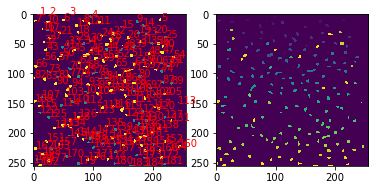

14 and 117 merged


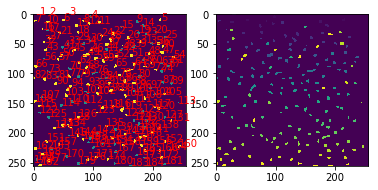

9 and 120 merged


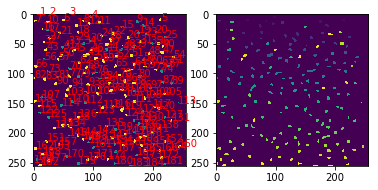

120 and 164 merged


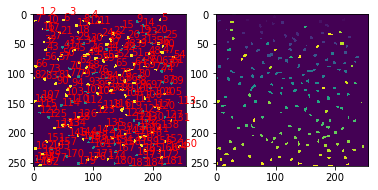

4 and 178 merged


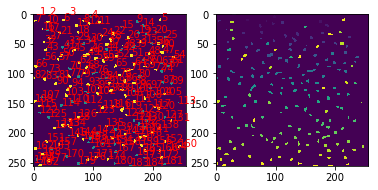

71 and 130 merged


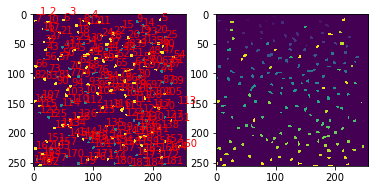

105 and 135 merged


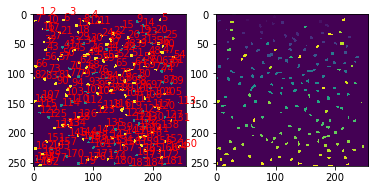

3 and 25 merged


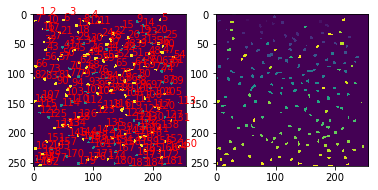

50 and 150 merged


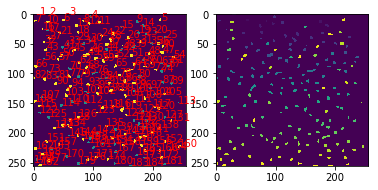

123 and 153 merged


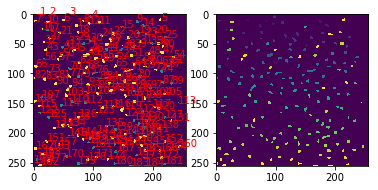

43 and 165 merged


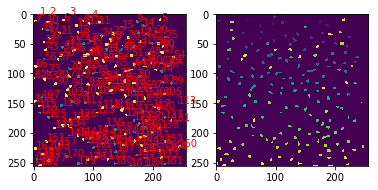

98 and 107 merged


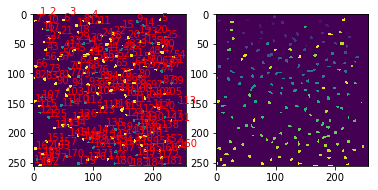

164 and 183 merged


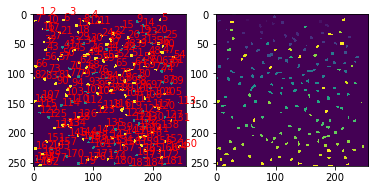

23 and 173 merged


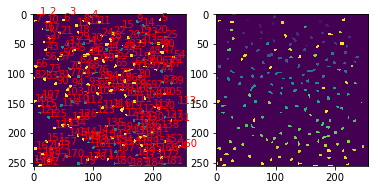

81 and 104 merged


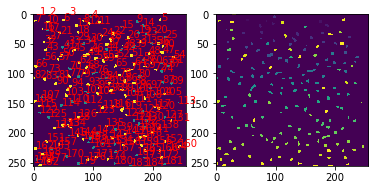

0 and 68 merged


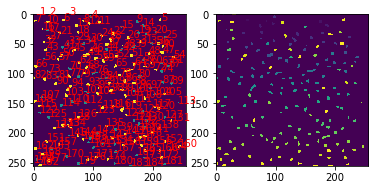

159 and 180 merged


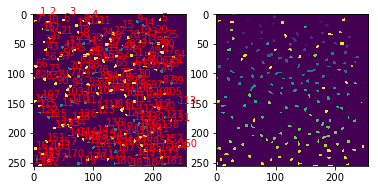

72 and 74 merged


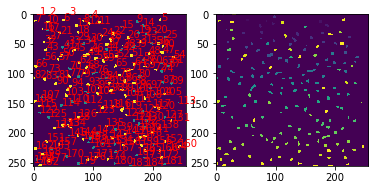

142 and 154 merged


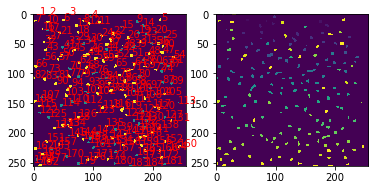

84 and 106 merged


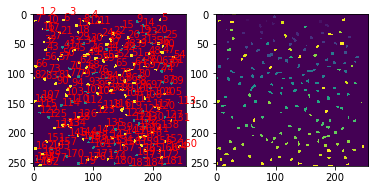

2 and 41 merged


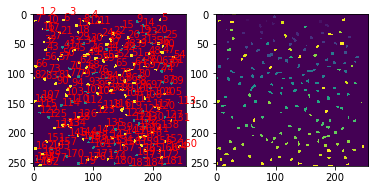

177 and 183 merged


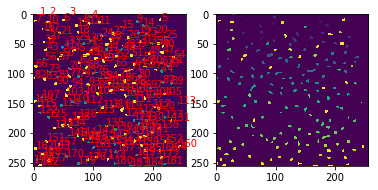

119 and 173 merged


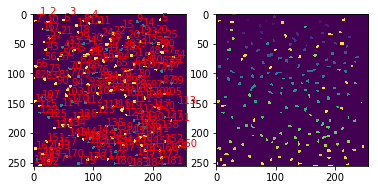

13 and 106 merged


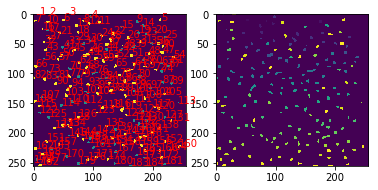

89 and 101 merged


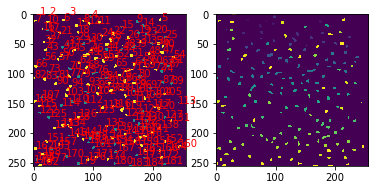

141 and 146 merged


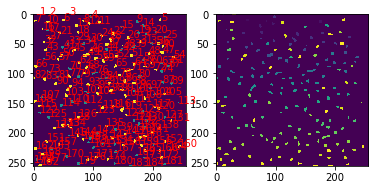

41 and 107 merged


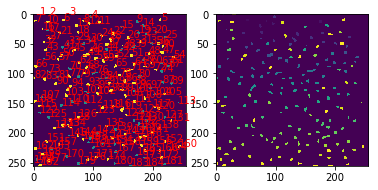

97 and 132 merged


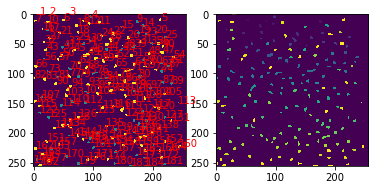

31 and 92 merged


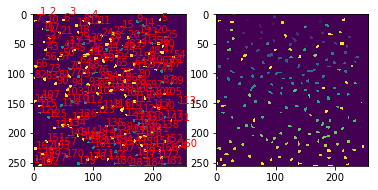

139 and 165 merged


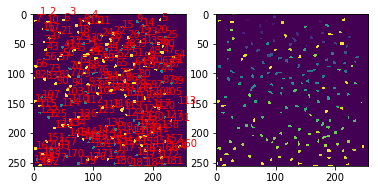

8 and 87 merged


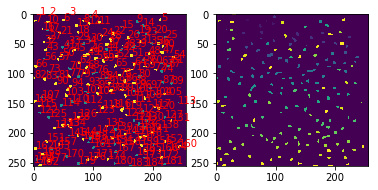

100 and 101 merged


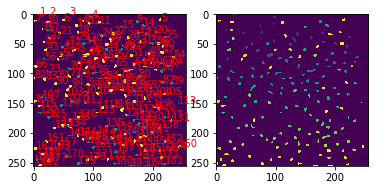

175 and 176 merged


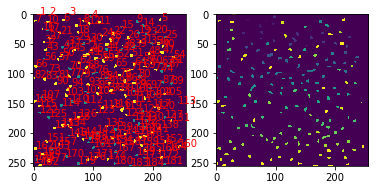

93 and 153 merged


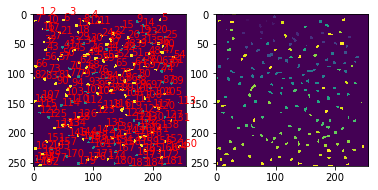

125 and 143 merged


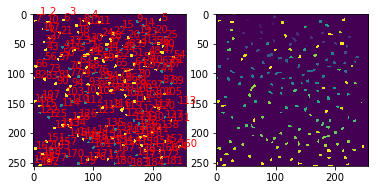

76 and 163 merged


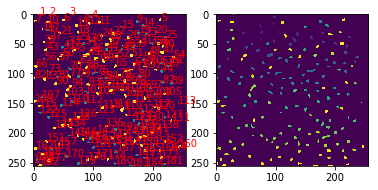

65 and 101 merged


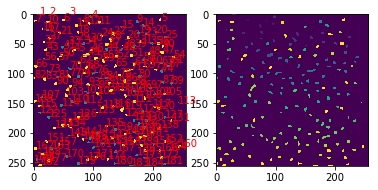

115 and 174 merged


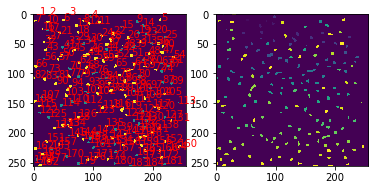

82 and 169 merged


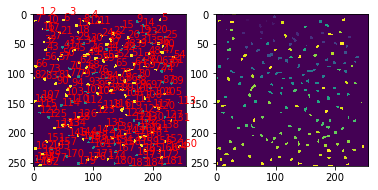

7 and 11 merged


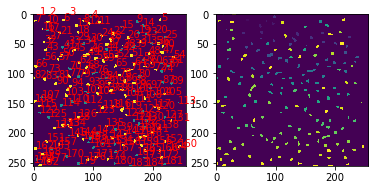

54 and 173 merged


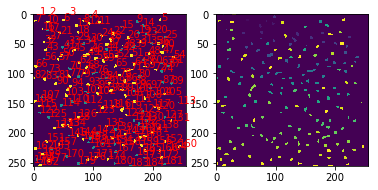

94 and 118 merged


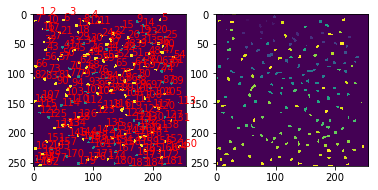

55 and 78 merged


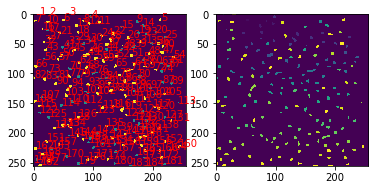

36 and 143 merged


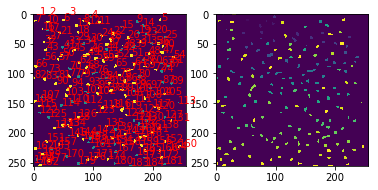

40 and 70 merged


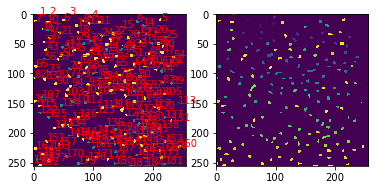

34 and 156 merged


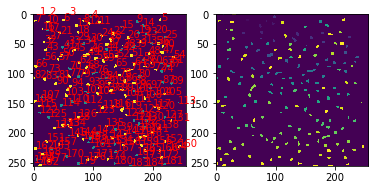

59 and 163 merged


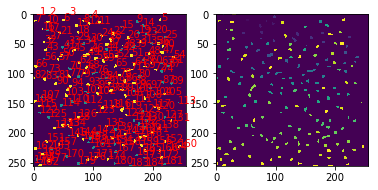

101 and 158 merged


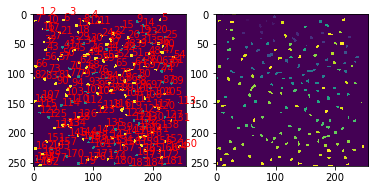

30 and 147 merged


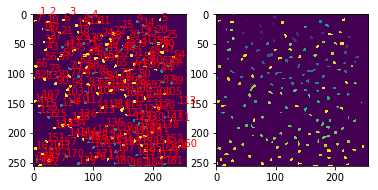

145 and 147 merged


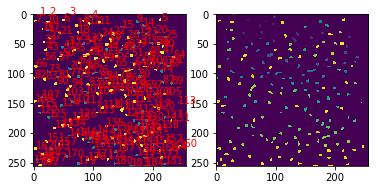

77 and 173 merged


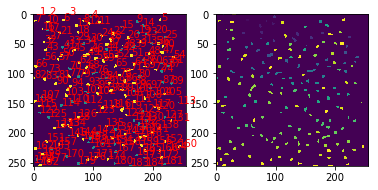

155 and 163 merged


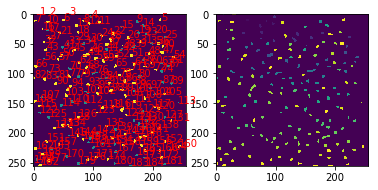

37 and 151 merged


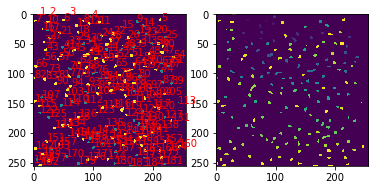

144 and 163 merged


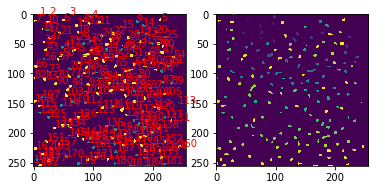

118 and 153 merged


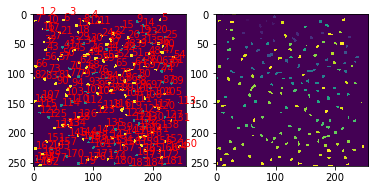

46 and 99 merged


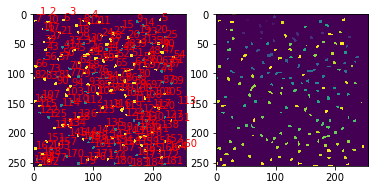

80 and 107 merged


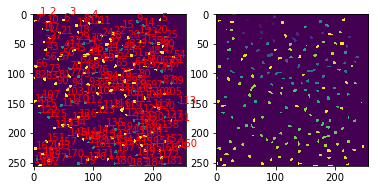

110 and 178 merged


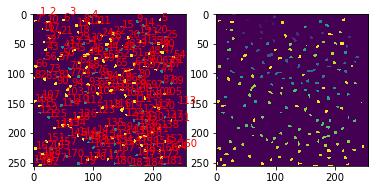

173 and 183 merged


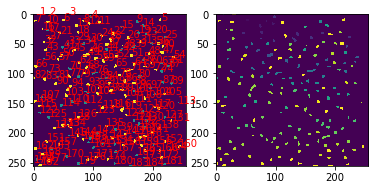

92 and 176 merged


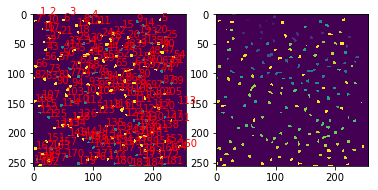

24 and 85 merged


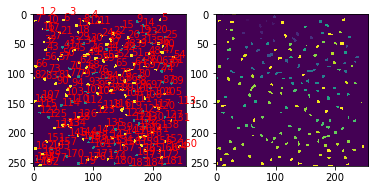

107 and 168 merged


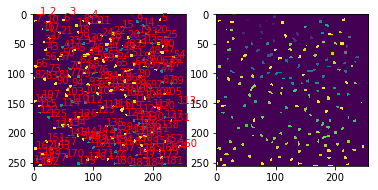

129 and 132 merged


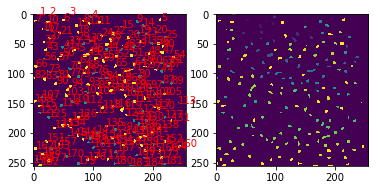

64 and 149 merged


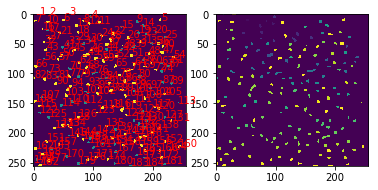

85 and 174 merged


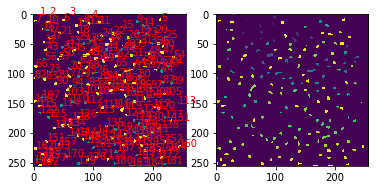

74 and 169 merged


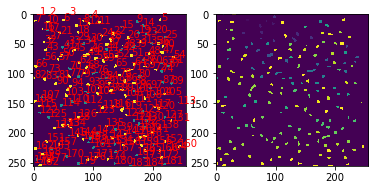

149 and 183 merged


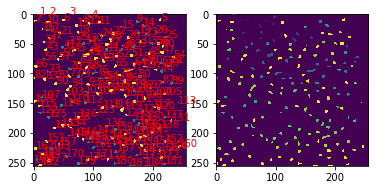

57 and 167 merged


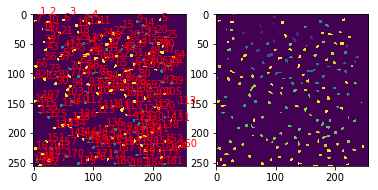

91 and 181 merged


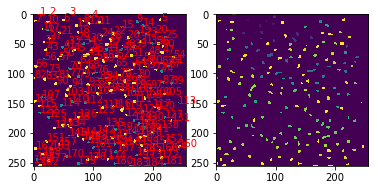

63 and 182 merged


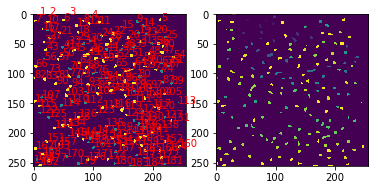

170 and 181 merged


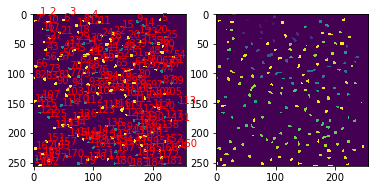

146 and 161 merged


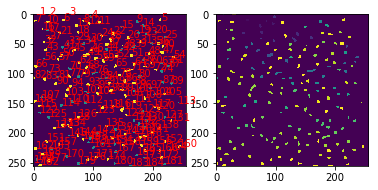

153 and 176 merged


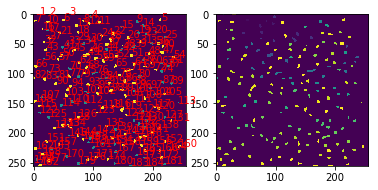

25 and 132 merged


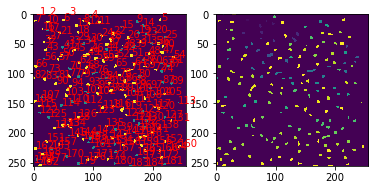

27 and 154 merged


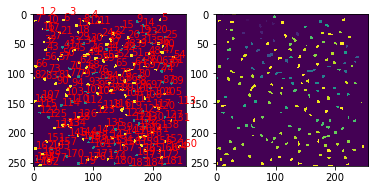

161 and 183 merged


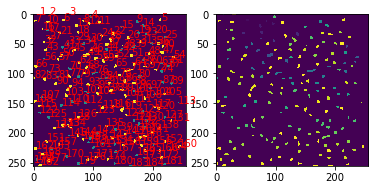

167 and 169 merged


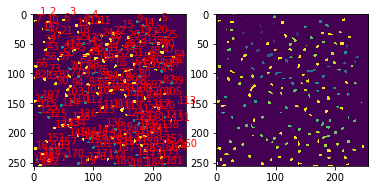

60 and 174 merged


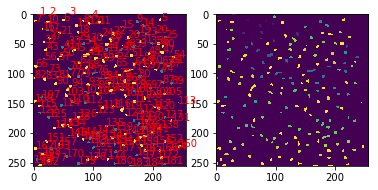

70 and 183 merged


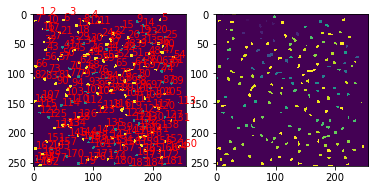

21 and 109 merged


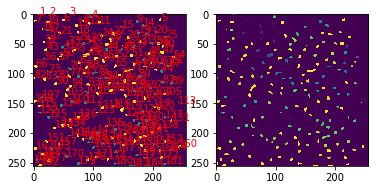

113 and 130 merged


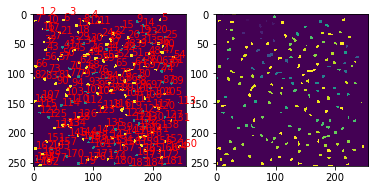

53 and 176 merged


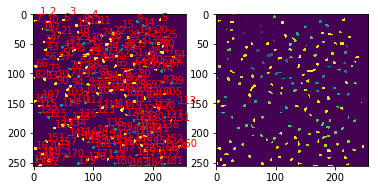

96 and 140 merged


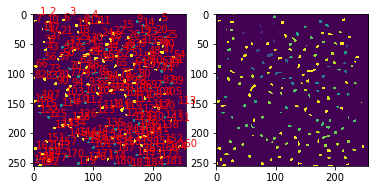

48 and 106 merged


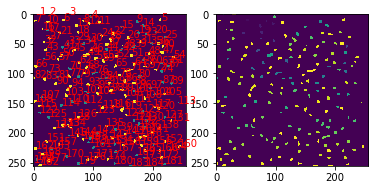

87 and 137 merged


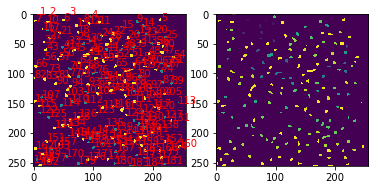

44 and 73 merged


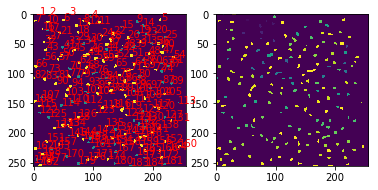

135 and 152 merged


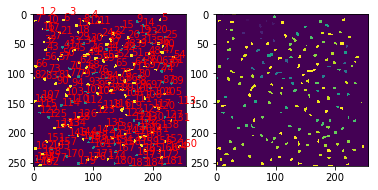

176 and 183 merged


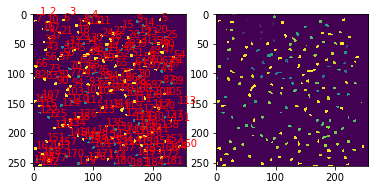

39 and 103 merged


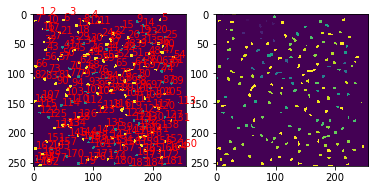

90 and 103 merged


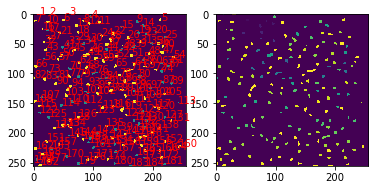

73 and 168 merged


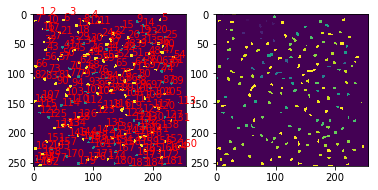

11 and 132 merged


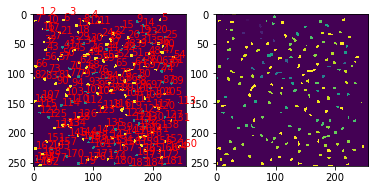

130 and 147 merged


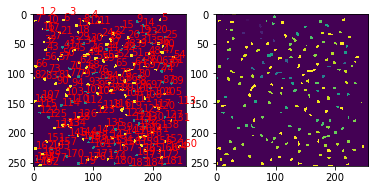

61 and 166 merged


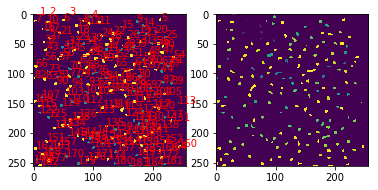

128 and 182 merged


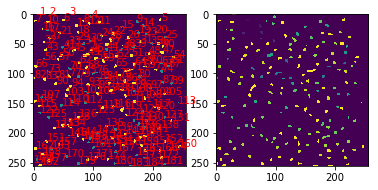

83 and 180 merged


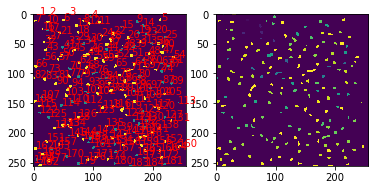

143 and 172 merged


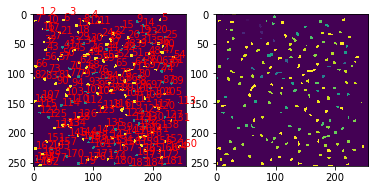

131 and 137 merged


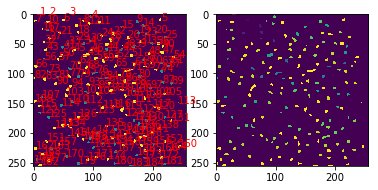

163 and 166 merged


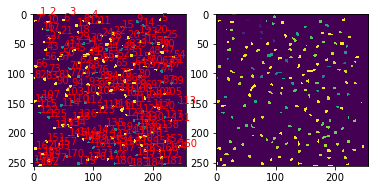

29 and 166 merged


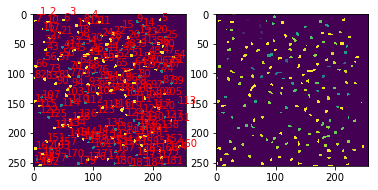

103 and 172 merged


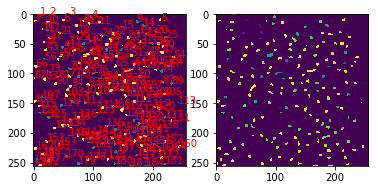

17 and 104 merged


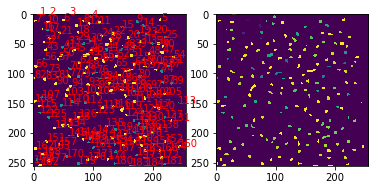

68 and 158 merged


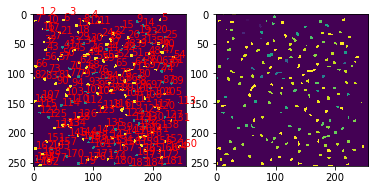

69 and 183 merged


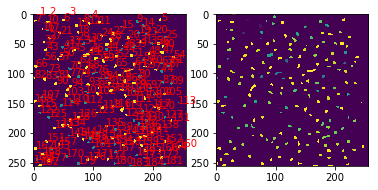

62 and 126 merged


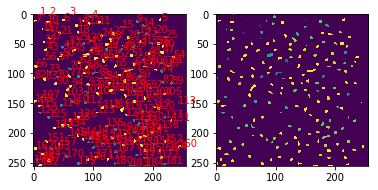

147 and 169 merged


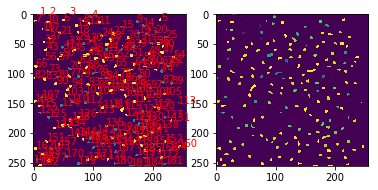

137 and 158 merged


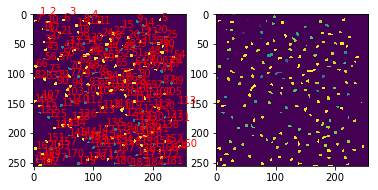

158 and 180 merged


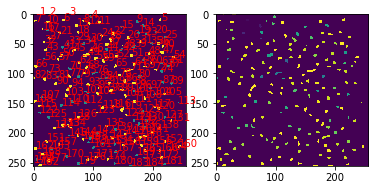

160 and 181 merged


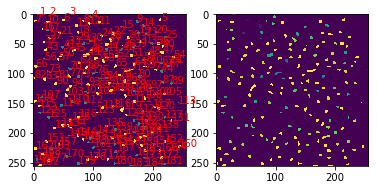

124 and 178 merged


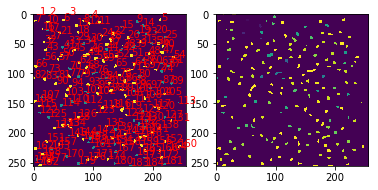

99 and 136 merged


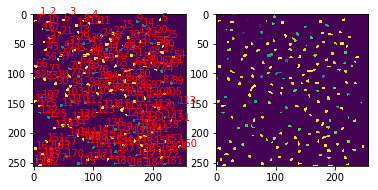

78 and 156 merged


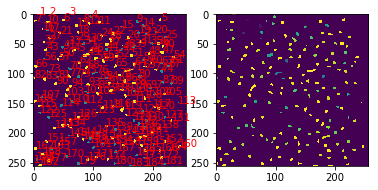

116 and 183 merged


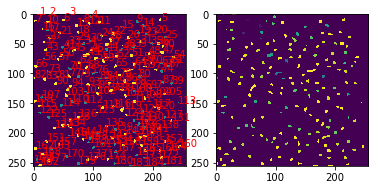

5 and 75 merged


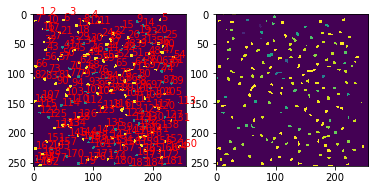

132 and 151 merged


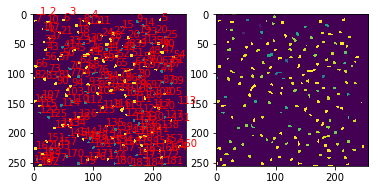

183 and 58 merged


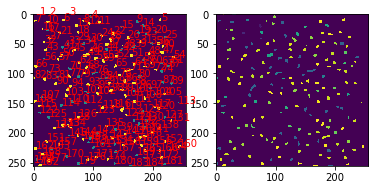

28 and 165 merged


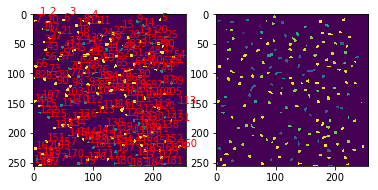

122 and 154 merged


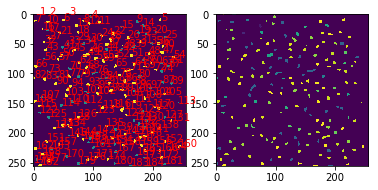

104 and 140 merged


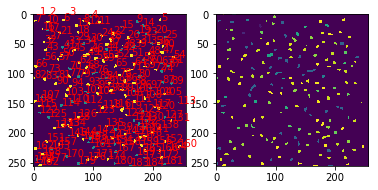

126 and 138 merged


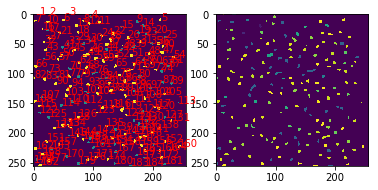

117 and 156 merged


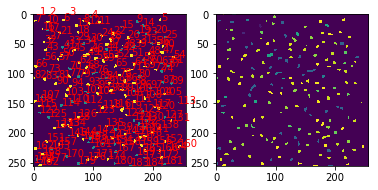

154 and 179 merged


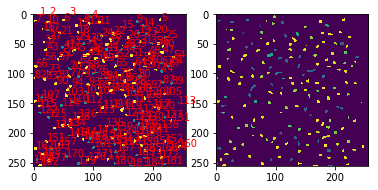

148 and 156 merged


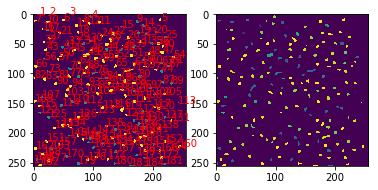

168 and 169 merged


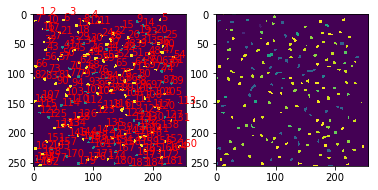

152 and 182 merged


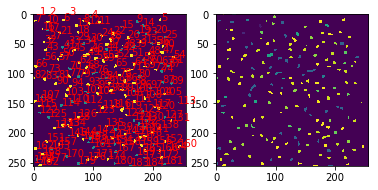

75 and 172 merged


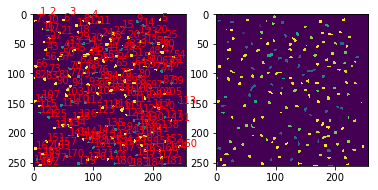

151 and 156 merged


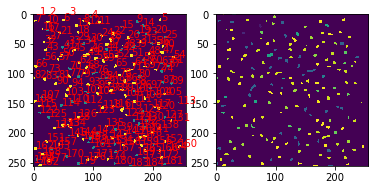

165 and 172 merged


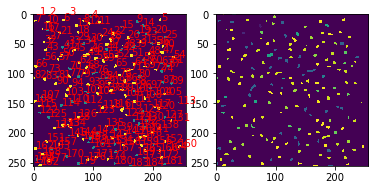

162 and 172 merged


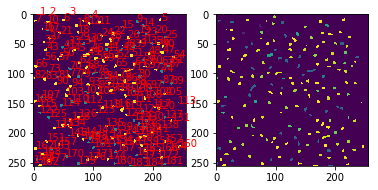

138 and 150 merged


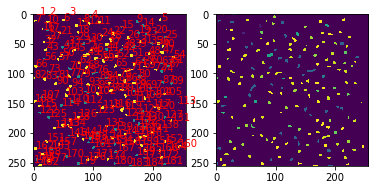

157 and 178 merged


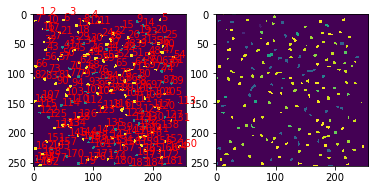

133 and 182 merged


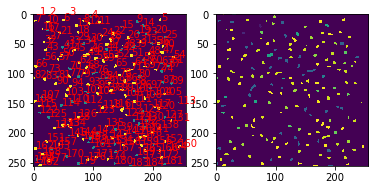

79 and 172 merged


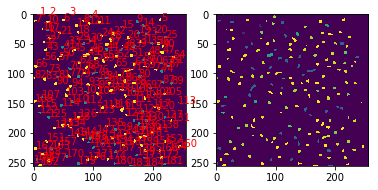

20 and 58 merged


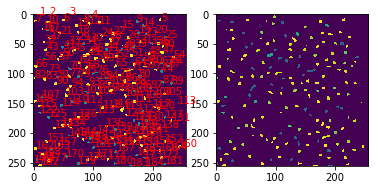

178 and 180 merged


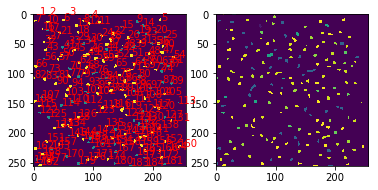

106 and 181 merged


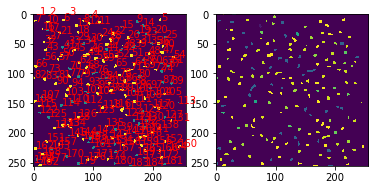

136 and 179 merged


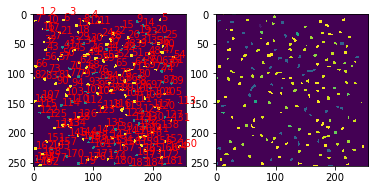

172 and 174 merged


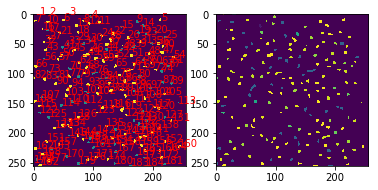

140 and 182 merged


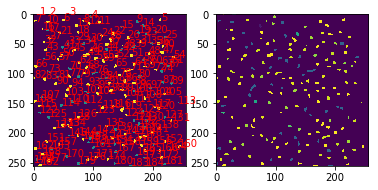

58 and 109 merged


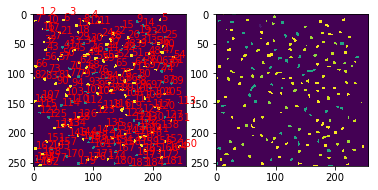

171 and 181 merged


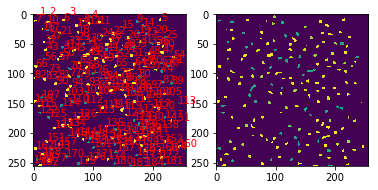

181 and 182 merged


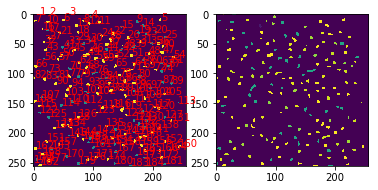

180 and 182 merged


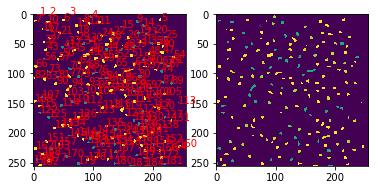

156 and 174 merged


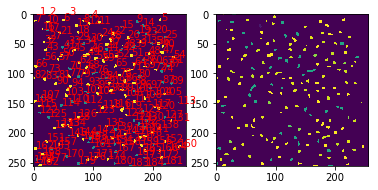

121 and 179 merged


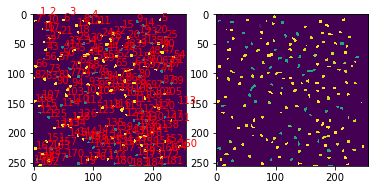

169 and 182 merged


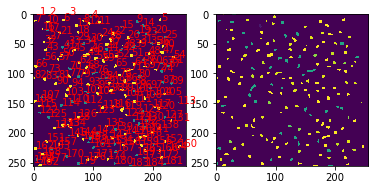

12 and 109 merged


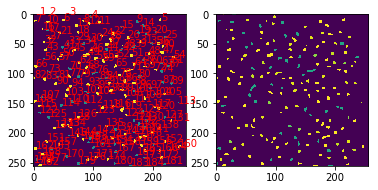

109 and 150 merged


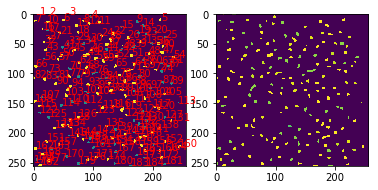

134 and 174 merged


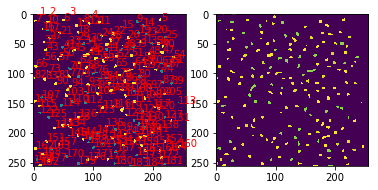

150 and 182 merged


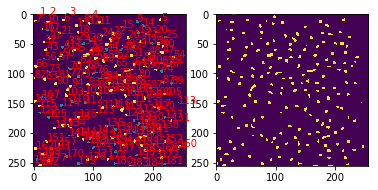

166 and 174 merged


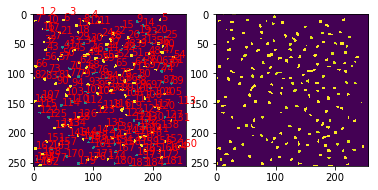

174 and 182 merged


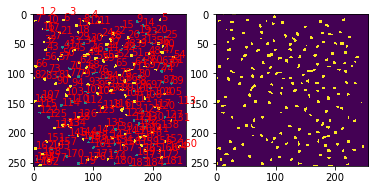

179 and 182 merged


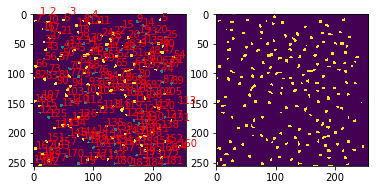

In [520]:
cur_num_classes = num_cells
removed_class_idx = []
cur_label = cell_idx-1
center_model = Model(target_input,centerloss_embed_layer)
merge_path = []
while(len(removed_class_idx)!=num_cells-1):
    
    onehot_label = keras.utils.to_categorical(cur_label,num_cells)
    
    history=softmax_model.fit([train_x,cur_label],[onehot_label,np.ones(shape=cell_idx.shape)],epochs=20,shuffle=True,batch_size=64,verbose=False)
    center_embed = center_model.layers[-1].get_weights()[0]
    cur_dist_mat = euclidean_distances(center_embed)
    cur_dist_mat_max = np.max(cur_dist_mat)
    cur_dist_mat[:,removed_class_idx] = cur_dist_mat_max+1
    cur_dist_mat[removed_class_idx,:] = cur_dist_mat_max+1
    np.fill_diagonal(cur_dist_mat,cur_dist_mat_max+1)
    
    [merge_i,merge_j] = np.unravel_index(np.argmin(cur_dist_mat),cur_dist_mat.shape)
    cur_label[cur_label==merge_i] = merge_j
    removed_class_idx.append(merge_i)
    
    merge_path.append((merge_i,merge_j))
    print(str(merge_i)+' and '+str(merge_j)+' merged')
    
    cur_labeling = np.zeros(shape=(65536,))
    cur_labeling[cell_pos] = cur_label+1
    cur_img = cur_labeling.reshape((256,256))
    plt.subplot(1,2,2)
    
    plt.imshow(cur_img)
    # img = np.transpose(img)
    true_labeling = label_dict[batch_num][np.argsort(pos_dict[batch_num])]
    true_img = true_labeling.reshape((256,256))
    plt.subplot(1,2,1)

    plt.imshow(true_img)
    for i in range(num_cells):
        cur_idx = i + 1
        cur_ind = cell_pos[cell_idx==cur_idx][0]
    #     print(ind2ij(cur_ind,256,0))
    #     print(ind2ij(cur_ind,256,1))

        plt.annotate(str(cur_idx),(ind2ij(cur_ind,256,1),ind2ij(cur_ind,256,0)),color='red')

    
#     break
    plt.show()

In [522]:
from scipy.cluster import hierarchy
import matplotlib.pyplot as plt

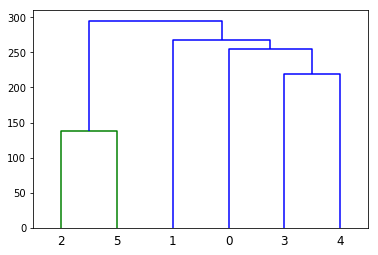

In [539]:
ytdist = np.array([662., 877., 255., 412., 996., 295., 468., 268.,
...                    400., 754., 564., 138., 219., 869., 669.])
Z = hierarchy.linkage(ytdist, 'single')
plt.figure()
dn = hierarchy.dendrogram(Z)
plt.show()

In [537]:
Z

array([[ 2.,  5.,  0.,  2.],
       [ 3.,  4.,  0.,  2.],
       [ 0.,  7.,  0.,  3.],
       [ 1.,  8.,  0.,  4.],
       [ 6.,  9.,  0.,  6.]])

In [ ]:
def wb_ratio(data_matrix,label):
    dist_mat = euclidean_distances(embed_mat)
    c1_idx = (label==1)
    c2_idx = (label==2)
    within_value = np.mean(dist_mat[:,c1_idx][c1_idx,:])+np.mean(dist_mat[:,c2_idx][c2_idx,:])
    between_value = np.mean(dist_mat[:,c1_idx][c2_idx,:])
    return within_value/between_value


from sklearn import metrics
from math import floor
t_lidu = 10
e_lidu = 1
cur_epoch = 0
n_clusters=2
tem_list = range(10,110,t_lidu)
mat_rows = floor(200/e_lidu)
mat_cols = floor(100/t_lidu)
ARI_mat = np.zeros(shape=(mat_rows,mat_cols))
NMI_mat = np.zeros(shape=(mat_rows,mat_cols))
WBR_mat = np.zeros(shape=(mat_rows,mat_cols))

train_loss_li = np.zeros(shape=(mat_rows,))
k=2
logit_model = Model(SIMS_input,d4)
graph_embed_model = Model(graph_input,den5)
while(cur_epoch<=199):
    history=softmax_model.fit(train_x,onehot_label,epochs=e_lidu,shuffle=True,batch_size=64,verbose=False)
    cur_epoch += e_lidu
    cur_train_loss = history.history['loss'][-1]
    train_loss_li[floor(cur_epoch/e_lidu-1)] = cur_train_loss
#     logit_model = Model(SIMS_input,d4)
    pred_logit = logit_model.predict(train_x)
    for t in tem_list:
        pred_t_softmax = np.exp(pred_logit/t)
        pred_t_softmax = pred_t_softmax/np.sum(pred_t_softmax,axis=1,keepdims=True)
        graph_mat = np.transpose(pred_t_softmax)
        graph_mat = graph_mat/np.max(graph_mat,axis=1,keepdims=True)
        dummy_input_val = np.tile(np.arange(k),(graph_mat.shape[0],1))
        dummy_output_val = np.ones(shape=(graph_mat.shape[0],1))
        graph_model.fit([graph_mat,dummy_input_val],[graph_mat,dummy_output_val,dummy_output_val],epochs=200,shuffle=True,batch_size=num_cells,verbose=False)
#         graph_embed_model = Model(graph_input,den5) 
        embed_mat = graph_embed_model.predict(graph_mat)


        _,unique_idx = np.unique(cell_idx,return_index=True)
        true_y = cell_type[unique_idx]
        # true_y[6] = 1
        true_batch = batch_idx[unique_idx]
        # nuclei_embed_2d = TSNE(n_components=2,verbose=1,metric='euclidean',perplexity=40,method='exact',n_iter=1000).fit_transform(embed_mat)

        embed_mat = embed_mat
        pred_y = KMeans(n_clusters=n_clusters).fit_predict(embed_mat)
        ARI = metrics.adjusted_rand_score(pred_y, true_y)
        NMI = metrics.normalized_mutual_info_score(pred_y, true_y)
        WBR = wb_ratio(embed_mat,true_y)
        cur_i = floor(cur_epoch/e_lidu-1)
        cur_j = floor(t/t_lidu-1)
        ARI_mat[cur_i,cur_j] = ARI
        NMI_mat[cur_i,cur_j] = NMI
        WBR_mat[cur_i,cur_j] = WBR
        print(cur_i,cur_j)

0 0
0 1
0 2
0 3
0 4
0 5
0 6
0 7
0 8
0 9
1 0
1 1
1 2
1 3
1 4
1 5
1 6
1 7
1 8
1 9
2 0
2 1
2 2
2 3
2 4
2 5
2 6
2 7
2 8
2 9
3 0
3 1
3 2
3 3
3 4
3 5
3 6
3 7
3 8
3 9
4 0
4 1
4 2
4 3
4 4
4 5
4 6
4 7
4 8
4 9
5 0
5 1
5 2
5 3


In [179]:
graph_mat

array([[ 0.64155024,  0.49908325,  0.62247729, ...,  0.36095217,
         0.1880201 ,  0.28223741],
       [ 0.5822857 ,  0.49604902,  0.6004687 , ...,  0.3604992 ,
         0.1740187 ,  0.33732188],
       [ 0.60952878,  0.63165629,  0.70912164, ...,  0.37578484,
         0.32799605,  0.39161307],
       ..., 
       [ 0.37954414,  0.29486933,  0.32505986, ...,  0.41284347,
         0.25546995,  0.27150577],
       [ 0.28567418,  0.34473741,  0.27833825, ...,  0.31725213,
         0.62227339,  0.54779249],
       [ 0.41086081,  0.3678242 ,  0.36473417, ...,  0.53203458,
         0.46243724,  0.4918659 ]], dtype=float32)

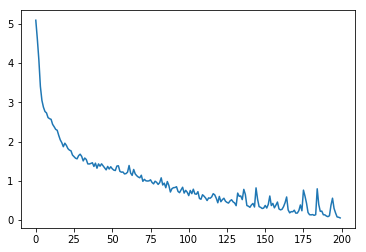

In [9]:
plt.plot(history.history['loss'])
plt.show()

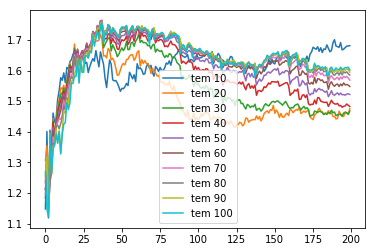

In [218]:

t = 3

legned_li = []
for i in range(0,10,1):
    plt.plot(WBR_mat[:,i])
    legned_li.append('tem '+str((i+1)*10))
plt.legend(legned_li)
# plt.plot(NMI_mat[:,t])
# plt.plot(ARI_mat[:,t])
# plt.plot(WBR_mat[:,t])
# plt.plot(ARI_mat[:,2])
# 
# plt.plot(train_loss_li)
# plt.legend(['NMI','ARI','WBR'])
# plt.plot(WBR_mat[:,9])
# plt.legend('100t')
# plt.plot(WBR_mat[:,0])
# plt.legend('10t')
plt.show()

In [197]:
np.save('batch2_NMI',NMI_mat)
np.save('batch2_ARI',ARI_mat)
np.save('batch2_WBR',WBR_mat)
np.save('batch2_loss',train_loss_li)

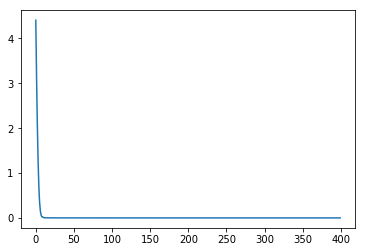

In [238]:
plt.plot(history.history['loss'])
plt.show()

In [325]:
softmax_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_259 (InputLayer)       (None, 200)               0         
_________________________________________________________________
dense_472 (Dense)            (None, 1024)              205824    
_________________________________________________________________
dense_473 (Dense)            (None, 512)               524800    
_________________________________________________________________
dense_474 (Dense)            (None, 256)               131328    
_________________________________________________________________
dense_475 (Dense)            (None, 32)                8224      
_________________________________________________________________
dense_476 (Dense)            (None, 135)               4455      
_________________________________________________________________
activation_25 (Activation)   (None, 135)               0         
Total para

In [32]:
pred_logit.shape

(9529, 49)

In [361]:
logit_model = Model(SIMS_input,d4)
pred_logit = logit_model.predict(train_x)
# pred_softmax = softmax_model.predict(train_x)
t = 30
pred_t_softmax = np.exp(pred_logit/t)
pred_t_softmax = pred_t_softmax/np.sum(pred_t_softmax,axis=1,keepdims=True)


In [324]:
t = 100

pred_softmax = np.exp(pred_logit)
pred_softmax = pred_softmax/np.sum(pred_softmax,axis=1,keepdims=True)

pred_t_softmax = np.exp(pred_logit/t)
pred_t_softmax = pred_t_softmax/np.sum(pred_t_softmax,axis=1,keepdims=True)


KeyboardInterrupt: 

In [600]:
pred_logit

array([[ 0.9951058 , -0.05408578, -0.11465985, ..., -0.06968202,
        -0.04200794, -0.04263688],
       [ 0.99555767, -0.04989874, -0.11119241, ..., -0.06887589,
        -0.03973768, -0.04047222],
       [ 0.99495202, -0.04410426, -0.10896648, ..., -0.06922706,
        -0.0398337 , -0.04047959],
       ..., 
       [-0.04844679,  0.04725746,  0.03909113, ..., -0.01906006,
         0.99004912,  0.99400651],
       [-0.04814445,  0.06517338,  0.0558262 , ..., -0.01212042,
         0.9869746 ,  0.99176282],
       [-0.0469609 , -0.02100687, -0.02138783, ..., -0.03892855,
         0.99671876,  0.99810612]], dtype=float32)

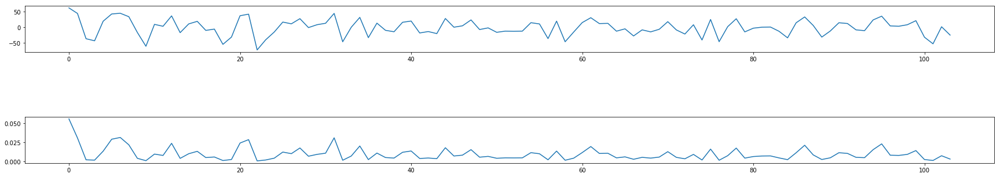

In [240]:
i=10
fig = plt.figure(figsize=(30,5))
plt.subplot(3,1,1)
plt.plot(pred_logit[i,:])
# plt.subplot(3,1,2)
# plt.plot(pred_softmax[i,:])
plt.subplot(3,1,3)
plt.plot(pred_t_softmax[i,:])
plt.show()

In [1069]:
pred_logit.shape

(4287, 152)

In [420]:
covar_mat = np.dot(np.transpose(pred_t_softmax),pred_t_softmax)

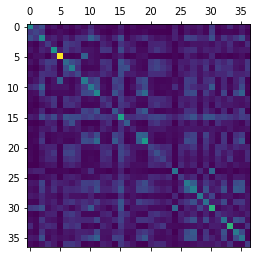

In [421]:
plt.matshow(covar_mat)
plt.show()

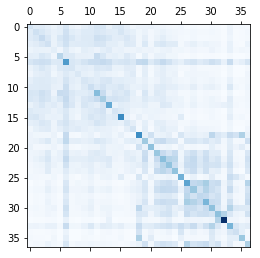

In [422]:
data=covar_mat
model = SpectralCoclustering(n_clusters=2, random_state=0)
model.fit(data)
fit_data = data[np.argsort(model.row_labels_)]
fit_data = fit_data[:, np.argsort(model.column_labels_)]

plt.matshow(fit_data, cmap=plt.cm.Blues)
plt.show()

In [592]:
softmax_embed_2d = TSNE(n_components=2,verbose=1,metric='correlation',perplexity=30,method='exact',n_iter=1000).fit_transform(np.transpose(pred_logit))


[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 134 / 134
[t-SNE] Mean sigma: 0.274528
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.454535
[t-SNE] Error after 600 iterations: 1.024518


In [634]:
# 使embedding尽量匹配蒸馏的softmax
embedding_dim = 2
######################
#     nuclei_embed,target,pixel_embed = args
# #     target = K.expand_dims(target,axis=1)
# #     print('nuclei_embed',nuclei_embed.shape)
# #     print('target',target.shape)
#     target = K.expand_dims(target,axis=1)
# #     print('pixel_embed',pixel_embed.shape)
#     print('nuclei_embed',nuclei_embed.shape)
#     print('target',target.shape)
#     aaa = K.batch_dot(target,nuclei_embed)
#     print('aaa1',aaa.shape)
# #     aaa = K.squeeze(aaa,2)
# #     pixel_embed = K.squeeze(pixel_embed,1)
# #     aaa = K.squeeze(aaa,1)
#     pixel_embed = K.expand_dims(pixel_embed,axis=1)
#     print('aaa',aaa.shape)
#     print('pixel_embed',pixel_embed.shape)
#     rst = K.sum(K.square(aaa-pixel_embed),axis=-1,keepdims=False)
#     return rst
######################



def cal_simatching_loss(args):
    t=1
    embed_param,softmax_param,target_param = args
    print(embed_param.shape,softmax_param.shape,target_param.shape)
    target = K.expand_dims(target_param,axis=1)
    target_embed_row = K.batch_dot(target,embed_param)
    target_softmax_row = K.batch_dot(target,softmax_param)
    print('target_embed_row',target_embed_row.shape)
    print('target_softmax_row',target_softmax_row.shape)
    
#     embed_sim_vec = K.exp(-K.sum(K.square(embed_param-target_embed_row),axis=-1,keepdims=False))
    embed_sim_vec = K.pow(K.abs(K.sum(K.square(embed_param-target_embed_row),axis=-1,keepdims=False))+1,-1)
    
#     softmax_sim_vec = softmax_param/(K.max(softmax_param,axis=-1,keepdims=True))
#     print('aaa',(K.max(softmax_param,axis=-1,keepdims=True)).shape)
    
    softmax_sim_vec = softmax_param/(target_softmax_row+K.epsilon())
#     softmax_sim_vec = K.clip(softmax_sim_vec,0,1)
    print('embed_sim_vec',embed_sim_vec.shape)
    print('softmax_sim_vec',softmax_sim_vec.shape)
    print('aaa',K.sum(softmax_sim_vec,axis=-1,keepdims=True).shape)
#     rst = K.categorical_crossentropy(embed_sim_vec/(K.sum(embed_sim_vec,axis=-1,keepdims=True)+K.epsilon()),softmax_sim_vec/(K.sum(softmax_sim_vec,axis=-1,keepdims=True)+K.epsilon()),axis=-1)
    prob_embed = embed_sim_vec/(K.sum(embed_sim_vec,axis=-1,keepdims=True)+K.epsilon())
    prob_soft = softmax_sim_vec/(K.sum(softmax_sim_vec,axis=-1,keepdims=True)+K.epsilon())
    kld1 = keras.losses.kullback_leibler_divergence(prob_embed,prob_soft)
    kld1 = K.expand_dims(kld1,axis=1)
    
    kld2 = keras.losses.kullback_leibler_divergence(prob_soft,prob_embed)
    kld2 = K.expand_dims(kld2,axis=1)
    
    rst = (kld1+kld2)/2
#     rst = kld1
    
#     softmax_sim_vec = softmax_sim_vec/K.max(softmax_sim_vec,axis=-1,keepdims=True)
#     softmax_sim_vec = softmax_param/K.max(softmax_param,axis=-1,keepdims=True)
    
    
#     rst = K.binary_crossentropy(embed_sim_vec,softmax_sim_vec)
    
#     rst = K.mean(K.binary_crossentropy(embed_sim_vec,softmax_sim_vec),axis=-1,keepdims=True)
#     rst = K.mean(K.square(embed_sim_vec-softmax_sim_vec),axis=-1,keepdims=True)
    print('rst',rst.shape)

    return rst
softmax_input = Input(shape=(num_cells,))
dummy_input = Input(shape=(num_cells,))
target_input = Input(shape=(num_cells,))
embed_layer = Embedding(num_cells,embedding_dim,input_length=num_cells,embeddings_initializer=glorot_normal())(dummy_input)
matching_loss = Lambda(cal_simatching_loss,output_shape=(1,))([embed_layer,softmax_input,target_input])

matching_model = Model([softmax_input,dummy_input,target_input],matching_loss)
matching_model.compile(optimizer=adam(),loss=[lambda y_true,y_pred: y_pred])

(?, 47, 2) (?, 47) (?, 47)
target_embed_row (?, 1, 2)
target_softmax_row (?, 1)
embed_sim_vec (?, 47)
softmax_sim_vec (?, 47)
aaa (?, 1)
rst (?, 1)


In [637]:
softmax_input_val = pred_t_softmax
dummy_input_val = np.tile(np.arange(num_cells),(train_x.shape[0],1))
target_input_val = keras.utils.to_categorical(cell_idx-1,num_cells)
dummy_output = np.ones(shape=(train_x.shape[0],1))
print('dummy_output',dummy_output.shape)
print('softmax_input_val',softmax_input_val.shape)
print('dummy_input_val',dummy_input_val.shape)
print('target_input_val',target_input_val.shape)

history=matching_model.fit([softmax_input_val,dummy_input_val,target_input_val],dummy_output,epochs=10,shuffle=True,batch_size=512)

dummy_output (9487, 1)
softmax_input_val (9487, 47)
dummy_input_val (9487, 47)
target_input_val (9487, 47)
Epoch 1/10
9487/9487 [==============================] - 0s 38us/step - loss: 0.0197
Epoch 2/10
9487/9487 [==============================] - 1s 61us/step - loss: 0.0197
Epoch 3/10
9487/9487 [==============================] - 1s 67us/step - loss: 0.0197
Epoch 4/10
9487/9487 [==============================] - 1s 143us/step - loss: 0.0197
Epoch 5/10
9487/9487 [==============================] - 0s 38us/step - loss: 0.0197
Epoch 6/10
9487/9487 [==============================] - 0s 47us/step - loss: 0.0197
Epoch 7/10
9487/9487 [==============================] - 0s 24us/step - loss: 0.0197
Epoch 8/10
9487/9487 [==============================] - 0s 26us/step - loss: 0.0197
Epoch 9/10
9487/9487 [==============================] - 2s 174us/step - loss: 0.0197
Epoch 10/10
9487/9487 [==============================] - 1s 126us/step - loss: 0.0197


In [82]:
pred_t_softmax[-1,:] = true_y

In [199]:
graph_mat = np.transpose(pred_t_softmax)
graph_mat = graph_mat/np.max(graph_mat,axis=1,keepdims=True)

low_dim = 2
k = 5
activ = 'relu'
def harden_loss(args):
    embed_data,centroid = args
    embed_data = K.expand_dims(embed_data,axis=1)
    print('embed_data',embed_data.shape)
    print('centroid',centroid.shape)

    qij = K.pow(1+K.sum(K.square(embed_data-centroid),axis=-1),-1)
    qij_norm = qij/(K.sum(qij,axis=-1,keepdims=True))
    
    print('qij',qij_norm.shape)
    fj = K.sum(qij_norm,axis=0)
    pij = K.square(qij_norm)/fj
    pij_norm = pij/(K.sum(pij,axis=-1,keepdims=True))
#     pij_norm = K.clip(pij_norm, K.epsilon(), 1)
#     qij_norm = K.clip(qij_norm, K.epsilon(), 1)
    rst = keras.losses.kullback_leibler_divergence(pij_norm,qij_norm)
#     rst = pij*K.log(pij/(qij+K.epsilon()))
  
#     a = K.log(pij_norm/qij_norm)
#     b = pij_norm
#     c = a*b
# #     d = K.sum(c)
#     rst = K.sum(c)
#     print('a',a.shape)
#     print('b',b.shape)
#     print('c',c.shape)
# #     print('d',d.shape)
# #     rst = K.sum(pij_norm*)
    
#     print('fj',fj.shape)
#     print('pij_norm',pij_norm.shape)
#     print('qij_norm',qij_norm.shape)
#     print('rst',rst.shape)
    return rst
def prob_loss(args):
    ori_data,recon_data = args
    print('ori_data',ori_data.shape)
    print('recon_data',recon_data.shape)
    ori_data_norm = ori_data/(K.sum(ori_data,axis=0)+K.epsilon())
    recon_data_norm = recon_data/(K.sum(recon_data,axis=0)+K.epsilon())
    ori_data_norm = K.transpose(ori_data_norm)
    recon_data_norm = K.transpose(recon_data_norm)
    print('ori_data_norm',ori_data_norm.shape)
    print('recon_data_norm',recon_data_norm.shape)
    rst = keras.losses.kullback_leibler_divergence(ori_data_norm,recon_data_norm)
    rst = K.sum(rst,keepdims=True)
    print('rst',rst.shape)
    return rst
    
graph_input = Input(shape=(train_x.shape[0],))
dummy_input = Input(shape=(k,))
den1 = Dense(1024,activation=activ)(graph_input)
# den1 = Dense(512,activation=activ)(den1)
# den1 = Dense(256,activation=activ)(den1)
den1 = Dense(64,activation=activ)(den1)
den5 = Dense(low_dim,activation='linear')(den1)
den2 = Dense(64,activation=activ)(den5)
# den2 = Dense(256,activation=activ)(den2)
# den2 = Dense(512,activation=activ)(den2)
den2 = Dense(1024,activation=activ)(den2)
den10 = Dense(train_x.shape[0],activation='sigmoid')(den2)
center_embedding = Embedding(k,low_dim,input_length=k)(dummy_input)
harden_loss_layer = Lambda(harden_loss,output_shape=(1,),name='harden_loss')([den5,center_embedding])
prob_loss_layer = Lambda(prob_loss,output_shape=(1,),name='prob_loss')([den10,graph_input])



graph_model = Model([graph_input,dummy_input],[den10,harden_loss_layer,prob_loss_layer])
graph_model.compile(optimizer=adam(),loss=['binary_crossentropy',lambda y_true,y_pred: y_pred,lambda y_true,y_pred: y_pred],loss_weights=[1,0,0])

dummy_input_val = np.tile(np.arange(k),(np.max(cell_idx),1))
dummy_output_val = np.ones(shape=(np.max(cell_idx),1))
history=graph_model.fit([graph_mat,dummy_input_val],[graph_mat,dummy_output_val,dummy_output_val],epochs=200,shuffle=True,batch_size=num_cells)

embed_data (?, 1, 2)
centroid (?, 5, 2)
qij (?, 5)
ori_data (?, 3866)
recon_data (?, 3866)
ori_data_norm (3866, ?)
recon_data_norm (3866, ?)
rst (1,)
Epoch 1/200
154/154 [==============================] - 6s 40ms/step - loss: 0.6932 - dense_278_loss: 0.6932 - harden_loss_loss: 2.5792e-05 - prob_loss_loss: 2067.0066
Epoch 2/200
154/154 [==============================] - 0s 144us/step - loss: 0.6925 - dense_278_loss: 0.6925 - harden_loss_loss: 2.5346e-05 - prob_loss_loss: 2067.0933
Epoch 3/200
154/154 [==============================] - 0s 132us/step - loss: 0.6859 - dense_278_loss: 0.6859 - harden_loss_loss: 1.3154e-05 - prob_loss_loss: 2073.0664
Epoch 4/200
154/154 [==============================] - 0s 127us/step - loss: 0.6568 - dense_278_loss: 0.6568 - harden_loss_loss: 1.1780e-05 - prob_loss_loss: 2107.0183
Epoch 5/200
154/154 [==============================] - 0s 146us/step - loss: 0.5874 - dense_278_loss: 0.5874 - harden_loss_loss: 4.3919e-06 - prob_loss_loss: 2226.9663
Epoch 6/200

In [169]:
graph_model.compile(optimizer=adam(),loss=['binary_crossentropy',lambda y_true,y_pred: y_pred,lambda y_true,y_pred: y_pred],loss_weights=[1,0,0])
history=graph_model.fit([graph_mat,dummy_input_val],[graph_mat,dummy_output_val,dummy_output_val],epochs=200,shuffle=True,batch_size=num_cells)
graph_model.compile(optimizer=adam(),loss=['binary_crossentropy',lambda y_true,y_pred: y_pred,lambda y_true,y_pred: y_pred],loss_weights=[0,1,0])
history=graph_model.fit([graph_mat,dummy_input_val],[graph_mat,dummy_output_val,dummy_output_val],epochs=20,shuffle=True,batch_size=num_cells)


Epoch 1/200
154/154 [==============================] - 5s 32ms/step - loss: 0.5263 - dense_219_loss: 0.5263 - harden_loss_loss: -4.7151e-09 - prob_loss_loss: 634.5145
Epoch 2/200
154/154 [==============================] - 0s 139us/step - loss: 0.5485 - dense_219_loss: 0.5485 - harden_loss_loss: 7.6900e-09 - prob_loss_loss: 643.4291
Epoch 3/200
154/154 [==============================] - 0s 129us/step - loss: 0.5608 - dense_219_loss: 0.5608 - harden_loss_loss: 2.0749e-08 - prob_loss_loss: 730.0585
Epoch 4/200
154/154 [==============================] - 0s 130us/step - loss: 0.5345 - dense_219_loss: 0.5345 - harden_loss_loss: 6.1213e-09 - prob_loss_loss: 786.6678
Epoch 5/200
154/154 [==============================] - 0s 132us/step - loss: 0.5130 - dense_219_loss: 0.5130 - harden_loss_loss: 6.7836e-09 - prob_loss_loss: 876.5674
Epoch 6/200
154/154 [==============================] - 0s 131us/step - loss: 0.5048 - dense_219_loss: 0.5048 - harden_loss_loss: 7.5774e-09 - prob_loss_loss: 948.002

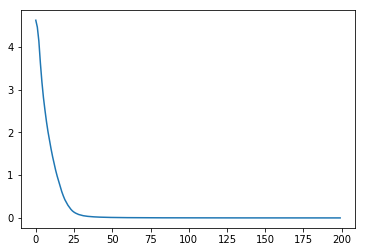

In [290]:
plt.plot(history.history['loss'])
plt.show()

In [223]:
1+1

2

In [414]:
logit_model = Model(SIMS_input,d4)
pred_logit = logit_model.predict(train_x)
# pred_softmax = softmax_model.predict(train_x)
t = 50
pred_t_softmax = np.exp(pred_logit/t)
pred_t_softmax = pred_t_softmax/np.sum(pred_t_softmax,axis=1,keepdims=True)


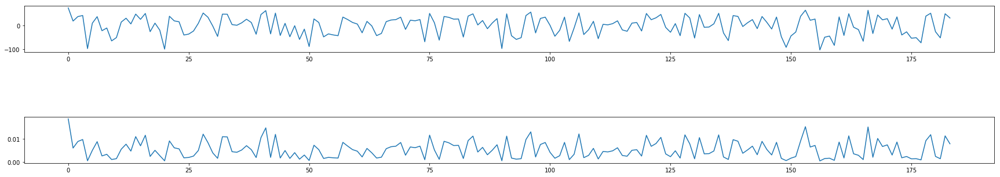

In [415]:
logit_model = Model(SIMS_input,d4)
pred_logit = logit_model.predict(train_x)
# pred_softmax = softmax_model.predict(train_x)
t = 50
pred_t_softmax = np.exp(pred_logit/t)
pred_t_softmax = pred_t_softmax/np.sum(pred_t_softmax,axis=1,keepdims=True)

i=10
fig = plt.figure(figsize=(30,5))
plt.subplot(3,1,1)
plt.plot(pred_logit[i,:])
# plt.subplot(3,1,2)
# plt.plot(pred_softmax[i,:])
plt.subplot(3,1,3)
plt.plot(pred_t_softmax[i,:])
plt.show()

In [8]:
import umap
embed_mat2 = umap.UMAP().fit_transform(np.transpose(pred_t_softmax))


In [373]:
num_cells

141

UMAP(a=None, angular_rp_forest=False, b=None, init='spectral',
   learning_rate=1.0, local_connectivity=1.0, metric='cosine',
   metric_kwds=None, min_dist=0, n_components=2, n_epochs=None,
   n_neighbors=30, negative_sample_rate=5, random_state=None,
   repulsion_strength=1.0, set_op_mix_ratio=1.0, spread=1.0,
   target_metric='categorical', target_metric_kwds=None,
   target_n_neighbors=-1, target_weight=0.5, transform_queue_size=4.0,
   transform_seed=42, verbose=True)
Construct fuzzy simplicial set
Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs


/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:46: DeprecationWarning: using a non-integer array as obj in delete will result in an error in the future
/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:47: DeprecationWarning: using a non-integer array as obj in delete will result in an error in the future


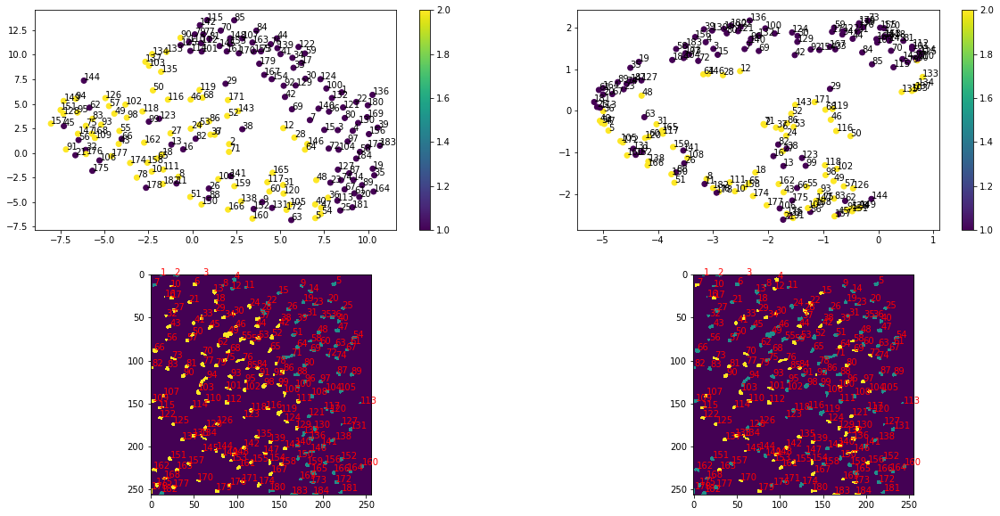

In [421]:
import umap
n_clusters=2

# embed_model = Model(dummy_input,embed_layer)
# embed_mat = embed_model.layers[-1].get_weights()[0]
# graph_embed_model = Model(graph_input,den5)
# embed_mat = graph_embed_model.predict(graph_mat)
# cell_type = np.ones(shape=cell_idx.shape)
# label_dict[1] = np.ones(shape=(65536,))

# dist = 'euclidean'
embed_mat1 = TSNE(n_components=2,metric='cosine',perplexity=30).fit_transform(np.transpose(pred_t_softmax))
# embed_mat = TSNE(n_components=2,metric='precomputed').fit_transform(1-spearman_mat)
embed_mat2 = umap.UMAP(metric='cosine',n_neighbors=30,min_dist=0,verbose=True).fit_transform(np.transpose(pred_t_softmax))
# embed_mat = TSNE(n_components=2).fit_transform(graph_mat)


_,unique_idx = np.unique(cell_idx,return_index=True)
true_y = cell_type[unique_idx]
# true_y[6] = 1
true_batch = batch_idx[unique_idx]
# nuclei_embed_2d = TSNE(n_components=2,verbose=1,metric='euclidean',perplexity=40,method='exact',n_iter=1000).fit_transform(embed_mat)

# embed_mat = embed_mat
pred_y1 = MiniBatchKMeans(n_clusters=n_clusters).fit_predict(embed_mat1)

# pred_y2 = MiniBatchKMeans(n_clusters=n_clusters).fit_predict(embed_mat2)
pred_y2 = SpectralClustering(n_clusters=n_clusters).fit_predict(embed_mat2)

# pred_y = AffinityPropagation().fit_predict(embed_mat)
# pred_y = SpectralClustering(n_clusters=n_clusters).fit_predict(embed_mat)

fig = plt.figure(figsize=(20,10))
plt.subplot(2,2,1)
plt.scatter(embed_mat1[:,0],embed_mat1[:,1],c=true_y)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(embed_mat1[i,0],embed_mat1[i,1]))
plt.colorbar(use_gridspec=True)


plt.subplot(2,2,2)
# rare_cells = np.delete(np.arange(num_cells+1),[39,44,47,56])-1
# rare_cells = np.array([39,44,47,56])-1;
rare_cells = np.array([])
embed_mat2_major = np.delete(embed_mat2,rare_cells,axis=0)
pred_y2_major = np.delete(pred_y2,rare_cells)
plt.scatter(embed_mat2_major[:,0],embed_mat2_major[:,1],c=true_y)
for i in range(num_cells):
    if i in rare_cells:
        continue
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(embed_mat2[i,0],embed_mat2[i,1]))
plt.colorbar(use_gridspec=True)

    

labeling1 = get_labeling(pred_y1,cell_idx)
img1 = labeling1.reshape((256,256))
labeling2 = get_labeling(pred_y2,cell_idx)
img2 = labeling2.reshape((256,256))
# img = np.transpose(img)
plt.subplot(2,2,3)

plt.imshow(img1)
for i in range(num_cells):
    cur_idx = i + 1
    cur_ind = cell_pos[cell_idx==cur_idx][0]
#     print(ind2ij(cur_ind,256,0))
#     print(ind2ij(cur_ind,256,1))
    
    plt.annotate(str(cur_idx),(ind2ij(cur_ind,256,1),ind2ij(cur_ind,256,0)),color='red')

true_labeling = label_dict[batch_num][np.argsort(pos_dict[batch_num])]-1
true_img = true_labeling.reshape((256,256))
plt.subplot(2,2,4)

plt.imshow(img2)
for i in range(num_cells):
    cur_idx = i + 1
    cur_ind = cell_pos[cell_idx==cur_idx][0]
#     print(ind2ij(cur_ind,256,0))
#     print(ind2ij(cur_ind,256,1))
    
    plt.annotate(str(cur_idx),(ind2ij(cur_ind,256,1),ind2ij(cur_ind,256,0)),color='red')

    
plt.show()

In [425]:
true_y[84] 
蓝色是没标brdu，蓝色的混入黄色的，说明那些混入的点其实应该属于黄色（标了brdu）

1

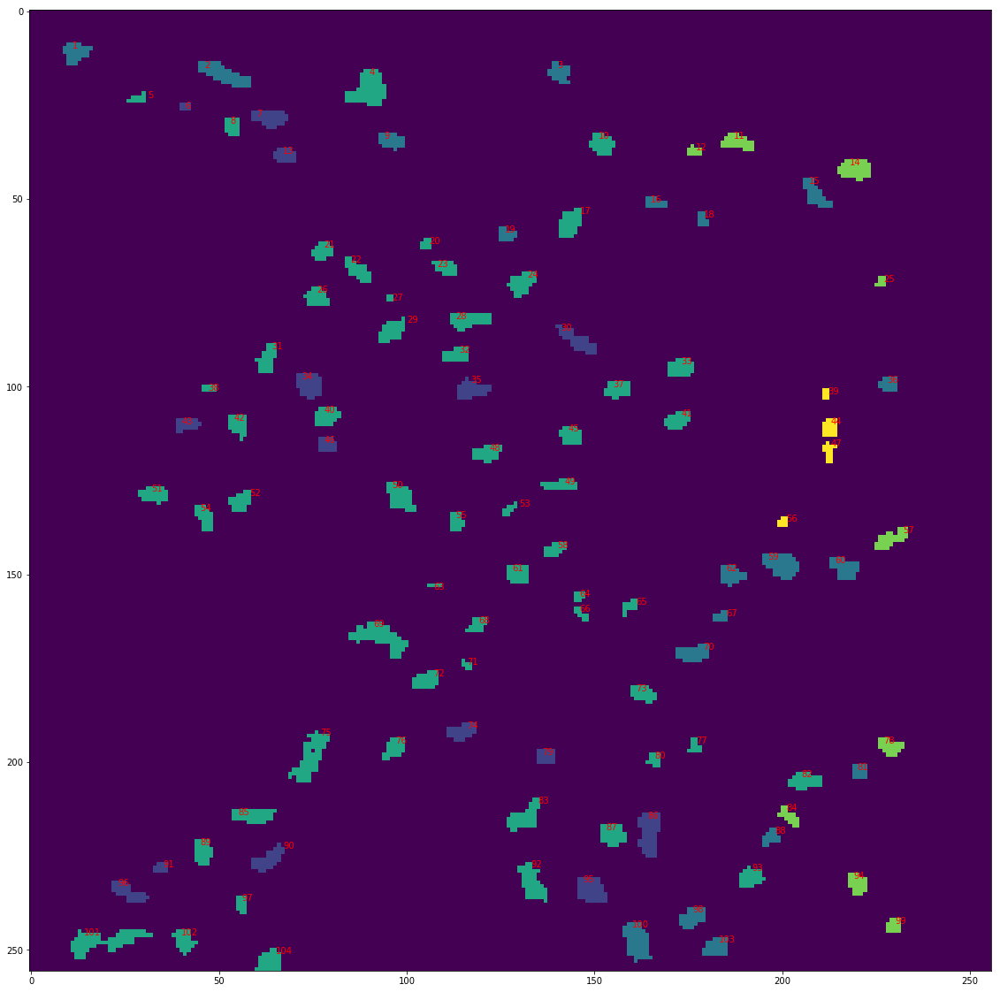

In [340]:
fig = plt.figure(figsize=(20,20))
plt.imshow(img2,cmap='viridis')
for i in range(num_cells):
    cur_idx = i + 1
    cur_ind = cell_pos[cell_idx==cur_idx][0]
#     print(ind2ij(cur_ind,256,0))
#     print(ind2ij(cur_ind,256,1))
    
    plt.annotate(str(cur_idx),(ind2ij(cur_ind,256,1),ind2ij(cur_ind,256,0)),color='red')

    
plt.show()

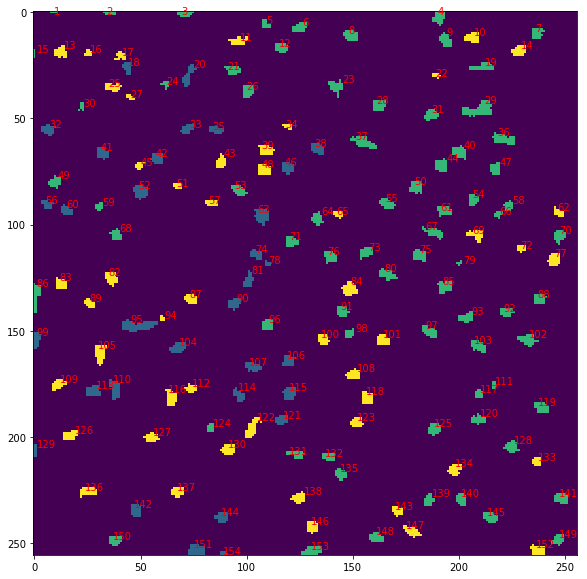

In [41]:
fig = plt.figure(figsize=(10,10))
plt.imshow(img)
for i in range(num_cells):
    cur_idx = i + 1
    cur_ind = cell_pos[cell_idx==cur_idx][0]
#     print(ind2ij(cur_ind,256,0))
#     print(ind2ij(cur_ind,256,1))
    
    plt.annotate(str(cur_idx),(ind2ij(cur_ind,256,1),ind2ij(cur_ind,256,0)),color='red')
plt.show()

In [234]:
# pred_y = KMeans(n_clusters=n_clusters).fit_predict(embed_mat)
# pred_y = AffinityPropagation().fit_predict(embed_mat)
metrics.normalized_mutual_info_score(pred_y, true_y)

0.16433223687508347

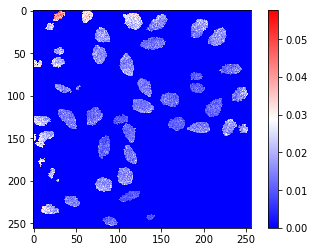

In [669]:
graph_mat = np.transpose(pred_t_softmax)
graph_mat_img = np.zeros(shape=(65536,))
graph_mat_img[cell_pos] = graph_mat[0,:]
graph_mat_img = graph_mat_img.reshape((256,256))
plt.imshow(graph_mat_img,cmap=plt.get_cmap('bwr'))
plt.colorbar()
plt.show()

In [358]:
# matter_list = np.array([51.01, 51.02, 51.99, 52.96, 53.04, 54.01, 54.04, 56.02, 56.06, 57.02, 57.04, 60.0, 64.97, 64.99, 65.96, 66.97, 68.05, 69.04, 70.01, 70.97, 70.98, 71.93, 72.97, 73.05, 79.42, 81.05, 81.95, 81.99, 82.03, 82.97, 84.05, 85.04, 86.0, 87.06, 88.02, 88.97, 90.01, 91.03, 92.02, 93.01, 93.04, 93.99, 94.03, 95.03, 95.96, 96.01, 96.05, 96.93, 97.93, 97.97, 101.03, 104.01, 105.03, 105.97, 106.03, 106.99, 107.03, 108.02, 109.01, 109.04, 109.98, 110.03, 110.98, 111.03, 111.96, 112.96, 113.04, 113.97, 114.93, 115.0, 117.02, 118.03, 120.02, 121.04, 122.03, 123.02, 123.99, 124.04, 124.97, 125.04, 126.05, 126.96, 127.06, 127.95, 128.05, 128.96, 129.11, 130.95, 131.03, 132.03, 133.01, 134.05, 135.04, 136.01, 136.29, 142.07, 143.05, 143.95, 144.04, 145.04, 146.04, 146.95, 147.02, 148.04, 149.04, 149.88, 150.05, 150.89, 150.98, 151.05, 151.89, 151.95, 153.02, 153.96, 154.07, 154.95, 156.94, 157.04, 157.92, 158.05, 159.04, 160.04, 161.04, 162.05, 163.02, 164.04, 165.03, 165.92, 166.92, 167.94, 168.06, 168.94, 169.95, 170.09, 170.94, 171.96, 172.03, 172.96, 173.05, 174.05, 176.05, 178.04, 180.05, 182.07, 183.93, 184.95, 185.07, 185.92, 186.06, 186.92, 187.97, 188.06, 189.06, 190.05, 191.05, 192.06, 193.05, 194.06, 201.06, 202.06, 202.91, 203.91, 204.05, 204.91, 205.06, 205.92, 206.06, 206.92, 207.05, 208.08, 208.93, 209.09, 209.94, 210.08, 210.94, 212.95, 213.89, 214.05, 216.06, 218.07, 221.07, 222.07, 223.89, 224.93, 225.92, 226.94, 228.9, 229.91, 230.85, 232.08, 232.87, 233.06, 233.87, 242.89, 243.9, 244.88, 245.89, 246.89, 247.88, 248.9, 249.9, 251.19, 253.21, 254.86, 255.22, 256.23, 261.86, 262.88, 263.88, 264.89, 265.87, 266.87, 268.88, 269.24, 269.89, 271.88, 277.21, 279.22, 281.24, 282.24, 282.87, 283.26, 284.87, 285.88, 287.88, 290.85, 291.86, 292.83, 293.84, 301.85, 302.86, 303.86, 304.86, 306.86, 308.85, 309.88, 314.84, 321.85, 322.86, 323.85, 324.85, 325.85, 333.82, 341.83, 342.84, 344.84, 346.85, 348.84, 350.82, 362.83, 363.83, 364.83, 365.83, 367.58, 380.81, 381.8, 382.82, 384.84, 386.83, 387.82, 402.81, 403.81, 404.81, 412.77, 424.81, 426.8, 433.77, 434.75, 440.78, 450.74, 456.75, 464.77, 504.79, 514.73, 520.75, 526.74, 542.74, 566.74, 576.68, 588.75, 668.68, 794.57, 795.58, 861.55, 883.56, 885.56])
matter_list = np.array([50.74, 51.01, 51.02, 51.97, 51.99, 52.96, 52.98, 53.04, 54.01, 54.04, 56.02, 56.06, 57.02, 57.04, 60.0, 64.97, 64.99, 65.96, 66.97, 68.05, 69.04, 70.01, 70.97, 70.98, 71.93, 72.97, 73.05, 79.43, 81.04, 81.95, 81.99, 82.03, 82.97, 84.05, 85.04, 86.0, 87.06, 88.02, 88.97, 90.01, 91.03, 92.02, 93.01, 93.04, 93.99, 94.03, 95.03, 95.96, 96.01, 96.05, 96.92, 97.93, 97.97, 101.03, 104.01, 105.03, 105.97, 106.03, 106.99, 107.03, 108.02, 109.01, 109.04, 109.98, 110.03, 110.98, 111.02, 111.96, 112.96, 113.04, 113.97, 114.93, 114.99, 117.02, 118.03, 120.02, 121.04, 122.03, 123.02, 123.99, 124.04, 124.97, 125.04, 126.04, 126.96, 127.06, 127.95, 128.04, 128.96, 129.11, 130.95, 131.03, 132.03, 133.01, 134.05, 135.04, 136.01, 136.29, 142.07, 143.04, 143.95, 144.03, 145.04, 146.04, 146.95, 147.02, 148.04, 149.04, 149.88, 150.05, 150.89, 150.98, 151.05, 151.89, 151.95, 153.02, 153.96, 154.06, 154.93, 156.93, 157.04, 157.92, 158.05, 159.04, 160.04, 161.04, 162.04, 163.02, 164.04, 165.03, 165.91, 166.92, 167.95, 168.05, 168.94, 169.95, 170.07, 170.94, 171.96, 172.03, 172.96, 173.05, 174.05, 176.04, 178.04, 180.05, 182.06, 183.93, 184.94, 185.06, 185.92, 186.05, 186.93, 187.97, 188.06, 189.05, 190.04, 191.05, 192.05, 193.04, 194.06, 201.06, 201.9, 202.06, 202.91, 203.91, 204.05, 204.91, 205.05, 205.92, 206.06, 206.92, 207.05, 208.08, 208.92, 209.09, 209.94, 210.07, 210.94, 212.96, 213.9, 214.05, 216.05, 218.06, 221.06, 222.07, 223.89, 224.92, 225.91, 226.94, 228.9, 229.91, 230.86, 232.07, 232.86, 233.06, 233.87, 242.89, 243.9, 244.88, 245.9, 246.9, 247.89, 248.91, 249.91, 253.23, 254.86, 255.24, 256.24, 261.87, 262.88, 263.88, 264.88, 265.88, 266.88, 268.88, 269.89, 271.89, 281.26, 282.26, 282.87, 283.27, 284.87, 285.88, 287.88, 290.86, 291.86, 292.86, 293.85, 301.85, 302.86, 303.86, 304.86, 306.86, 308.85, 309.88, 314.84, 321.85, 322.85, 323.85, 324.84, 325.85, 333.83, 341.83, 342.83, 344.83, 346.85, 348.85, 350.82, 362.83, 363.83, 364.83, 365.83, 367.58, 380.8, 381.8, 382.81, 384.83, 386.82, 387.82, 402.8, 403.81, 404.81, 412.77, 424.8, 426.8, 433.77, 434.75, 440.76, 450.75, 455.75, 456.74, 464.77, 494.72]);

In [20]:
matter_list.shape

(274,)

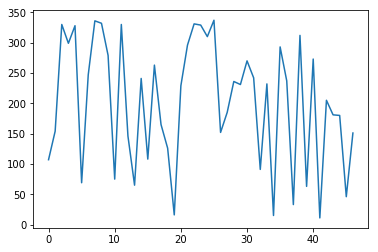

In [21]:
cell_pixel_dict = {}
pixel_count = []
for i in range(num_cells):
    cur_pixels = train_x[cell_idx==i+1,:]
    cell_pixel_dict[i] = cur_pixels
    pixel_count.append(cur_pixels.shape[0])
from scipy.stats import wasserstein_distance

dist_mat = np.zeros(shape=(num_features,num_cells,num_cells))
for k in range(num_features):
    print(k)
    
    for i in range(num_cells):
        for j in range(num_cells):
            cur_dist = wasserstein_distance(cell_pixel_dict[i][:,k],cell_pixel_dict[j][:,k])
            dist_mat[k,i,j] = cur_dist



In [23]:
from scipy.stats import wasserstein_distance

dist_mat = np.zeros(shape=(num_features,num_cells,num_cells))
for k in range(num_features):
    print(k)
    
    for i in range(num_cells):
        for j in range(num_cells):
            cur_dist = wasserstein_distance(cell_pixel_dict[i][:,k],cell_pixel_dict[j][:,k])
            dist_mat[k,i,j] = cur_dist


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273


In [214]:
sorted_dist_mat = dist_mat[np.argsort(pred_y),:][:,np.argsort(pred_y)]
plt.matshow(sorted_dist_mat)
plt.show()

ValueError: too many values to unpack (expected 2)

In [215]:
sorted_dist_mat.shape

(43, 43, 43)

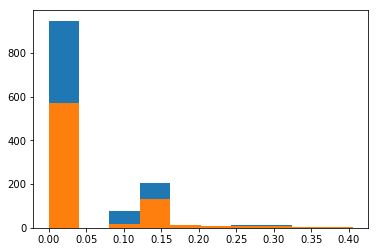

0.0037204922912060919

In [49]:
i=203
a = test_dict[0][:,i]
b = test_dict[1][:,i]
c = test_dict[2][:,i]
plt.hist(c)

plt.hist(a)

# plt.hist(test_dict[2][:,i])
plt.show()
aa = np.array([1,2,2,3,3,4])
bb = np.array([1,2,2,3,3,5])
cc = np.array([1,1,2,2,2,2,3,3,3,3,4,4])
dd = aa*2
wasserstein_distance(c,a)

In [42]:
# Preserving Stochastic Neighbors feature selections
def matching_loss(args):
    #要求输入的univariant_simi_val为距离
    simi_weight,softmax_val,univariant_simi_val = args
    simi_weight = simi_weight/(K.sum(simi_weight,axis=-1,keepdims=True)+K.epsilon())
    print('simi_weight',simi_weight.shape)
    print('softmax_val',softmax_val.shape)
    print('univariant_simi_val',univariant_simi_val.shape)
    weighted_simi = K.sum(simi_weight*univariant_simi_val,axis=-1,keepdims=True)
    weighted_simi = K.squeeze(weighted_simi,axis=-1)
    print('weighted_simi',weighted_simi.shape)
    p = softmax_val
#     q = K.pow(weighted_simi+1,-1)
    q = K.softmax(-weighted_simi)
    print('q',q.shape)
    
    q = q/(K.sum(q,axis=-1,keepdims=True)+K.epsilon())
    print('p',p.shape)
    kl1 = keras.losses.kullback_leibler_divergence(p,q)
    kl2 = keras.losses.kullback_leibler_divergence(q,p)
    kl1 = K.expand_dims(kl1,axis=1)
    kl2 = K.expand_dims(kl2,axis=1)
    
    rst = (kl1+kl2)/2
#     rst = kl1
    print('rst',rst.shape)
    return rst
def weight_entropy(args):
    simi_weight = args
    simi_weight = simi_weight/(K.sum(simi_weight,axis=-1,keepdims=True)+K.epsilon())
    simi_weight = K.squeeze(simi_weight,axis=1)
    print('simi_weight,,',simi_weight.shape)
    rst = K.sum(simi_weight*K.log(simi_weight),axis=-1,keepdims=True)
    return rst
softmax_input = Input(shape=(num_cells,))
univariant_simi_input = Input(shape=(num_cells,num_features))

dummy_input = Input(shape=(1,))
# embed_layer = Embedding(column_data.shape[1],1,input_length=column_data.shape[1],embeddings_initializer=Ones(),embeddings_constraint=non_neg())(dummy_input)

simi_weight_layer = Embedding(1,num_features,embeddings_constraint=non_neg(),embeddings_initializer=Ones())(dummy_input)
weight_entropy_layer = Lambda(weight_entropy,output_shape=(1,),name='entropy')(simi_weight_layer)
matching_layer = Lambda(matching_loss,output_shape=(1,),name='kld')([simi_weight_layer,softmax_input,univariant_simi_input])
selection_model = Model([softmax_input,univariant_simi_input,dummy_input],[matching_layer,weight_entropy_layer])
selection_model.compile(optimizer=adam(),loss=[lambda y_true,y_pred: y_pred,lambda y_true,y_pred: y_pred],loss_weights=[1,0.05])

simi_weight,, (?, 274)
simi_weight (?, 1, 274)
softmax_val (?, 47)
univariant_simi_val (?, 47, 274)
weighted_simi (?, 47)
q (?, 47)
p (?, 47)
rst (?, 1)


In [219]:
cell_idx

array([  1.,   1.,   1., ...,  43.,  43.,  43.])

In [43]:
softmax_input_val = pred_t_softmax
univariant_simi_input_val = np.zeros(shape=(pred_t_softmax.shape[0],num_cells,num_features))
for i in range(pred_t_softmax.shape[0]):
    no_cell = cell_idx[i].astype('int')-1
    to_add = np.transpose(dist_mat[:,:,no_cell])
    univariant_simi_input_val[i,:,:] = to_add
dummy_input_val = np.zeros(shape=(pred_t_softmax.shape[0],1))
output_val = np.zeros(shape=(pred_t_softmax.shape[0],1))

In [120]:
matching_model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 152)          0                                            
__________________________________________________________________________________________________
embedding_2 (Embedding)         (None, 152, 2)       304         input_6[0][0]                    
__________________________________________________________________________________________________
input_5 (InputLayer)            (None, 152)          0                                            
__________________________________________________________________________________________________
input_7 (InputLayer)            (None, 152)          0                                            
__________________________________________________________________________________________________
lambda_2 (

In [44]:
history = selection_model.fit([softmax_input_val,univariant_simi_input_val,dummy_input_val],[output_val,output_val],epochs=100,shuffle=True,batch_size=128)


Epoch 1/100
9487/9487 [==============================] - 2s 211us/step - loss: 0.1155 - kld_loss: 0.3962 - entropy_loss: -5.6127
Epoch 2/100
9487/9487 [==============================] - 1s 106us/step - loss: 0.1153 - kld_loss: 0.3958 - entropy_loss: -5.6108
Epoch 3/100
9487/9487 [==============================] - 1s 107us/step - loss: 0.1152 - kld_loss: 0.3956 - entropy_loss: -5.6086
Epoch 4/100
9487/9487 [==============================] - 1s 104us/step - loss: 0.1151 - kld_loss: 0.3954 - entropy_loss: -5.6063
Epoch 5/100
9487/9487 [==============================] - 1s 104us/step - loss: 0.1150 - kld_loss: 0.3952 - entropy_loss: -5.6043
Epoch 6/100
9487/9487 [==============================] - 1s 102us/step - loss: 0.1150 - kld_loss: 0.3951 - entropy_loss: -5.6025
Epoch 7/100
9487/9487 [==============================] - 1s 106us/step - loss: 0.1150 - kld_loss: 0.3950 - entropy_loss: -5.6010
Epoch 8/100
9487/9487 [==============================] - 1s 110us/step - loss: 0.1149 - kld_loss:

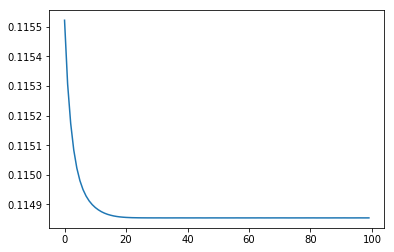

In [45]:
plt.plot(history.history['loss'])
plt.show()

(274,)


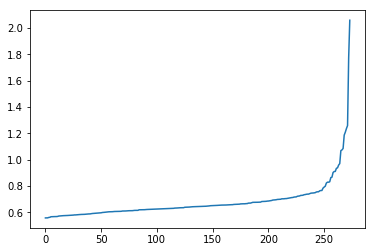

[ 0.55876875  0.55888289  0.55920255  0.5623185   0.56351876  0.56771833
  0.56826079  0.56827503  0.56871736  0.56888348  0.56913996  0.57008934
  0.57296121  0.57377106  0.57495886  0.57513648  0.57581115  0.57604939
  0.57670105  0.5767445   0.57736796  0.57785648  0.57836956  0.57858151
  0.57999772  0.58018589  0.58143324  0.58149827  0.58252847  0.58344531
  0.5837605   0.5847435   0.58511114  0.58528775  0.5854367   0.58596605
  0.5868898   0.58748209  0.58841604  0.58907211  0.58912158  0.59076339
  0.59218723  0.59278244  0.5929907   0.59384441  0.59496123  0.5959484
  0.59642828  0.59677345  0.59770703  0.59978998  0.60019624  0.60137212
  0.60249561  0.60443842  0.60502589  0.60523027  0.60532349  0.60547984
  0.60592794  0.60709238  0.60757297  0.60762066  0.6082412   0.60854137
  0.60856658  0.60857081  0.60903043  0.61097437  0.611027    0.6112904
  0.61146253  0.61231047  0.6128968   0.6133973   0.61351025  0.61358202
  0.6137687   0.61523592  0.61594337  0.61598349  0.6

In [47]:

feature_weight = Model(dummy_input,simi_weight_layer).layers[-1].get_weights()[0]
feature_weight = np.transpose(feature_weight)[:,0]
print(feature_weight.shape)
plt.plot(np.sort(feature_weight))
plt.show()
print(np.sort(feature_weight))
print(np.argsort(feature_weight))
# np.max(np.argsort(feature_weight))
# np.sort(feature_weight)[-50]
print(matter_list[np.argsort(feature_weight)])

In [531]:
#选出top50的物质，选每个细胞最中间的作为代表，按cluster画出heatmap
# top50_idx = np.argsort(feature_weight)[:]
_,unique_idx = np.unique(cell_idx,return_index=True)
true_y = cell_type[unique_idx]
cluster1_mat = None
cluster2_mat = None
for i in range(num_cells):
    cur_cluster = true_y[i]
#     to_add = np.median(train_x[cell_idx==i+1,:][:,top50_idx],axis=0)
#     to_add = train_x[cell_idx==i+1,:][:,top50_idx]
    to_add = train_x[cell_idx==i+1,:]

    if cur_cluster == 1:
        if cluster1_mat is None:
            cluster1_mat = to_add
        else:
            cluster1_mat = np.vstack([cluster1_mat,to_add])
    else:
        if cluster2_mat is None:
            cluster2_mat = to_add
        else:
            cluster2_mat = np.vstack([cluster2_mat,to_add])
cluster_both_mat = np.vstack([cluster1_mat,cluster2_mat])

In [532]:
# a = cluster1_mat[:,-2]
# b = cluster2_mat[:,-2]
# plt.hist(a)
# plt.hist(b)

# plt.show()
# wasserstein_distance(a,b)
dist_list = np.zeros(shape=(274))
for i in range(274):
    a = cluster1_mat[:,i]
    b = cluster2_mat[:,i]
    dist_list[i] = wasserstein_distance(a,b)

In [ ]:
plt.plot(np.sort(dist_list))
plt.show()

In [529]:
selected_idx = np.argsort(dist_list)[200:274]
selected_matters = matter_list[selected_idx]
selected_distances = dist_list[selected_idx]
with open('DE_analysis_0828.txt','a') as f:
    f.write('AB-H-3\n')
    f.write('\t'.join(list(map(str,list(selected_matters))))+'\n')
    f.write('\t'.join(list(map(str,list(selected_distances))))+'\n')
    
#     f.write('\t'.join(str(list(selected_distances)))+'\n')

In [510]:
list(map(str,list(selected_distances)))

['0.0304268375908',
 '0.0305296697786',
 '0.031109432689',
 '0.031643957341',
 '0.0318475539959',
 '0.0331695771596',
 '0.0332414234268',
 '0.0332928069369',
 '0.0335357392983',
 '0.0341958611083',
 '0.0343839028043',
 '0.0343969519138',
 '0.034400545989',
 '0.0347105267803',
 '0.0353994294846',
 '0.0354125954043',
 '0.0367020259554',
 '0.036733512939',
 '0.0369750463734',
 '0.0370846528749',
 '0.0379327883795',
 '0.0381811059802',
 '0.0402428243484',
 '0.0406356983665',
 '0.0410912111235',
 '0.0411118249901',
 '0.0431450288641',
 '0.0436897330683',
 '0.0440985712114',
 '0.0449314744738',
 '0.04729844112',
 '0.0474205624986',
 '0.0476649150299',
 '0.0495172881402',
 '0.0517461306764',
 '0.0527032006646',
 '0.0529986912753',
 '0.0533189529261',
 '0.0535022719539',
 '0.0542051945891',
 '0.0555183739307',
 '0.0555389179171',
 '0.0556585908608',
 '0.0569220124774',
 '0.0570115609186',
 '0.057160916868',
 '0.0578905690712',
 '0.0582384611258',
 '0.0584589071328',
 '0.0611205493657',
 '0.063

In [364]:
cluster1_bak = cluster1_mat
cluster2_bak = cluster2_mat
top50_idx = np.argsort(dist_list)
top50_matter = matter_list[top50_idx]


In [365]:
#选出top50的物质，选每个细胞最中间的作为代表，按cluster画出heatmap
# top50_idx = np.argsort(feature_weight)[:]
cluster1_mat = None
cluster2_mat = None
for i in range(num_cells):
    cur_cluster = true_y[i]
    to_add = np.median(train_x[cell_idx==i+1,:][:,top50_idx],axis=0)
#     to_add = train_x[cell_idx==i+1,:][:,top50_idx]
#     to_add = train_x[cell_idx==i+1,:]

    if cur_cluster == 1:
        if cluster1_mat is None:
            cluster1_mat = to_add
        else:
            cluster1_mat = np.vstack([cluster1_mat,to_add])
    else:
        if cluster2_mat is None:
            cluster2_mat = to_add
        else:
            cluster2_mat = np.vstack([cluster2_mat,to_add])
cluster_both_mat = np.vstack([cluster1_mat,cluster2_mat])

/home/yzy/anaconda3/envs/tensorflow/lib/python3.6/site-packages/ipykernel/__main__.py:2: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


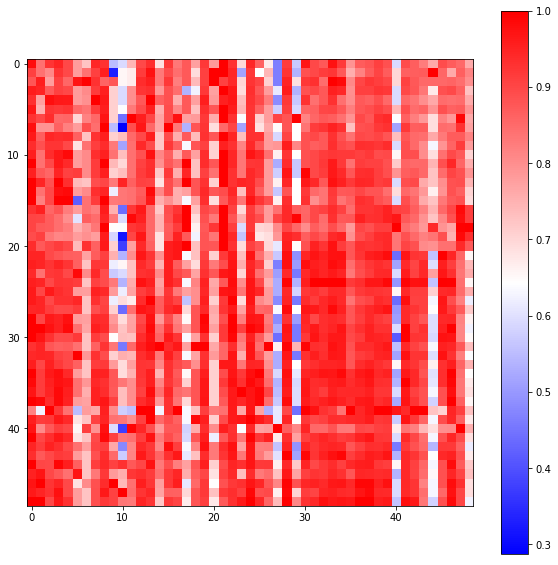

In [366]:
plt.figure(figsize=(10,10))
cluster_both_mat = cluster_both_mat/np.max(cluster_both_mat,axis=0)
plt.imshow(cluster_both_mat[:,-50:-1],cmap=plt.get_cmap('bwr'))
plt.colorbar()
plt.show()

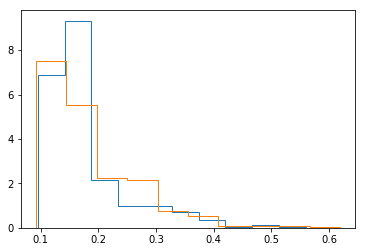

In [254]:
num = -28
c1 = cluster1_bak[:,num]!=0
c2 = cluster2_bak[:,num]!=0
cc1 = cluster1_bak[c1,num]
cc2 = cluster2_bak[c2,num]
plt.hist(cc1,histtype='step',normed=True)
plt.hist(cc2,histtype='step',normed=True)
plt.show()

In [228]:
np.sum(train_x==0)

774243

In [187]:
top50_matter

array([ 263.88,  146.95,  169.95,   90.01,  126.96,  302.86,  153.02,
        424.8 ,  246.9 ,  247.89,  117.02,  206.92,  184.94,   91.03,
        101.03,  224.92,  107.03,   81.99,   92.02,  188.06,  149.04,
        183.93,  402.8 ,  132.03,  261.87,  131.03,   93.01,  150.05,
        362.83,  136.01,   86.  ,  166.92,  322.85,  284.87,  108.02,
         95.96,   82.97,  106.03,   60.  ,  133.01,  170.94,  262.88,
        112.96,  223.89,  154.93,   93.99,  106.99,  244.88,  128.96,
         81.95])

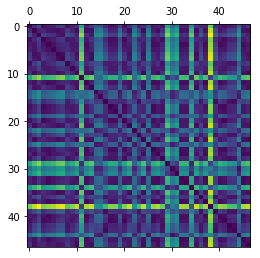

In [151]:
label_sort = np.argsort(true_y)
to_draw = dist_mat[40,label_sort,:][:,label_sort]
plt.matshow(to_draw)
plt.show()

In [35]:
#t test
test_dict = {}
for i in range(num_cells):
    cur_pixels = train_x[cell_idx==i+1,:]
    cur_label = pred_y[i]
    if cur_label not in test_dict:
        test_dict[cur_label] = cur_pixels
    else:
        test_dict[cur_label] = np.vstack([test_dict[cur_label],cur_pixels])

In [1592]:
from scipy.stats import ttest_ind
st,pv = ttest_ind(test_dict[1],test_dict[2],equal_var=False)

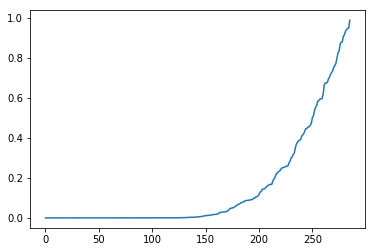

array([  51.99,   52.96,   70.98,   71.93,   79.42,   82.97,   86.  ,
         88.02,   91.03,   93.04,   96.93,  105.03,  113.97,  114.93,
        115.  ,  118.03,  120.02,  122.03,  123.02,  125.04,  130.95,
        136.01,  136.29,  143.05,  145.04,  146.04,  147.02,  148.04,
        149.88,  150.89,  151.05,  151.89,  153.02,  153.96,  157.04,
        158.05,  161.04,  162.05,  164.04,  165.03,  168.94,  173.05,
        174.05,  178.04,  180.05,  185.07,  186.06,  187.97,  188.06,
        189.06,  190.05,  191.05,  193.05,  201.06,  202.06,  203.91,
        204.05,  205.06,  206.06,  207.05,  208.08,  209.09,  209.94,
        210.94,  214.05,  216.06,  218.07,  221.07,  222.07,  225.92,
        226.94,  232.08,  232.87,  233.06,  233.87,  248.9 ,  249.9 ,
        251.19,  253.21,  254.86,  256.23,  261.86,  263.88,  265.87,
        268.88,  269.24,  269.89,  271.88,  277.21,  282.24,  287.88,
        290.85,  292.83,  293.84,  301.85,  302.86,  303.86,  304.86,
        308.85,  309

In [1594]:
# plt.plot(st)

plt.plot(np.sort(pv))
# plt.plot(pv)

plt.show()
np.argsort(pv)
matter_list[np.where(pv>=0.01)[0]]
# pv[91]

In [460]:
np.unique(true_labeling)

array([  0.,   1.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,
        11.,  12.,  13.,  14.,  15.,  16.,  17.,  18.,  19.,  20.,  21.,
        22.,  23.,  24.,  25.,  26.,  27.,  28.,  29.,  30.,  31.,  32.,
        33.,  34.,  35.,  36.,  37.])

In [89]:
LINE_dir = '/home/yzy/software/SCRL/SIMS/'
with open(LINE_dir+'net_pixel_pixel','w') as f:
    for i in range(cell_idx.shape[0]):
        for j in range(cell_idx.shape[0]):
            to_write = 'pixel_'+str(i)+' '+'pixel_'+str(j)+' '+str(int(cell_idx[i]==cell_idx[j]))+'\n'
            f.write(to_write)
        

In [163]:
LINE_dir = '/home/yzy/software/SCRL/SIMS/'
with open(LINE_dir+'net_nuclei_pixel_50','w') as f:
    for i in range(pred_t_softmax.shape[0]):
        for j in range(pred_t_softmax.shape[1]):
#             to_write1 = 'pixel_'+str(i)+' '+'nuclei_'+str(j)+' '+str(pred_t_softmax[i,j])+'\n'
            to_write2 = 'nuclei_'+str(j)+' '+'pixel_'+str(i)+' '+str(pred_t_softmax[i,j])+'\n'
#             to_write1 = 'u'+str(i)+'\t'+'i'+str(j)+'\t'+str(pred_t_softmax[i,j])+'\n'

#             f.write(to_write1)
            f.write(to_write2)
        

In [169]:
LINE_dir = '/home/yzy/software/SCRL/'
embed_dim = 2
nuclei_embed = np.zeros(shape=(pred_t_softmax.shape[1],embed_dim))
pixel_embed = np.zeros(shape=(pred_t_softmax.shape[0],embed_dim))

with open(LINE_dir+'cell_emb.txt','r') as f:
    
    for row in f:
        row_sp = row.split(' ')
        row_type = row_sp[0].split('_')[0]
        row_idx = int(row_sp[0].split('_')[1])
        row_embed = row_sp[1:-1]
        row_embed = np.array(row_embed).astype(np.float64)
#         row_embed_0 = float(row_sp[1])
#         row_embed_1 = float(row_sp[2]) 
        print(row_type,row_idx,row_embed)
        if(row_type=='nuclei'):
            nuclei_embed[row_idx,:] = row_embed
#             nuclei_embed[row_idx,0] = row_embed_0
#             nuclei_embed[row_idx,1] = row_embed_1
        else:
#             pixel_embed[row_idx,0] = row_embed_0
#             pixel_embed[row_idx,1] = row_embed_1
            pixel_embed[row_idx,:] = row_embed

            
        
        

nuclei 0 [ 0.232707  0.139436]
nuclei 1 [ 0.234268  0.136097]
nuclei 2 [ 0.231771  0.140477]
nuclei 3 [ 0.249351  0.106731]
nuclei 4 [ 0.364132 -0.117503]
nuclei 5 [ 0.224459  0.154748]
nuclei 6 [ 0.225686  0.152619]
nuclei 7 [ 0.219308  0.164997]
nuclei 8 [ 0.229879  0.144102]
nuclei 9 [ 0.219079  0.165104]
nuclei 10 [ 1.492541 -2.314886]
nuclei 11 [-1.094505  2.714286]
nuclei 12 [ 0.236082  0.131967]
nuclei 13 [ 0.181406  0.238418]
nuclei 14 [ 0.226814  0.150437]
nuclei 15 [ 0.22357   0.156107]
nuclei 16 [ 0.224549  0.154813]
nuclei 17 [ 0.246729  0.111855]
nuclei 18 [ 0.230898  0.14247 ]
nuclei 19 [-1.089455  2.70181 ]
nuclei 20 [ 0.222257  0.158781]
nuclei 21 [ 0.218594  0.165881]
nuclei 22 [ 0.243787  0.117463]
nuclei 23 [ 0.22991   0.144594]
nuclei 24 [-1.091218  2.704129]
nuclei 25 [-1.085663  2.69554 ]
nuclei 26 [ 0.218374  0.166543]
nuclei 27 [-1.082301  2.687123]
nuclei 28 [ 0.240753  0.122944]
nuclei 29 [ 0.312982 -0.017606]
nuclei 30 [-1.091842  2.707528]
nuclei 31 [ 0.2239

In [66]:
pixel_embed.shape

(4287, 32)

In [ ]:
from scipy.stats import spearmanr
corr_mat = np.zeros(shape=(pred_t_softmax.shape[0],pred_t_softmax.shape[0]))
for i in range(pred_t_softmax.shape[0]):
    for j in range(pred_t_softmax.shape[0]):
        print(i,j)
        corr = spearmanr(pred_t_softmax[i,:],pred_t_softmax[j,:])[0]
        corr_mat[i,j] = corr
np.save('corr.npy',corr_mat)

0 0
0 1
0 2
0 3
0 4
0 5
0 6
0 7
0 8
0 9
0 10
0 11
0 12
0 13
0 14
0 15
0 16
0 17
0 18
0 19
0 20
0 21
0 22
0 23
0 24
0 25
0 26
0 27
0 28
0 29
0 30
0 31
0 32
0 33
0 34
0 35
0 36
0 37
0 38
0 39
0 40
0 41
0 42
0 43
0 44
0 45
0 46
0 47
0 48
0 49
0 50
0 51
0 52
0 53
0 54
0 55
0 56
0 57
0 58
0 59
0 60
0 61
0 62
0 63
0 64
0 65
0 66
0 67
0 68
0 69
0 70
0 71
0 72
0 73
0 74
0 75
0 76
0 77
0 78
0 79
0 80
0 81
0 82
0 83
0 84
0 85
0 86
0 87
0 88
0 89
0 90
0 91
0 92
0 93
0 94
0 95
0 96
0 97
0 98
0 99
0 100
0 101
0 102
0 103
0 104
0 105
0 106
0 107
0 108
0 109
0 110
0 111
0 112
0 113
0 114
0 115
0 116
0 117
0 118
0 119
0 120
0 121
0 122
0 123
0 124
0 125
0 126
0 127
0 128
0 129
0 130
0 131
0 132
0 133
0 134
0 135
0 136
0 137
0 138
0 139
0 140
0 141
0 142
0 143
0 144
0 145
0 146
0 147
0 148
0 149
0 150
0 151
0 152
0 153
0 154
0 155
0 156
0 157
0 158
0 159
0 160
0 161
0 162
0 163
0 164
0 165
0 166
0 167
0 168
0 169
0 170
0 171
0 172
0 173
0 174
0 175
0 176
0 177
0 178
0 179
0 180
0 181
0 182
0 183
0 184


In [1124]:
corr_mat.shape

(4287, 4287)

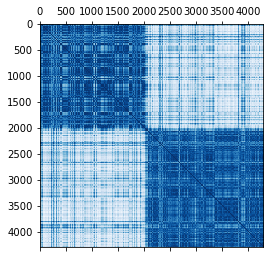

In [1130]:
data=corr_mat
model = SpectralCoclustering(n_clusters=2, random_state=0)
model.fit(data)
fit_data = data[np.argsort(model.row_labels_)]
fit_data = fit_data[:, np.argsort(model.column_labels_)]

plt.matshow(fit_dataa, cmap=plt.cm.Blues)
plt.show()

In [46]:
# neural networl based collaborative filtering
num_nuclei = pred_t_softmax.shape[1]
num_pixel = pred_t_softmax.shape[0]
low_dim = 2
nuclei_input = Input(shape=(1,))
pixel_input = Input(shape=(1,))
nuclei_embed = Embedding(num_nuclei,low_dim,embeddings_initializer='random_uniform')(nuclei_input)
pixel_embed = Embedding(num_pixel,low_dim,embeddings_initializer='random_uniform')(pixel_input)
concate_embed = Concatenate()([nuclei_embed,pixel_embed])
concate_embed = Reshape((low_dim+low_dim,))(concate_embed)
NCF_layer1 = Dense(4,activation='relu')(concate_embed)
NCF_layer2 = Dense(4,activation='relu')(NCF_layer1)
NCF_layer3 = Dense(4,activation='relu')(NCF_layer2)
score_output = Dense(1,activation='sigmoid')(NCF_layer3)
NCF_model = Model([nuclei_input,pixel_input],score_output)
NCF_model.compile(loss='binary_crossentropy',optimizer='adam')




In [28]:
NCF_model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           (None, 1)            0                                            
__________________________________________________________________________________________________
input_13 (InputLayer)           (None, 1)            0                                            
__________________________________________________________________________________________________
embedding_9 (Embedding)         (None, 1, 128)       19456       input_12[0][0]                   
__________________________________________________________________________________________________
embedding_10 (Embedding)        (None, 1, 128)       548736      input_13[0][0]                   
__________________________________________________________________________________________________
concatenat

In [51]:
nuclei_idx = np.zeros(shape=(num_nuclei*num_pixel,))
pixel_idx = np.zeros(shape=(num_nuclei*num_pixel,))
score_target = np.zeros(shape=(num_nuclei*num_pixel,))
k = 0
for i in range(num_pixel):
    for j in range(num_nuclei):
        nuclei_idx[k] = j
        pixel_idx[k] = i
        score_target[k] = pred_t_softmax[i,j]
nuclei_onehot = keras.utils.to_categorical(nuclei_idx,num_nuclei)
pixel_onehot = keras.utils.to_categorical(pixel_idx,num_pixel)
history = NCF_model.fit([nuclei_idx,pixel_idx],score_target,epochs=100,shuffle=True,batch_size=1024)

        

Epoch 1/100
651624/651624 [==============================] - 4s 6us/step - loss: 0.0195
Epoch 2/100
651624/651624 [==============================] - 4s 6us/step - loss: 0.0148
Epoch 3/100
651624/651624 [==============================] - 4s 6us/step - loss: 0.0113
Epoch 4/100
651624/651624 [==============================] - 4s 6us/step - loss: 0.0086
Epoch 5/100
651624/651624 [==============================] - 4s 5us/step - loss: 0.0066
Epoch 6/100
651624/651624 [==============================] - 4s 5us/step - loss: 0.0050
Epoch 7/100
651624/651624 [==============================] - 4s 5us/step - loss: 0.0039
Epoch 8/100
651624/651624 [==============================] - 4s 6us/step - loss: 0.0030
Epoch 9/100
651624/651624 [==============================] - 4s 5us/step - loss: 0.0023
Epoch 10/100
651624/651624 [==============================] - 4s 5us/step - loss: 0.0017
Epoch 11/100
651624/651624 [==============================] - 4s 5us/step - loss: 0.0013
Epoch 12/100
651624/651624 [==

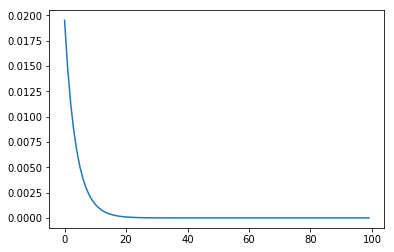

In [52]:
plt.plot(history.history['loss'])
plt.show()

In [53]:
nuclei_model = Model(nuclei_input,nuclei_embed)
pixel_model = Model(pixel_input,pixel_embed)
nuclei_represent = nuclei_model.layers[-1].get_weights()[0]
pixel_represent = pixel_model.layers[-1].get_weights()[0]

In [54]:
nuclei_represent.shape

(152, 2)

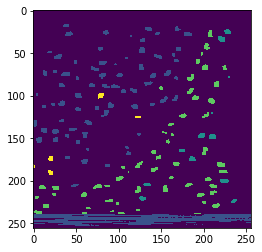

In [1150]:
# pixel_label = np.zeros(shape=(65536,))
# pixel_label[cell_dict[3]!=0] = 2
pixel_img = labeling.reshape((256,256))
plt.imshow(pixel_img)
plt.show()

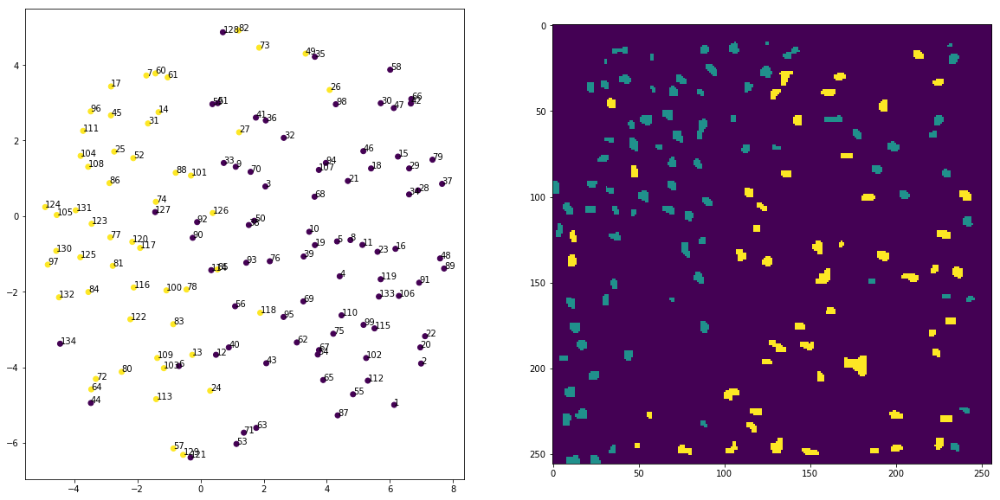

In [593]:
fig = plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.scatter(softmax_embed_2d[:,0],softmax_embed_2d[:,1],c=model.column_labels_)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(softmax_embed_2d[i,0],softmax_embed_2d[i,1]))
    
plt.subplot(1,2,2)
labeling = get_labeling(model.column_labels_,cell_idx)
img = labeling.reshape((256,256))
# img = np.transpose(img)

plt.imshow(img)
plt.show()

In [367]:
y_2 = model.column_labels_

In [368]:
from sklearn import metrics
metrics.adjusted_rand_score(y_2,y_1)

0.76772457067671707

In [527]:
embed_model = Model(SIMS_input,d4)
pixel_embed = embed_model.predict(train_x)
nuclei_model = Model(dummy_input,embed_layer)
weight_embed = nuclei_model.layers[-1].get_weights()[0]
# pixel_embed = pixel_embed/np.sqrt(np.sum(np.square(pixel_embed),axis=-1)[:,None])

center_model = Model(target_input,centerloss_embed_layer)
center_embed = center_model.layers[-1].get_weights()[0]
# weight_embed = weight_embed/np.sqrt(np.sum(np.square(weight_embed),axis=-1)[:,None])

tmp = lambda x:cell_type[cell_idx==x][0]
tmp_map = np.vectorize(tmp)
centers_label = tmp_map(np.unique(cell_idx))

simi_mat = np.dot(weight_embed,np.transpose(weight_embed))

# arccos_mat = np.arccos(simi_mat)

from sklearn.manifold import TSNE,Isomap,LocallyLinearEmbedding
weight_embed_2d = TSNE(n_components=2,verbose=1,metric='euclidean',perplexity=15,method='exact',n_iter=1000).fit_transform(weight_embed)
# weight_embed_2d = LocallyLinearEmbedding(n_components=2,n_neighbors=5).fit_transform(weight_embed)
# pixel_embed_2d = TSNE(early_exaggeration=12,n_components=2,verbose=1,metric='cosine',perplexity=30,method='exact',n_iter=1000).fit_transform(pixel_embed)
softmax_embed_2d = TSNE(n_components=2,verbose=1,metric='euclidean',perplexity=15,method='exact',n_iter=1000).fit_transform(np.transpose(softmax_rst))

[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 134 / 134
[t-SNE] Mean sigma: 0.841822
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.388601
[t-SNE] Error after 1000 iterations: 0.105099
[t-SNE] Computing pairwise distances...
[t-SNE] Computed conditional probabilities for sample 135 / 135
[t-SNE] Mean sigma: 1.981484
[t-SNE] KL divergence after 250 iterations with early exaggeration: 141.506843
[t-SNE] Error after 1000 iterations: 1.874360


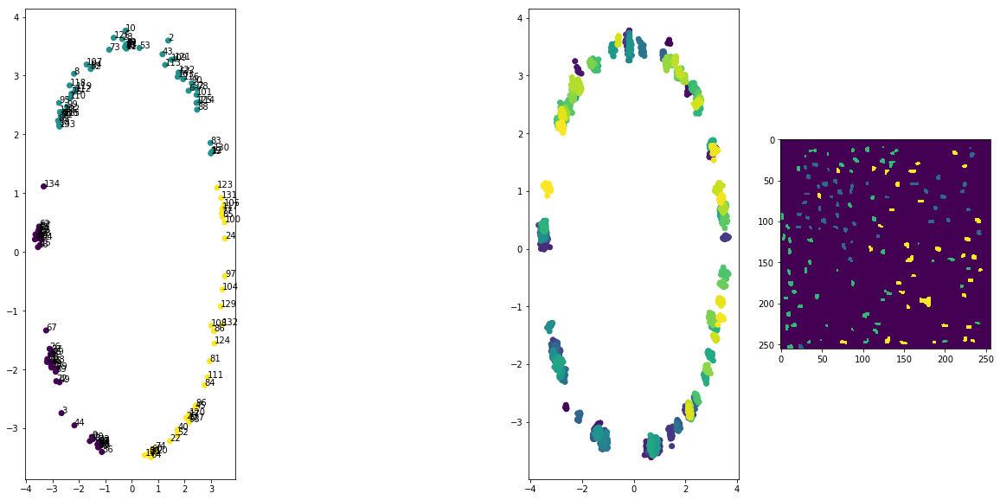

In [528]:
import matplotlib.pyplot as plt

n_clusters = 3
plt.figure(figsize=(20,10))

from sklearn.cluster import *

t = 20
# pred_y=AffinityPropagation(affinity='precomputed',damping=0.6).fit_predict(np.dot(weight_embed,np.transpose(weight_embed)))
# pred_y=SpectralClustering(affinity='gaussian',n_clusters=n_clusters).fit_predict(weight_embed)
pred_y = KMeans(n_clusters=n_clusters).fit_predict(weight_embed)
# pred_y = KMeans(n_clusters=n_clusters).fit_predict(np.transpose(softmax_rst))
# pred_y = model.row_labels_
# pred_y = AgglomerativeClustering(n_clusters=4).fit_predict(weight_embed)
# pred_y = DBSCAN().fit_predict(weight_embed)
plt.subplot(1,4,1)

plt.scatter(weight_embed[:,0],weight_embed[:,1],c=pred_y)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(weight_embed[i,0],weight_embed[i,1]))
    
# plt.subplot(1,4,2)
# plt.scatter(softmax_embed_2d[:,0],softmax_embed_2d[:,1],c=pred_y)
# for i in range(num_cells):
#     cur_idx = i + 1
#     plt.annotate(str(cur_idx),(softmax_embed_2d[i,0],softmax_embed_2d[i,1]))


plt.subplot(1,4,3)

plt.scatter(pixel_embed[:,0],pixel_embed[:,1],c=cell_idx)
    
plt.subplot(1,4,4)
labeling = get_labeling(pred_y,cell_idx)
img = labeling.reshape((256,256))
# img = np.transpose(img)

plt.imshow(img)
plt.show()

In [303]:
pred_y_bicluster_2_2 = pred_y

In [143]:
pred_y_MLP_euc_unnorm_1_2 = pred_y

In [304]:
from sklearn import metrics
metrics.adjusted_rand_score(pred_y_bicluster_2_2,pred_y_bicluster_2_1)

0.57891123229069019

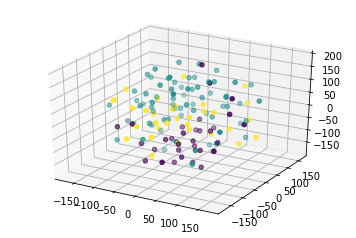

In [80]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(weight_embed_2d[:,0],weight_embed_2d[:,1],weight_embed_2d[:,2],c=pred_y)
plt.show()

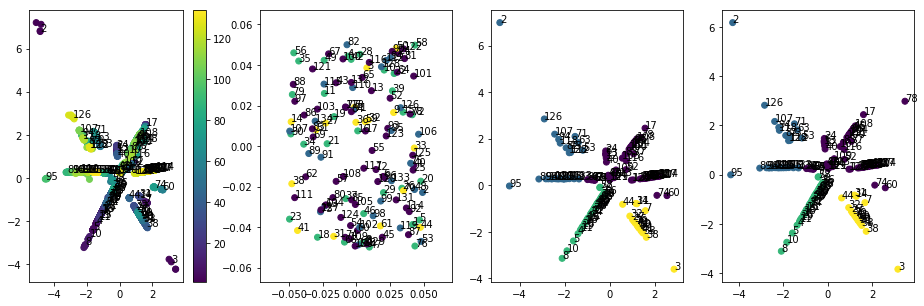

In [484]:
# embed_test.shape

import matplotlib.pyplot as plt
# %matplotlib inline
# %config InlineBackend.figure_format='svg'
plt.figure(figsize=(20,5))
plt.subplot(1,5,1)

plt.scatter(pixel_embed[:,0],pixel_embed[:,1],c=cell_idx)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(pixel_embed[cell_idx==cur_idx,0][0],pixel_embed[cell_idx==cur_idx,1][0]))
plt.colorbar()
plt.subplot(1,5,3)
plt.scatter(clusters_center[:,0],clusters_center[:,1],c=pred_y)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(clusters_center[i,0],clusters_center[i,1]))

plt.subplot(1,5,4)
plt.scatter(weight_embed[:,0],weight_embed[:,1],c=pred_y)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(weight_embed[i,0],weight_embed[i,1]))



# plt.colorbar()

plt.subplot(1,5,2)
plt.scatter(center_embed[:,0],center_embed[:,1],c=pred_y)
for i in range(num_cells):
    cur_idx = i + 1
    plt.annotate(str(cur_idx),(center_embed[i,0],center_embed[i,1]))


# plt.subplot(1,5,5)



# plt.scatter(pixel_embed_2d[:,0],pixel_embed_2d[:,1],c=cell_type)
# for i in range(num_cells):
#     cur_idx = i + 1
#     plt.annotate(str(cur_idx),(pixel_embed[cell_idx==cur_idx,0][0],pixel_embed[cell_idx==cur_idx,1][0]))

plt.show()

In [483]:
np.mean(pixel_embed[cell_idx==7],axis=0) 
clusters_center = np.zeros(shape=center_embed.shape)
for i in range(num_cells):
    clusters_center[i,:] = np.mean(pixel_embed[cell_idx==i+1],axis=0) 
    

In [59]:
pred_y.shape[0]

134

In [39]:
batch1

array([[ 0.10526316,  0.25438596,  0.05263158, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.06504065,  0.3495935 ,  0.04878049, ...,  0.        ,
         0.        ,  0.01626016],
       [ 0.05882353,  0.26890756,  0.05042017, ...,  0.        ,
         0.00840336,  0.        ],
       ..., 
       [ 0.1010101 ,  0.37373737,  0.05050505, ...,  0.01010101,
         0.        ,  0.        ],
       [ 0.125     ,  0.34090909,  0.125     , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.13513514,  0.41891892,  0.14864865, ...,  0.        ,
         0.        ,  0.        ]])

In [70]:
batch1 = batch_dict_134[1][cell_dict[1]!=0,:]

In [71]:
from scipy.stats import entropy
entropy_li = []
var_li = []
normed_var_li = []
for i in range(batch1.shape[1]):
    cur_col = batch1[:,i]
#     cur_col= cur_row/np.sum(cur_col)
    cur_entropy = entropy(cur_col)
    cur_var = np.var(cur_col)
    cur_normed_var = cur_var/np.mean(cur_col)
    entropy_li.append(cur_entropy)
    var_li.append(cur_var)
    normed_var_li.append(cur_normed_var)
entropy_li = np.array(entropy_li)
var_li = np.array(var_li)
normed_var_li = np.array(normed_var_li)

In [86]:
sort_val = np.sort(normed_var_li)
sort_ind = np.flip(np.argsort(normed_var_li),axis=0)

In [87]:
sort_ind+2

array([206, 204, 220,  70, 207, 219, 221, 223,  89,  84,  33, 203,  68,
         3,  46, 114,  65,  52,  85, 218,  25, 112,  34,  57, 215,  62,
         9,  63,  45,   8,  35,   7,  99,  30,  32, 103, 126,  47,  77,
        19,  86,  20,  48,  66,  29,  38,  15,  39,  88,  79,  97,  42,
        12,  81,  27,  13, 118,  82,  64,  61, 108,  94,  44,  59, 149,
        18,  36, 132, 116,   6,  87, 117,   4,  95, 182,  92, 131,  75,
        58,  40,  60, 134,  55,  78,  10, 158, 146, 110, 135,  98,  41,
       139,  11,  71,  76,  56, 111,  69, 171, 123, 173,  72,  73, 128,
       127,  54,  91, 122, 162, 106, 125, 175,  43,   2,  90,  83,  80,
       195, 130,  74, 120,  22, 185, 101, 170, 197, 159, 163, 143, 154,
       124, 165, 157,  51,  49, 145, 115, 136, 142,  28, 105, 155, 168,
        14,  31, 102,  37, 187, 184, 153, 147, 190, 113, 166, 144, 140,
       209, 129, 100, 167, 169, 232, 191, 161, 222, 160, 141, 104, 151,
       148,  26,  21, 174,  24, 150, 119, 181, 109, 133, 205, 21

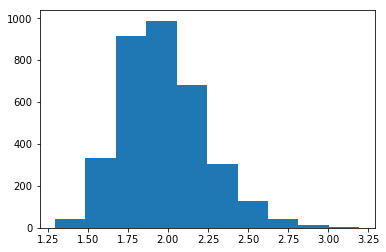

In [59]:
plt.hist(batch1[:,85-2])
plt.show()

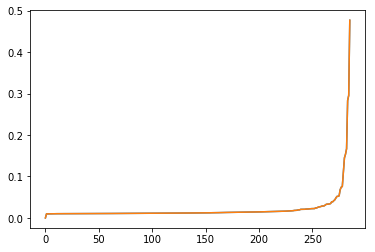

In [80]:
plt.plot(sort_val)
plt.show()

In [81]:
sort_val

array([ 0.        ,  0.00972536,  0.00979167,  0.00982395,  0.0098453 ,
        0.0098514 ,  0.00985826,  0.01007047,  0.01013483,  0.01014835,
        0.01015231,  0.01016939,  0.01017451,  0.01018646,  0.01020448,
        0.01020569,  0.01022652,  0.01023931,  0.01024616,  0.01025752,
        0.01025829,  0.01029518,  0.01030369,  0.01030443,  0.01031464,
        0.01035669,  0.01036372,  0.01036466,  0.01036667,  0.01037026,
        0.01037373,  0.01040098,  0.01040504,  0.01040943,  0.01041482,
        0.01042693,  0.01042779,  0.01045151,  0.01046596,  0.01046868,
        0.01046983,  0.01047331,  0.01048443,  0.01049456,  0.01049989,
        0.01050331,  0.01052583,  0.01052968,  0.01054104,  0.01054798,
        0.01055468,  0.01058133,  0.01059147,  0.01059784,  0.01060256,
        0.01060474,  0.01062007,  0.01062603,  0.01062631,  0.01064445,
        0.01066448,  0.01068685,  0.01069905,  0.01070856,  0.01072054,
        0.01072675,  0.01073503,  0.01075969,  0.01076429,  0.01

In [9]:
print(keras.__version__)

2.2.0
